# **IMPORTACIONES**

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim, peak_signal_noise_ratio as psnr

from pathlib import Path
from ipywidgets import interact
import os

from torchmetrics.image import MultiScaleStructuralSimilarityIndexMeasure
import torch
from torchvision.transforms.functional import to_tensor
from PIL import Image

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

from torch.utils.data import DataLoader, TensorDataset
from torchvision.transforms import ToTensor, Resize, Compose, Normalize, Lambda
from PIL import Image
from torchmetrics.image.fid import FrechetInceptionDistance

import lpips
from torchvision.transforms import ToTensor, Resize, Compose
import statistics

from matplotlib.patches import Rectangle
import cv2
from torchvision.transforms import functional as F

# **ALGUNAS VISUALIZACIONES**

### **Ejemplo por paciente**

In [24]:
# Ruta de paciente en especifico
ruta_real_B_per_paciente = "results/p2p_basic_NCCT2DWI/test_latest/images_grayscale/real_B/022" 
ruta_fake_B_per_paciente = "results/p2p_basic_NCCT2DWI/test_latest/images_grayscale/fake_B/022"

In [25]:
# Obtener la lista de archivos en las rutas
archivos_real_B = sorted(Path(ruta_real_B_per_paciente).glob("*.png"))
archivos_fake_B = sorted(Path(ruta_fake_B_per_paciente).glob("*.png"))

# Cargar las imágenes en listas
imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

#verificar dimensiones
for i, img in enumerate(imagenes_real_B):
    assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
for i, img in enumerate(imagenes_fake_B):
    assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"
    
#Agrupar volumen
volume_real_B = np.stack(imagenes_real_B, axis=-1)
volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

In [26]:
def browse_volume(volume, ssim_value=""):
    def view_image(i):
        plt.imshow(volume[:, :, i], cmap="gray")
        plt.title(ssim_value)
        plt.show()

    interact(view_image, i=(0, volume.shape[2] - 1))

In [27]:
ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())

print(f"Índice de similitud estructural (SSIM) entre real_B y fake_B: {ssim_value:.3f}")

browse_volume(volume_fake_B, ssim_value=f"SSIM: {ssim_value:.3f}")

Índice de similitud estructural (SSIM) entre real_B y fake_B: 0.876


interactive(children=(IntSlider(value=11, description='i', max=23), Output()), _dom_classes=('widget-interact'…

## **RUTAS PARA MÉTRICAS**

In [22]:
# Rutas de las carpetas de imagenes fake y reales
ruta_real_B = "results/p2p_basic_NCCT2DWI/test_latest/images_grayscale/real_B" 
ruta_fake_B = "results/p2p_basic_NCCT2DWI/test_latest/images_grayscale/fake_B"
ruta_masks = 'datasets/masks_test_organizado'

# **MÉTRICAS ESTANDAR**

## **SSIM**

In [29]:
# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    ssim_values.append(ssim_value)
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}")


promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")

SSIM Promedio: 0.853, Desviación Estándar SSIM: 0.0384


## **PSNR**

In [30]:
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

psnr_values = []

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    psnr_value = psnr(volume_real_B, volume_fake_B)
    psnr_values.append(psnr_value)
    #print(f"paciente: {id_paciente}, PSNR: {psnr_value:.3f}")


promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")

PSNR Promedio: 20.700, Desviación Estándar PSNR: 2.199


## **MS-SSIM**

In [31]:
# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

ms_ssim_values = []

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value)  # Agregar valor de MS-SSIM a la lista
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.3f}")


promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")

MS-SSIM Promedio: 0.849, Desviación Estándar MS-SSIM: 0.0584


# **MÉTRICAS PRE-ENTRENADAS**

## **FID**

In [32]:
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform):
    images = []
    for folder in path.iterdir():
        if folder.is_dir():  # Asegurarse de que es un directorio
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform)
fake_images = load_images(path_fake_images, transform)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


FID Score: 0.06982599943876266


## **LPIPS**

In [33]:
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch


# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = Path(ruta_real_B)
fake_images_dir = Path(ruta_fake_B)

# Obtener la lista de nombres de directorios de imágenes (IDs de pacientes)
real_patient_dirs = os.listdir(real_images_dir)
fake_patient_dirs = os.listdir(fake_images_dir)

distances = []

for patient_dir in real_patient_dirs:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Average LPIPS Distance:', "{:.3f}".format(average_distance))
    print('Standard Deviation of LPIPS Distance:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Average LPIPS Distance: 0.199
Standard Deviation of LPIPS Distance: 0.061


# **MÉTRICAS ENTRE LAS LESIONES**

### **Todos los que tienen lesiones**

## **SSIM, PSNR y MS-SSIM**

Real_B ID: 000, Fake_B ID: 000, Masks ID: 000
Paciente: 000, Slice 9 - SSIM: 0.724, PSNR: 15.750, MS-SSIM: 0.785


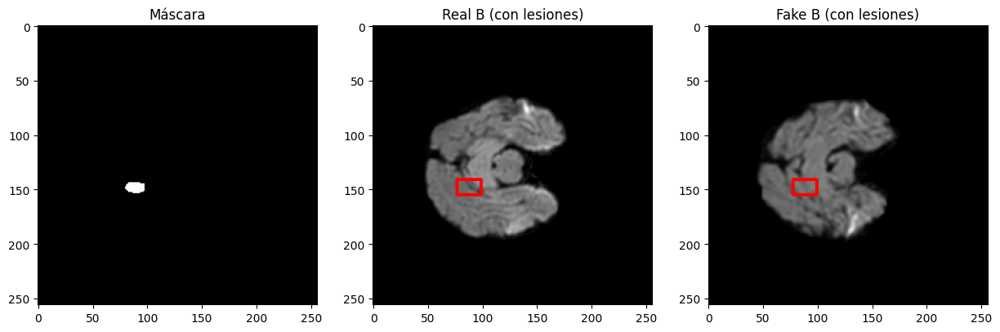

Promedio SSIM del paciente 000: 0.724
Promedio PSNR del paciente 000: 15.750
Promedio MS-SSIM del paciente 000: 0.785
Real_B ID: 001, Fake_B ID: 001, Masks ID: 001
Real_B ID: 002, Fake_B ID: 002, Masks ID: 002
Paciente: 002, Slice 3 - SSIM: 0.540, PSNR: 14.019, MS-SSIM: 0.477


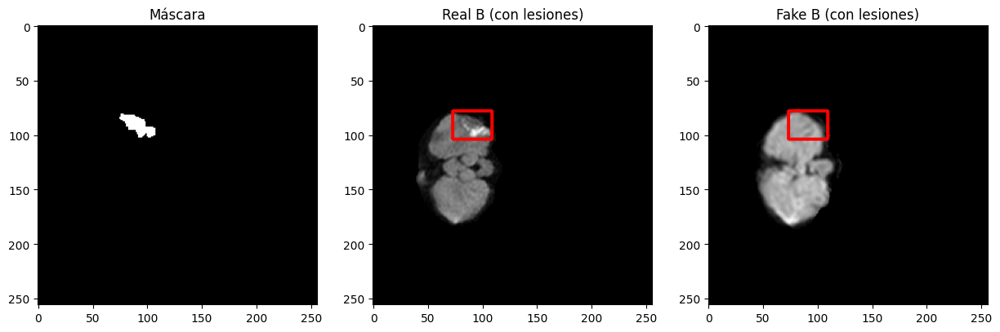

Paciente: 002, Slice 4 - SSIM: 0.545, PSNR: 12.216, MS-SSIM: 0.469


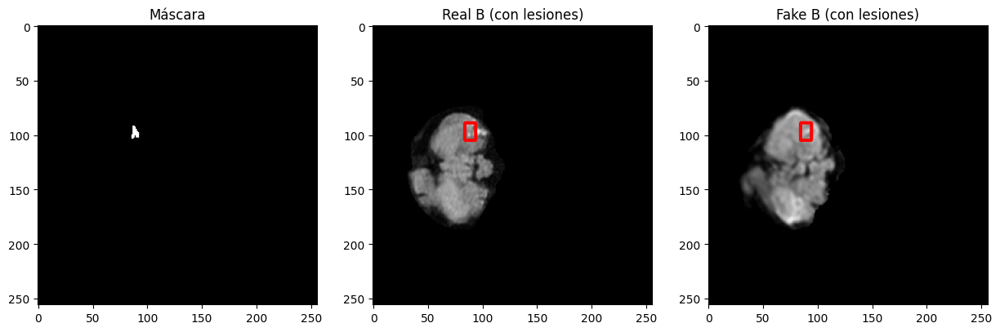

Paciente: 002, Slice 5 - SSIM: 0.437, PSNR: 12.619, MS-SSIM: 0.207


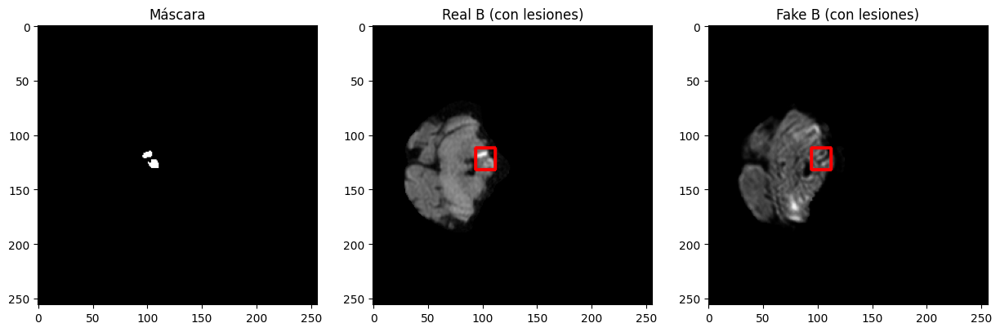

Promedio SSIM del paciente 002: 0.507
Promedio PSNR del paciente 002: 12.951
Promedio MS-SSIM del paciente 002: 0.384
Real_B ID: 003, Fake_B ID: 003, Masks ID: 003
Paciente: 003, Slice 11 - SSIM: 0.669, PSNR: 12.660, MS-SSIM: 0.503


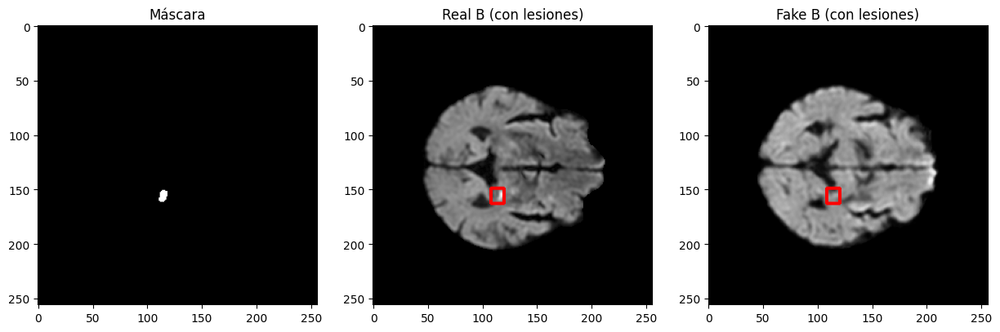

Paciente: 003, Slice 12 - SSIM: 0.663, PSNR: 11.608, MS-SSIM: 0.517


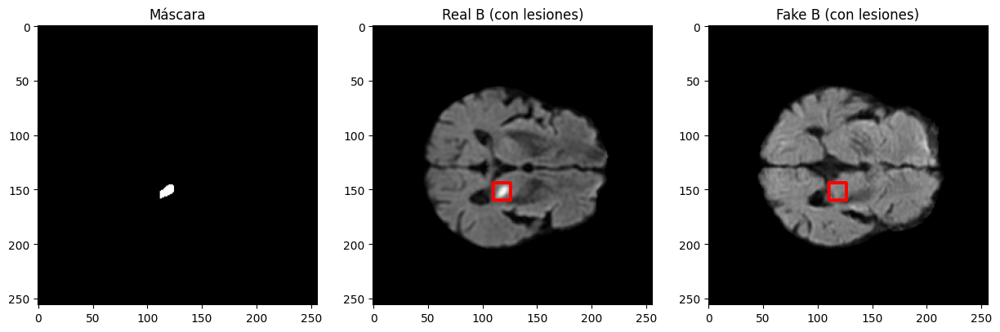

Paciente: 003, Slice 13 - SSIM: 0.579, PSNR: 10.205, MS-SSIM: 0.288


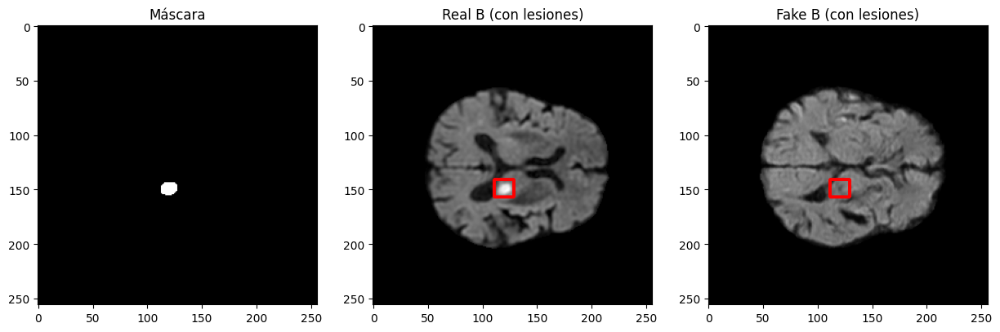

Paciente: 003, Slice 14 - SSIM: 0.685, PSNR: 9.028, MS-SSIM: 0.465


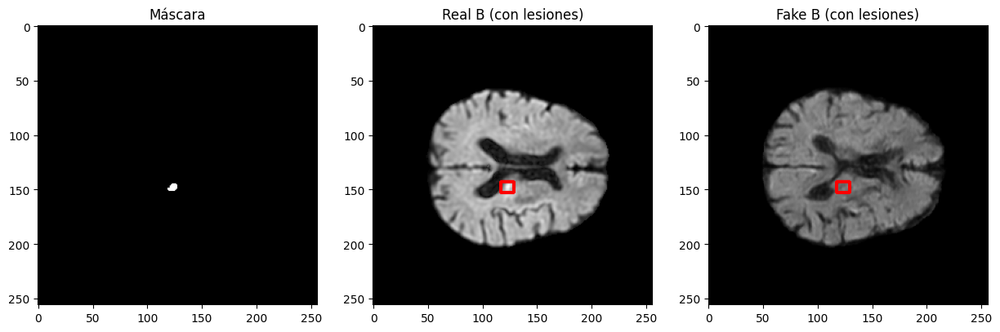

Promedio SSIM del paciente 003: 0.649
Promedio PSNR del paciente 003: 10.875
Promedio MS-SSIM del paciente 003: 0.443
Real_B ID: 004, Fake_B ID: 004, Masks ID: 004
Real_B ID: 005, Fake_B ID: 005, Masks ID: 005
Paciente: 005, Slice 11 - SSIM: 0.347, PSNR: 12.144, MS-SSIM: 0.246


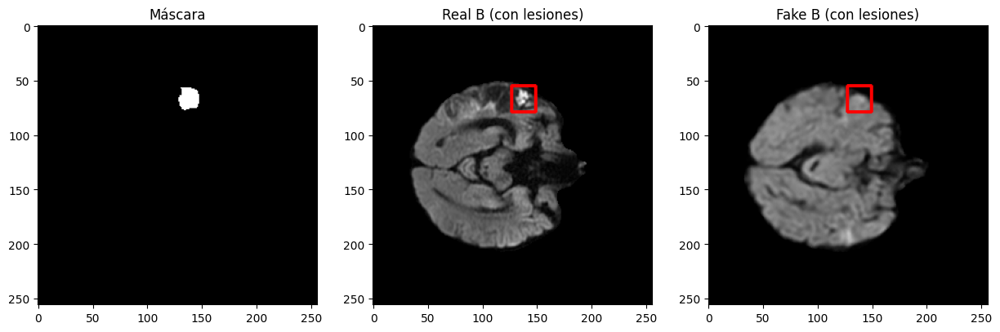

Paciente: 005, Slice 12 - SSIM: 0.251, PSNR: 11.946, MS-SSIM: 0.261


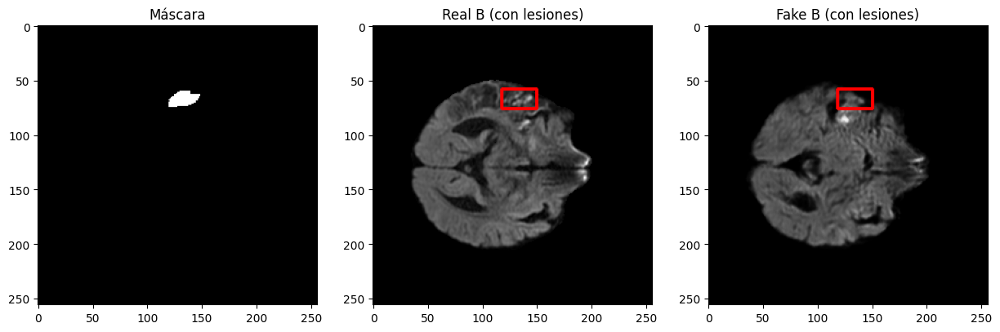

Paciente: 005, Slice 13 - SSIM: 0.329, PSNR: 10.838, MS-SSIM: 0.213


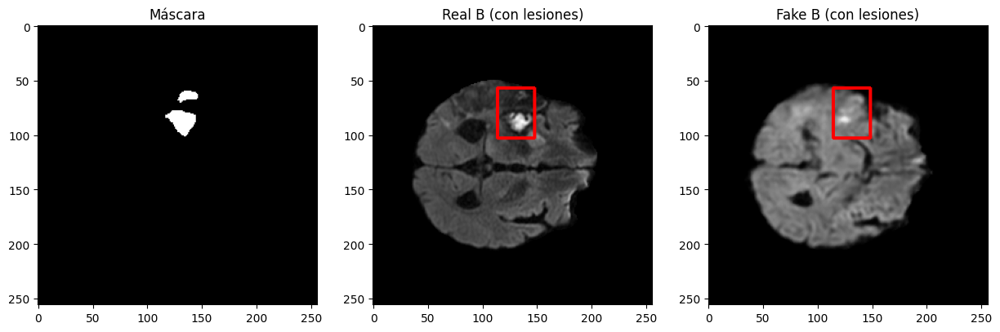

Paciente: 005, Slice 14 - SSIM: 0.321, PSNR: 10.962, MS-SSIM: 0.281


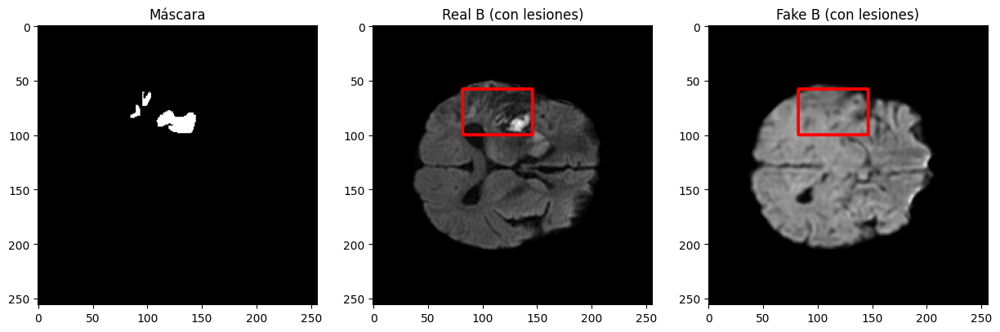

Paciente: 005, Slice 15 - SSIM: 0.308, PSNR: 13.845, MS-SSIM: 0.254


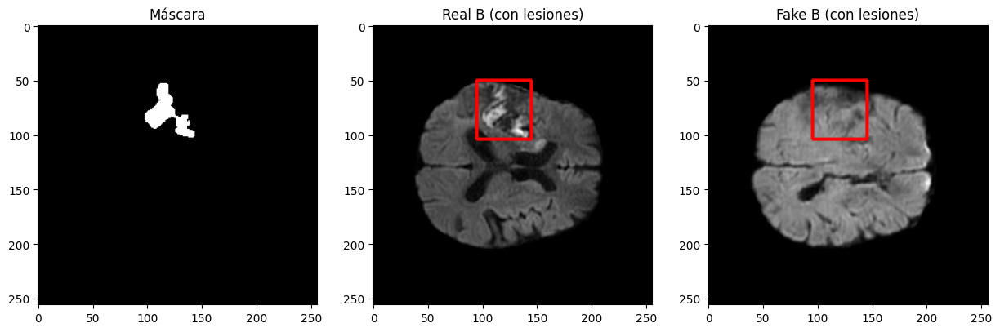

Paciente: 005, Slice 16 - SSIM: 0.372, PSNR: 13.667, MS-SSIM: 0.255


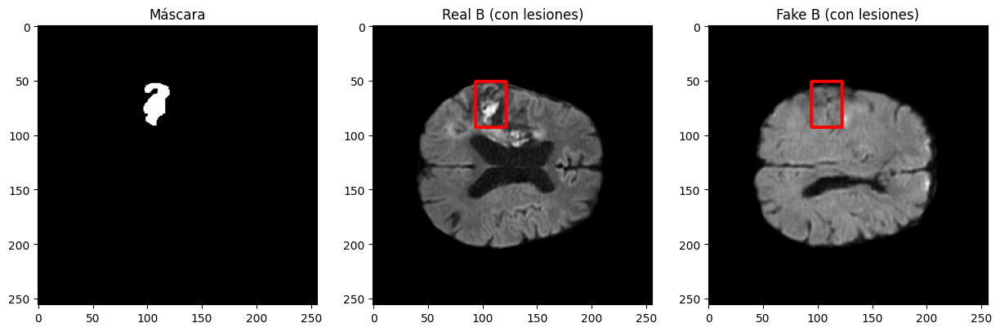

Paciente: 005, Slice 17 - SSIM: 0.388, PSNR: 12.044, MS-SSIM: 0.261


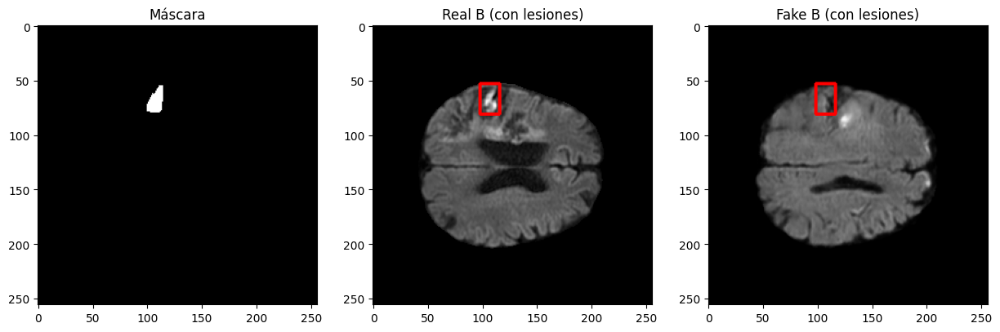

Paciente: 005, Slice 18 - SSIM: 0.477, PSNR: 15.718, MS-SSIM: 0.347


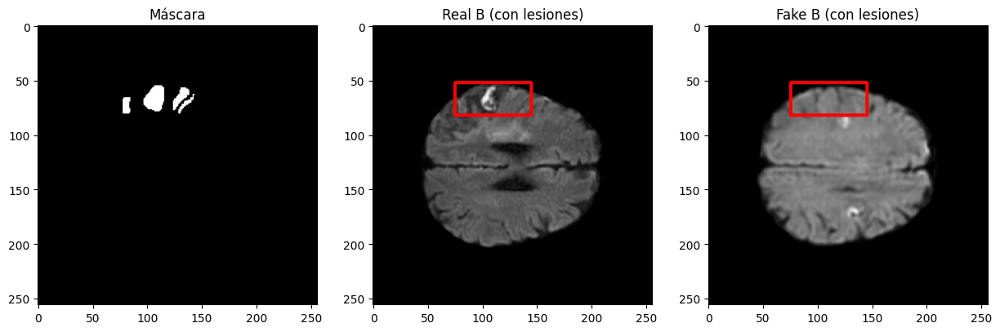

Paciente: 005, Slice 19 - SSIM: 0.475, PSNR: 12.781, MS-SSIM: 0.366


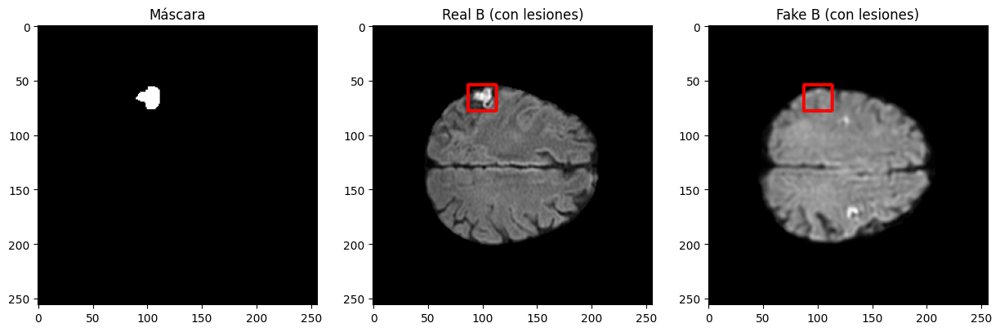

Paciente: 005, Slice 20 - SSIM: 0.516, PSNR: 14.866, MS-SSIM: 0.448


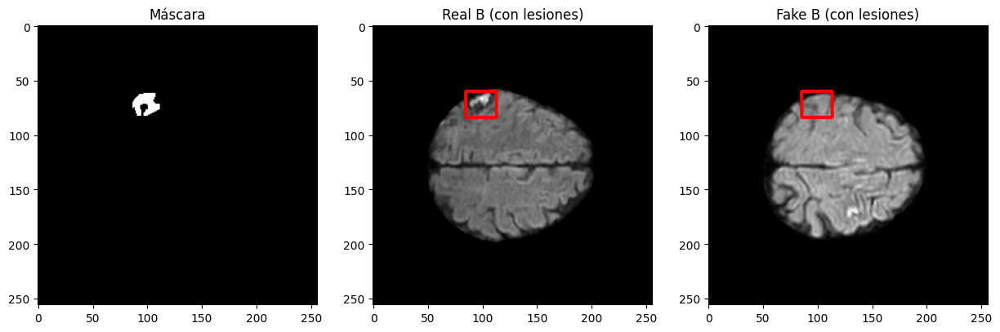

Promedio SSIM del paciente 005: 0.378
Promedio PSNR del paciente 005: 12.881
Promedio MS-SSIM del paciente 005: 0.293
Real_B ID: 006, Fake_B ID: 006, Masks ID: 006
Paciente: 006, Slice 14 - SSIM: 0.587, PSNR: 14.585, MS-SSIM: 0.358


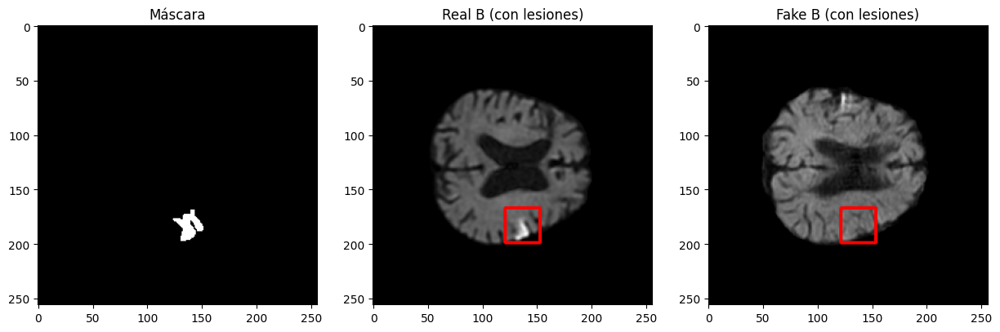

Paciente: 006, Slice 15 - SSIM: 0.618, PSNR: 15.166, MS-SSIM: 0.485


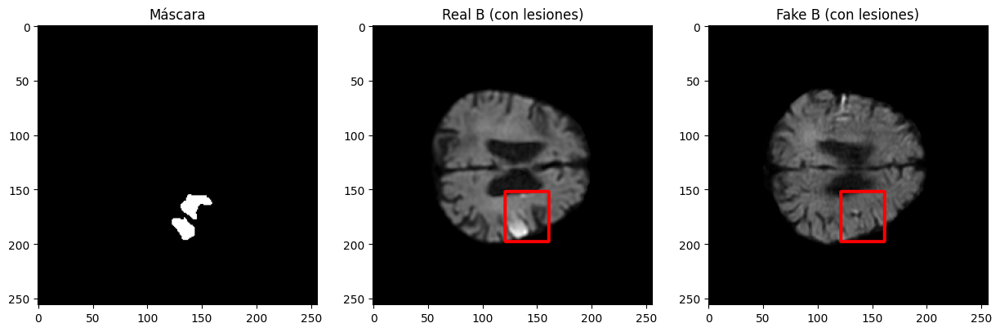

Paciente: 006, Slice 16 - SSIM: 0.505, PSNR: 12.831, MS-SSIM: 0.301


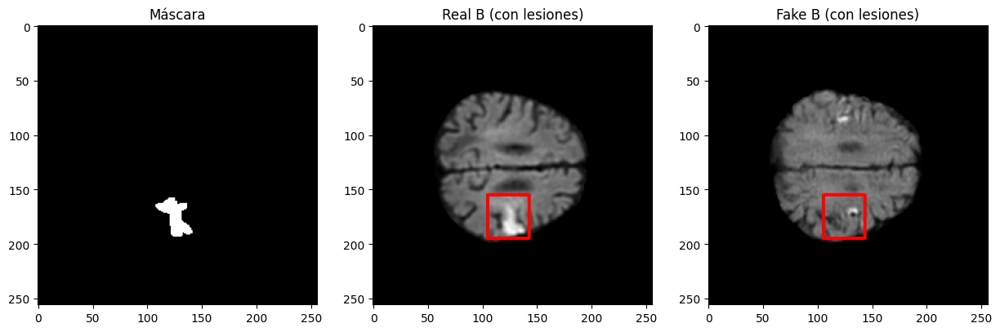

Paciente: 006, Slice 17 - SSIM: 0.457, PSNR: 10.653, MS-SSIM: 0.324


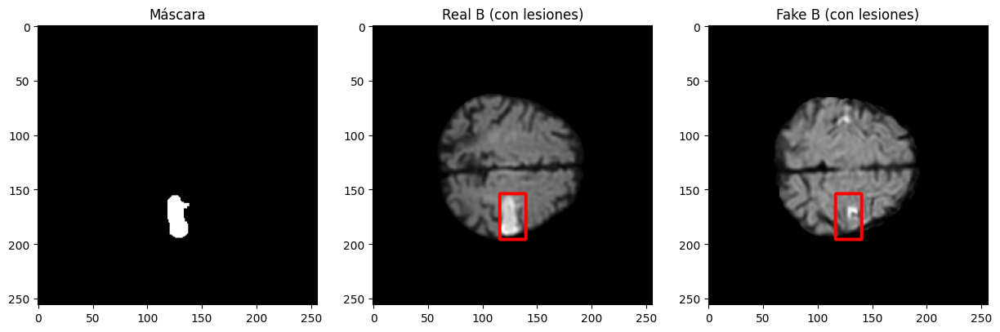

Paciente: 006, Slice 18 - SSIM: 0.410, PSNR: 11.490, MS-SSIM: 0.288


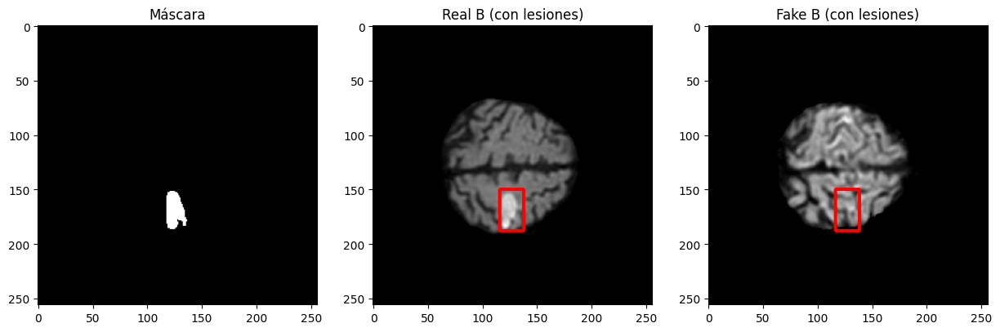

Paciente: 006, Slice 19 - SSIM: 0.293, PSNR: 9.847, MS-SSIM: 0.245


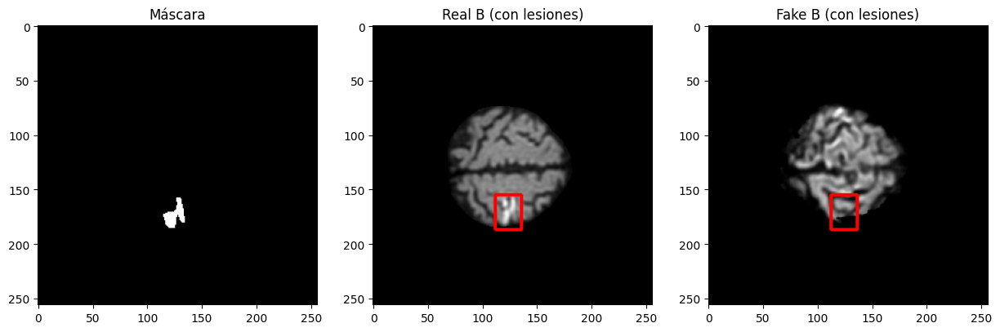

Promedio SSIM del paciente 006: 0.478
Promedio PSNR del paciente 006: 12.429
Promedio MS-SSIM del paciente 006: 0.333
Real_B ID: 007, Fake_B ID: 007, Masks ID: 007
Paciente: 007, Slice 19 - SSIM: 0.571, PSNR: 6.884, MS-SSIM: 0.407


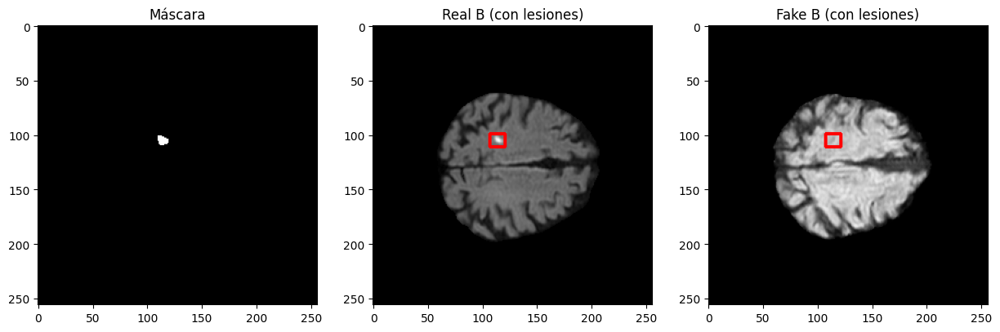

Paciente: 007, Slice 20 - SSIM: 0.684, PSNR: 13.472, MS-SSIM: 0.566


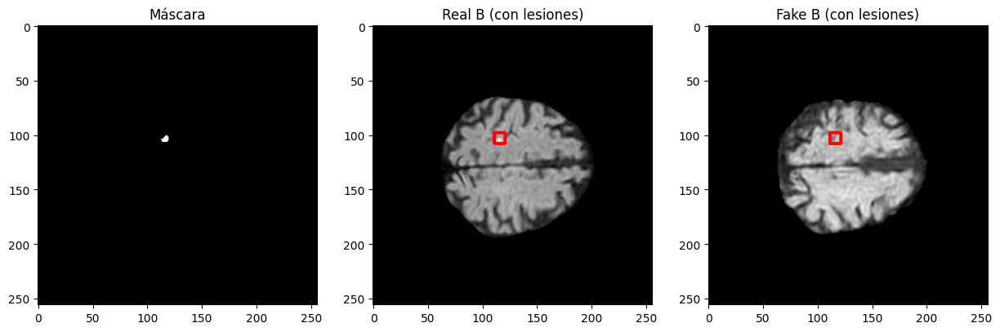

Promedio SSIM del paciente 007: 0.627
Promedio PSNR del paciente 007: 10.178
Promedio MS-SSIM del paciente 007: 0.486
Real_B ID: 008, Fake_B ID: 008, Masks ID: 008
Paciente: 008, Slice 12 - SSIM: 0.690, PSNR: 8.545, MS-SSIM: 0.777


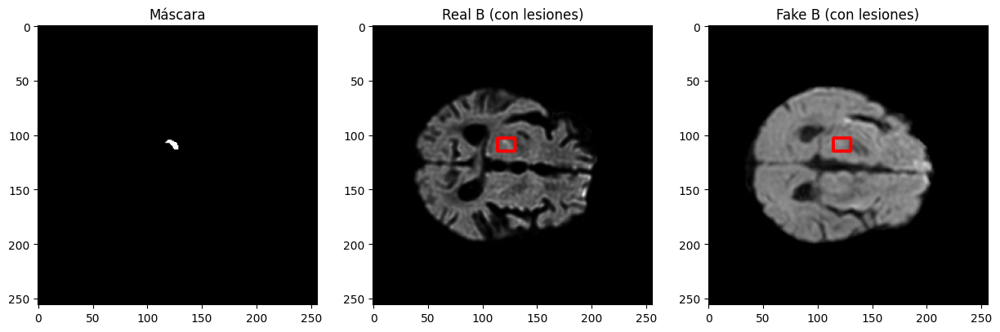

Promedio SSIM del paciente 008: 0.690
Promedio PSNR del paciente 008: 8.545
Promedio MS-SSIM del paciente 008: 0.777
Real_B ID: 009, Fake_B ID: 009, Masks ID: 009
Paciente: 009, Slice 10 - SSIM: 0.663, PSNR: 8.574, MS-SSIM: 0.721


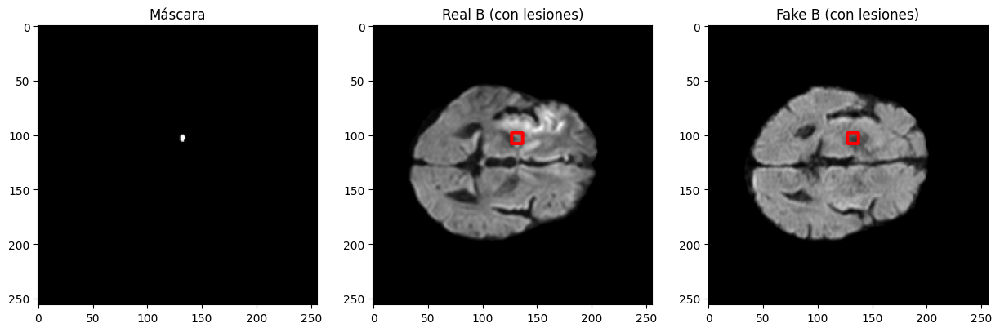

Paciente: 009, Slice 12 - SSIM: 0.641, PSNR: 13.257, MS-SSIM: 0.506


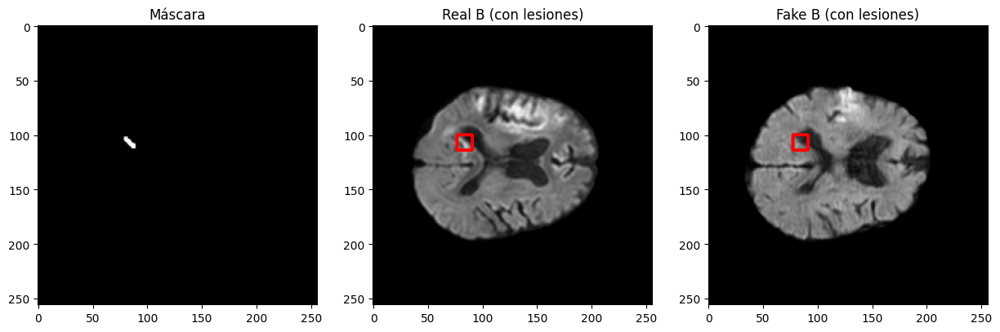

Paciente: 009, Slice 17 - SSIM: 0.381, PSNR: -3.830, MS-SSIM: 0.733


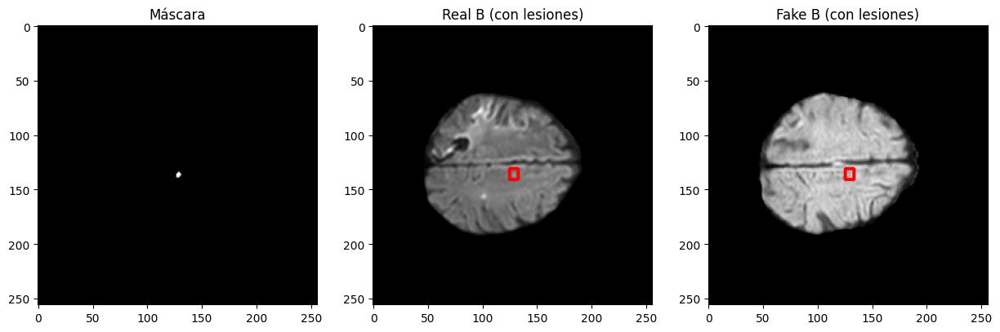

Paciente: 009, Slice 18 - SSIM: 0.429, PSNR: 8.637, MS-SSIM: 0.369


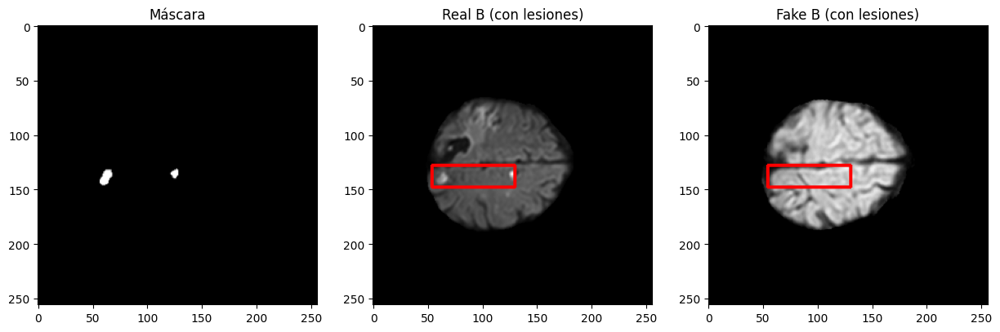

Paciente: 009, Slice 19 - SSIM: 0.552, PSNR: 11.795, MS-SSIM: 0.426


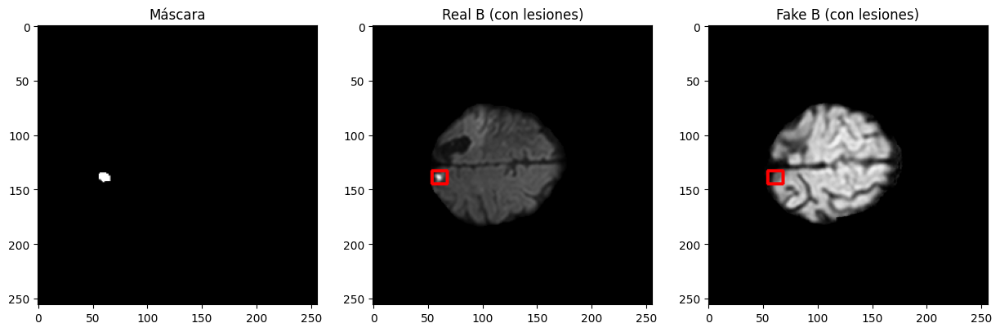

Promedio SSIM del paciente 009: 0.533
Promedio PSNR del paciente 009: 7.687
Promedio MS-SSIM del paciente 009: 0.551
Real_B ID: 010, Fake_B ID: 010, Masks ID: 010
Paciente: 010, Slice 10 - SSIM: nan, PSNR: nan, MS-SSIM: 1.000


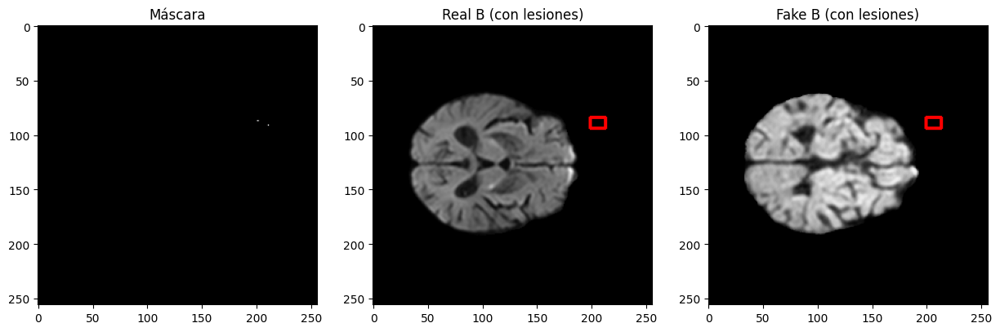

Paciente: 010, Slice 11 - SSIM: 0.825, PSNR: 12.867, MS-SSIM: 0.814


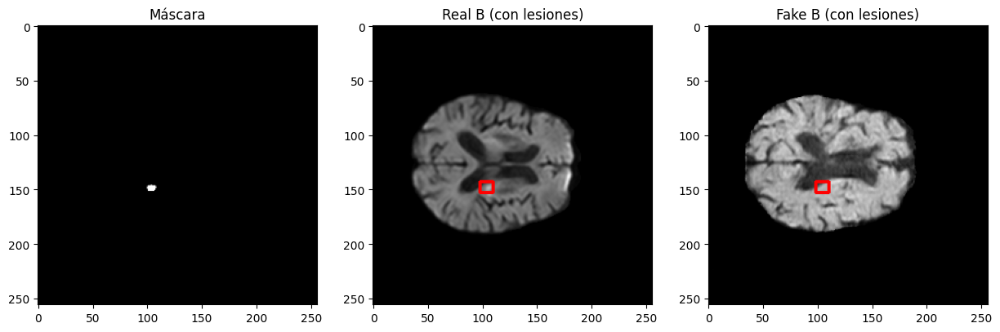

Paciente: 010, Slice 12 - SSIM: 0.699, PSNR: 14.106, MS-SSIM: 0.585


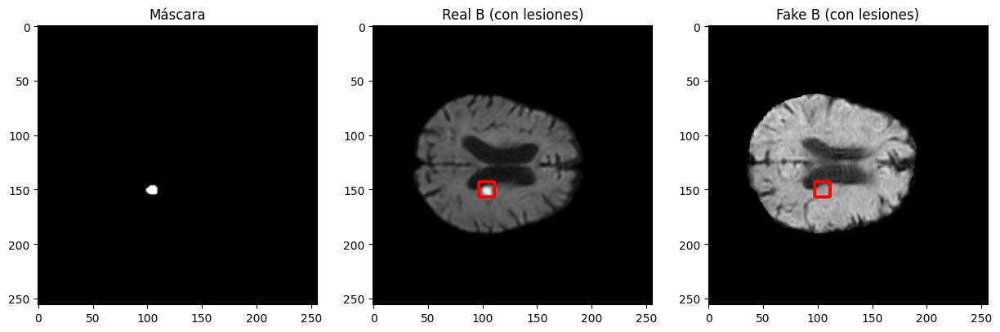

Paciente: 010, Slice 13 - SSIM: 0.735, PSNR: 11.923, MS-SSIM: 0.592


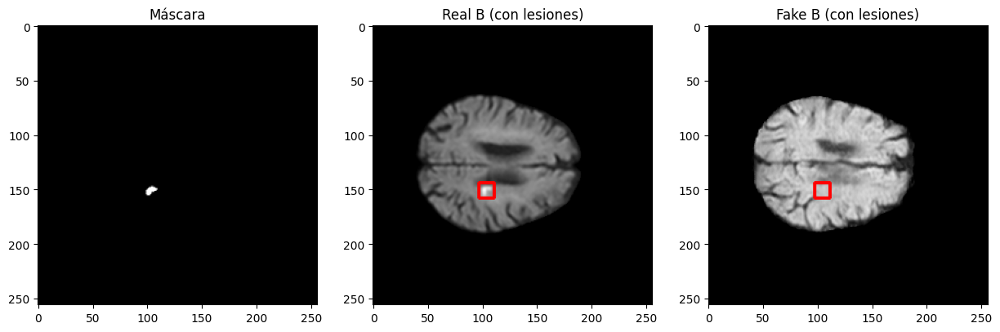

Promedio SSIM del paciente 010: 0.753
Promedio PSNR del paciente 010: 12.965
Promedio MS-SSIM del paciente 010: 0.748
Real_B ID: 011, Fake_B ID: 011, Masks ID: 011
Paciente: 011, Slice 11 - SSIM: 0.793, PSNR: 12.646, MS-SSIM: 0.813


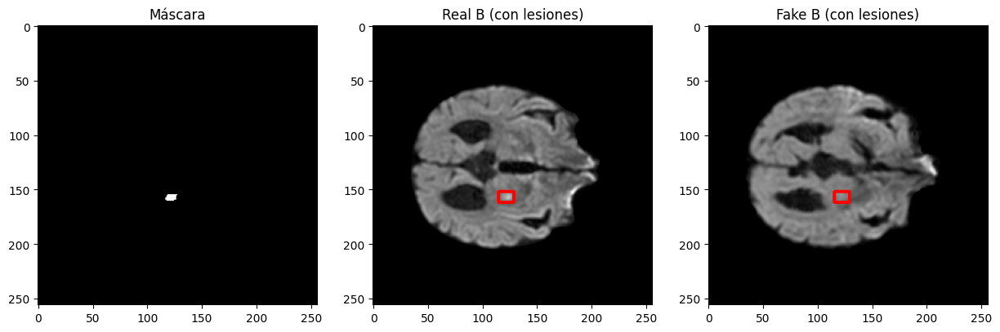

Paciente: 011, Slice 12 - SSIM: 0.725, PSNR: 15.105, MS-SSIM: 0.631


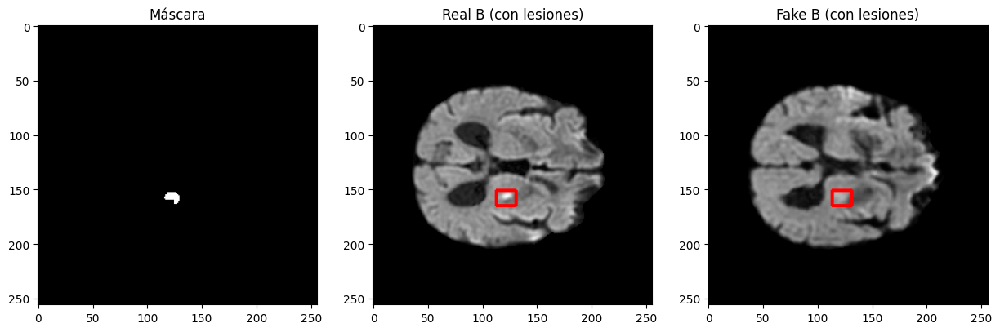

Paciente: 011, Slice 13 - SSIM: 0.646, PSNR: 4.129, MS-SSIM: 0.760


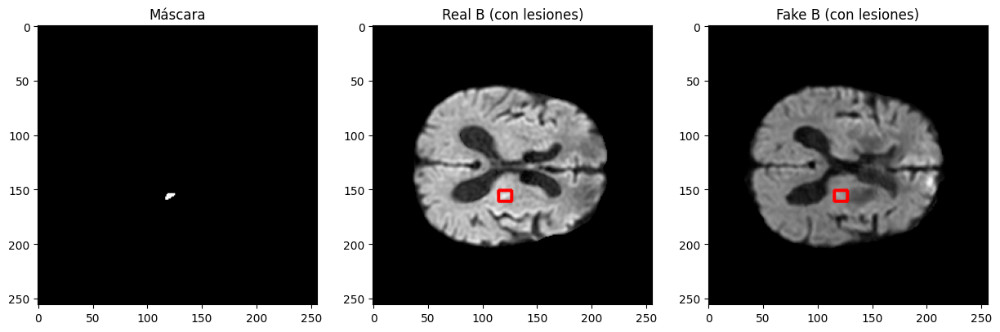

Promedio SSIM del paciente 011: 0.721
Promedio PSNR del paciente 011: 10.627
Promedio MS-SSIM del paciente 011: 0.735
Real_B ID: 012, Fake_B ID: 012, Masks ID: 012
Paciente: 012, Slice 17 - SSIM: 0.611, PSNR: 12.976, MS-SSIM: 0.661


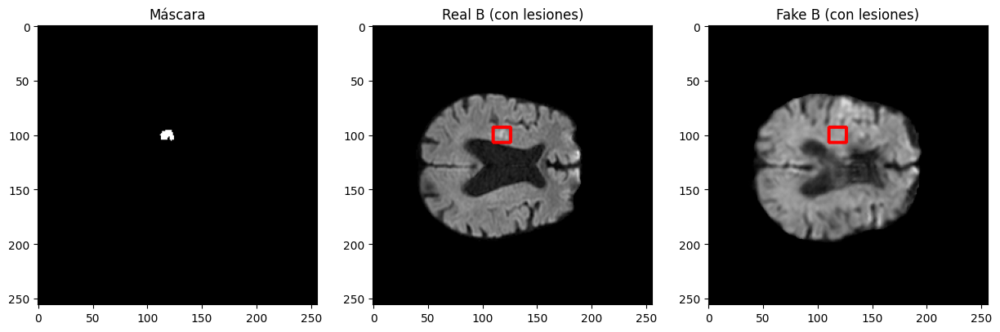

Promedio SSIM del paciente 012: 0.611
Promedio PSNR del paciente 012: 12.976
Promedio MS-SSIM del paciente 012: 0.661
Real_B ID: 013, Fake_B ID: 013, Masks ID: 013
Paciente: 013, Slice 15 - SSIM: 0.530, PSNR: 11.167, MS-SSIM: 0.361


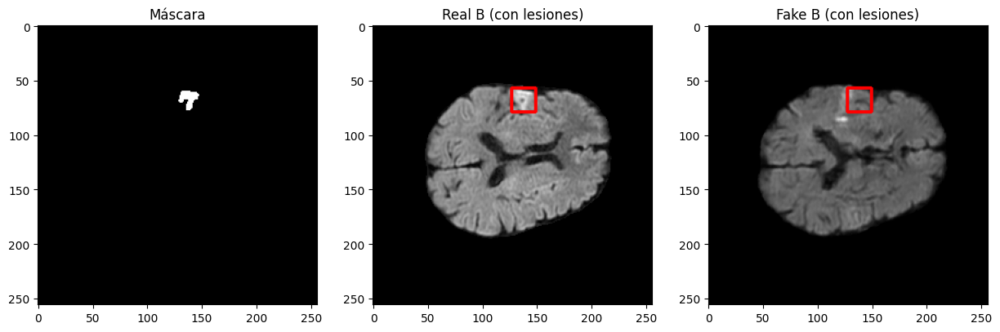

Paciente: 013, Slice 16 - SSIM: 0.628, PSNR: 11.453, MS-SSIM: 0.464


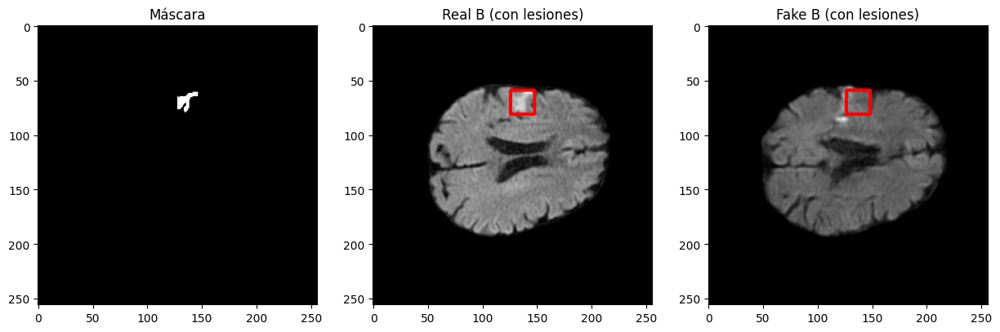

Paciente: 013, Slice 17 - SSIM: 0.562, PSNR: 10.809, MS-SSIM: 0.398


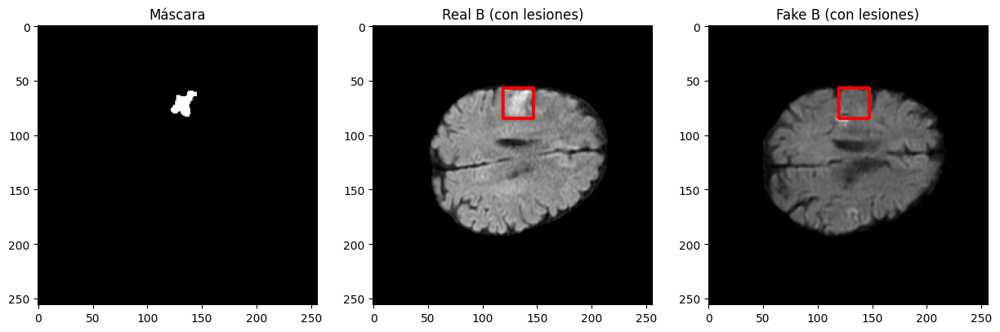

Paciente: 013, Slice 18 - SSIM: 0.474, PSNR: 4.704, MS-SSIM: 0.520


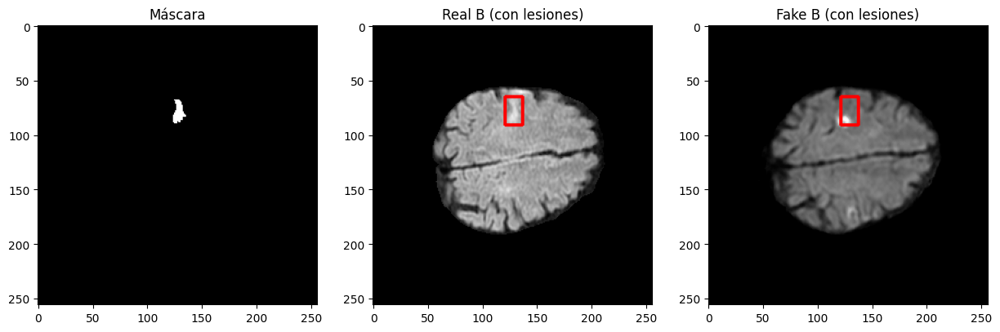

Promedio SSIM del paciente 013: 0.549
Promedio PSNR del paciente 013: 9.533
Promedio MS-SSIM del paciente 013: 0.436
Real_B ID: 014, Fake_B ID: 014, Masks ID: 014
Paciente: 014, Slice 10 - SSIM: 0.565, PSNR: 7.199, MS-SSIM: 0.747


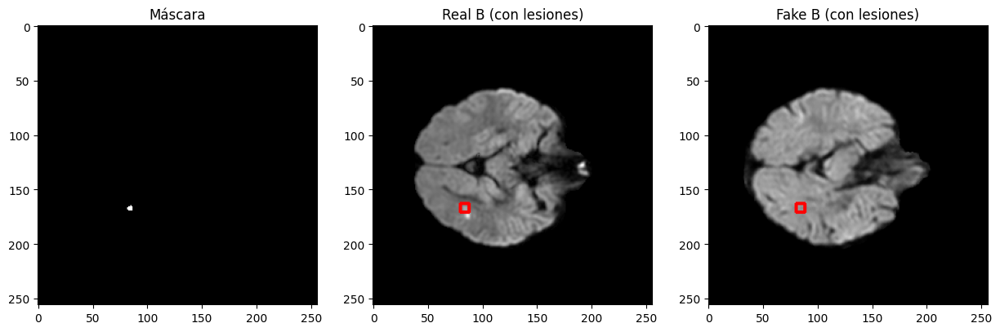

Promedio SSIM del paciente 014: 0.565
Promedio PSNR del paciente 014: 7.199
Promedio MS-SSIM del paciente 014: 0.747
Real_B ID: 015, Fake_B ID: 015, Masks ID: 015
Paciente: 015, Slice 14 - SSIM: 0.657, PSNR: 13.177, MS-SSIM: 0.542


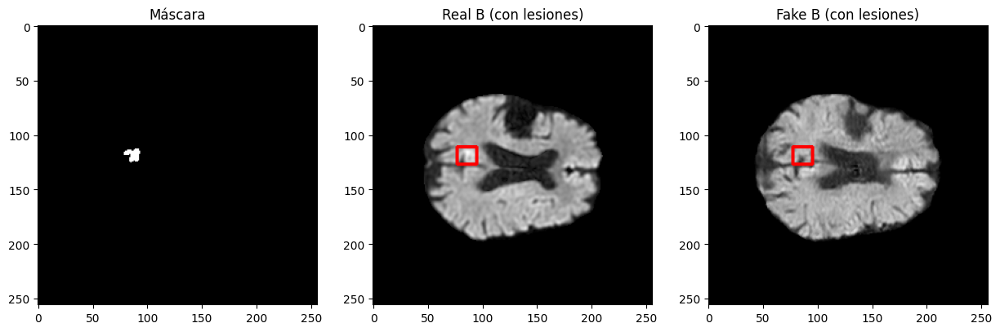

Paciente: 015, Slice 15 - SSIM: 0.579, PSNR: 13.136, MS-SSIM: 0.365


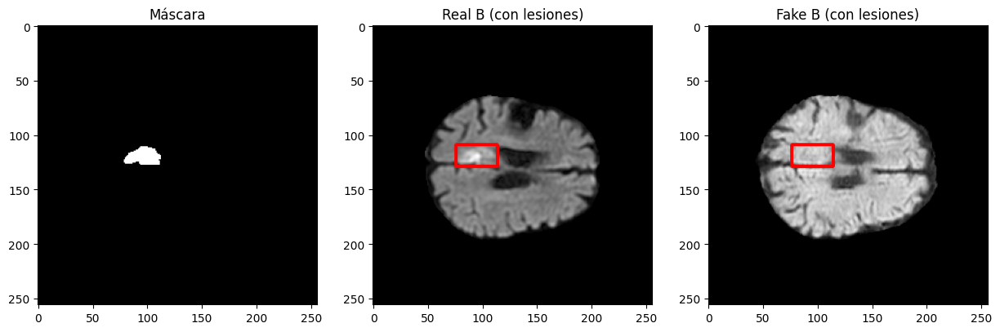

Paciente: 015, Slice 16 - SSIM: 0.412, PSNR: 12.310, MS-SSIM: 0.298


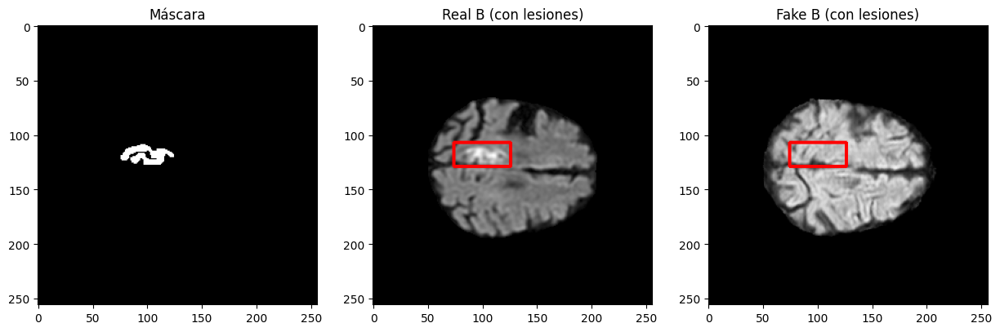

Paciente: 015, Slice 17 - SSIM: 0.553, PSNR: 14.477, MS-SSIM: 0.408


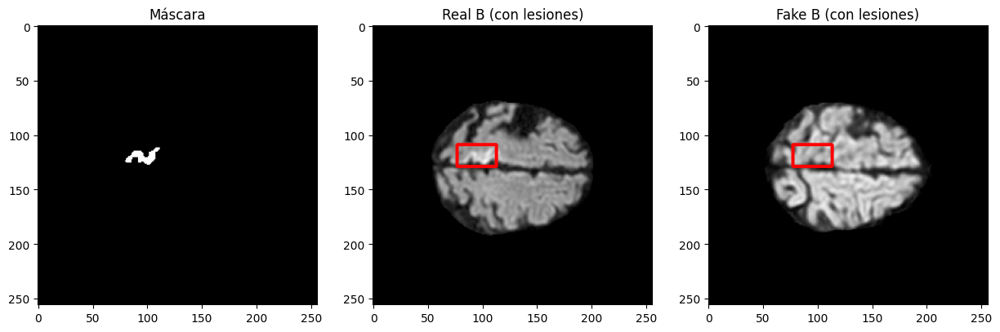

Paciente: 015, Slice 18 - SSIM: 0.547, PSNR: 12.499, MS-SSIM: 0.271


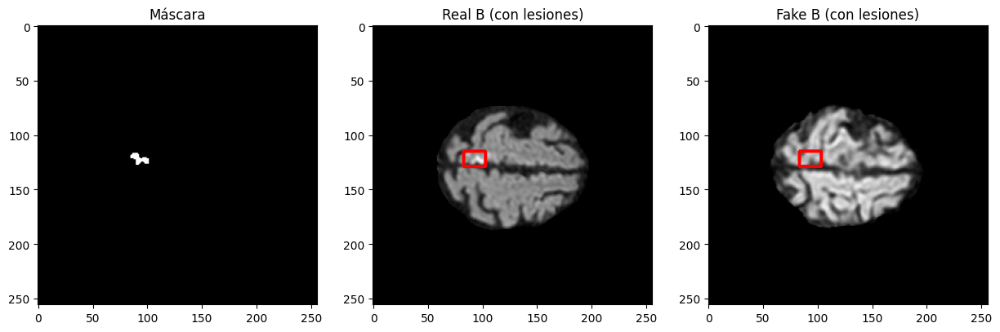

Paciente: 015, Slice 19 - SSIM: 0.478, PSNR: 11.874, MS-SSIM: 0.385


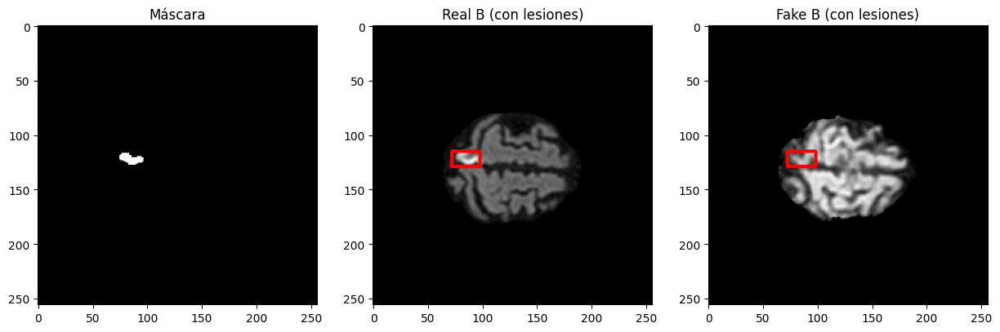

Paciente: 015, Slice 20 - SSIM: 0.284, PSNR: 6.738, MS-SSIM: 0.000


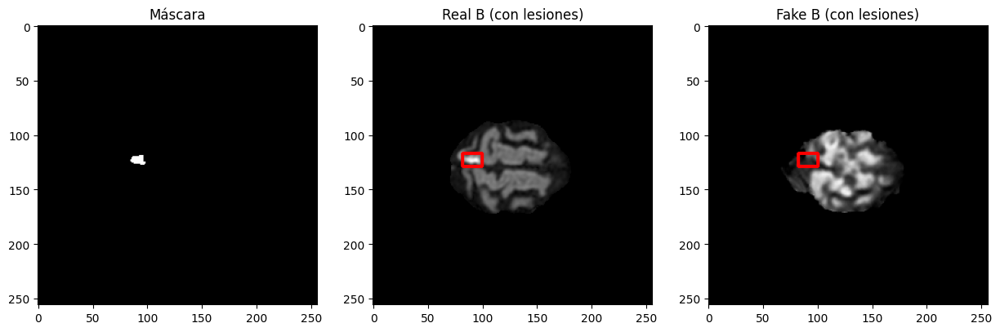

Paciente: 015, Slice 21 - SSIM: 0.062, PSNR: 4.935, MS-SSIM: 0.042


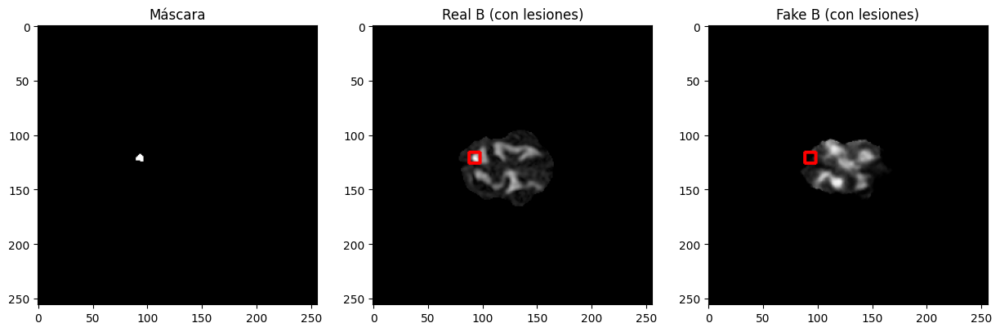

Promedio SSIM del paciente 015: 0.447
Promedio PSNR del paciente 015: 11.143
Promedio MS-SSIM del paciente 015: 0.289
Real_B ID: 016, Fake_B ID: 016, Masks ID: 016
Paciente: 016, Slice 13 - SSIM: 0.422, PSNR: 7.433, MS-SSIM: 0.628


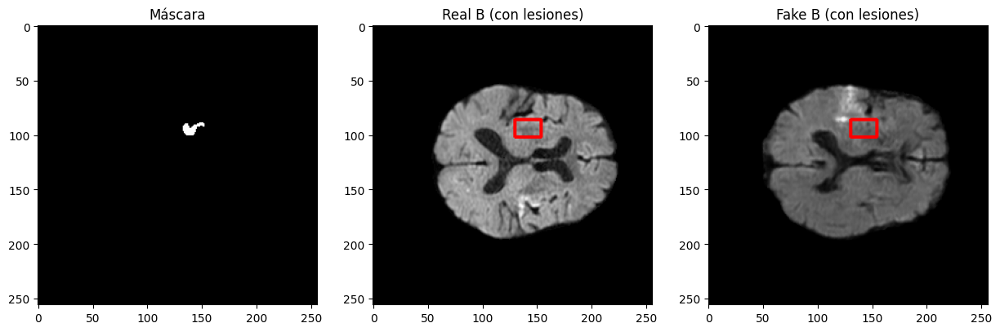

Paciente: 016, Slice 14 - SSIM: 0.418, PSNR: 6.939, MS-SSIM: 0.476


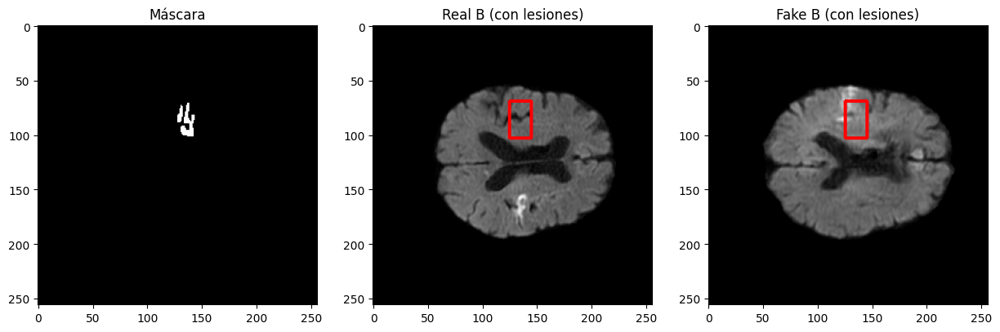

Paciente: 016, Slice 15 - SSIM: 0.692, PSNR: 18.631, MS-SSIM: 0.639


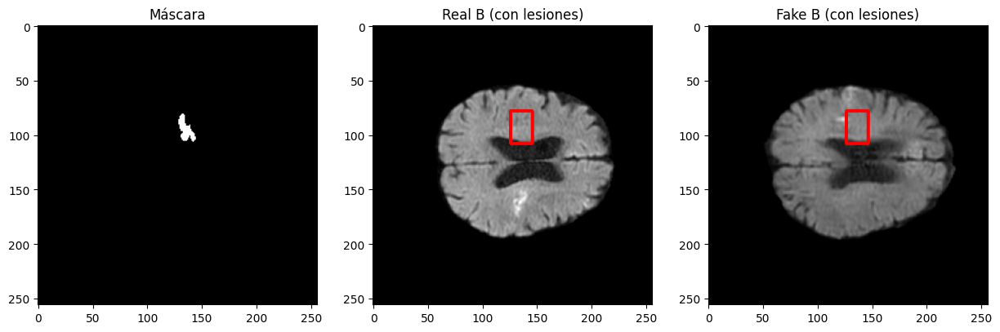

Paciente: 016, Slice 16 - SSIM: 0.692, PSNR: 16.939, MS-SSIM: 0.652


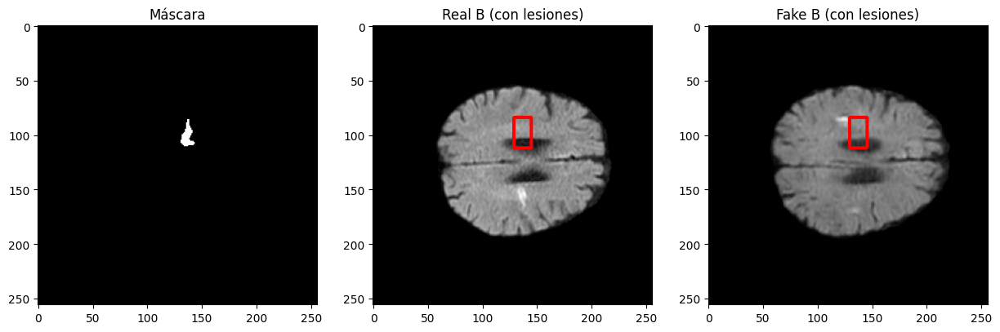

Promedio SSIM del paciente 016: 0.556
Promedio PSNR del paciente 016: 12.485
Promedio MS-SSIM del paciente 016: 0.599
Real_B ID: 017, Fake_B ID: 017, Masks ID: 017
Paciente: 017, Slice 6 - SSIM: 0.058, PSNR: 5.923, MS-SSIM: 0.000


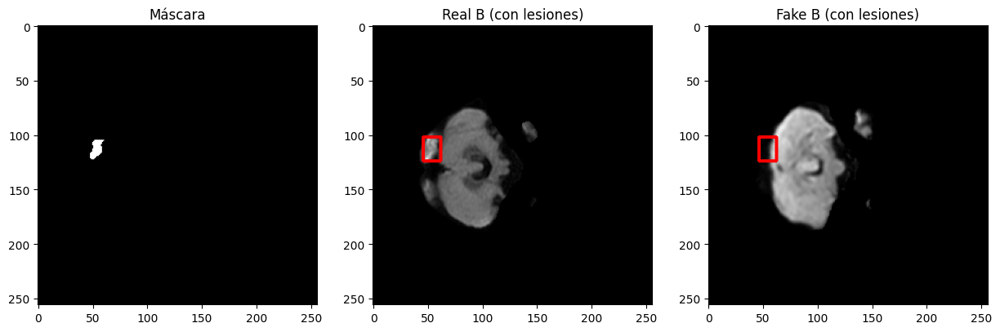

Paciente: 017, Slice 7 - SSIM: 0.408, PSNR: 9.622, MS-SSIM: 0.248


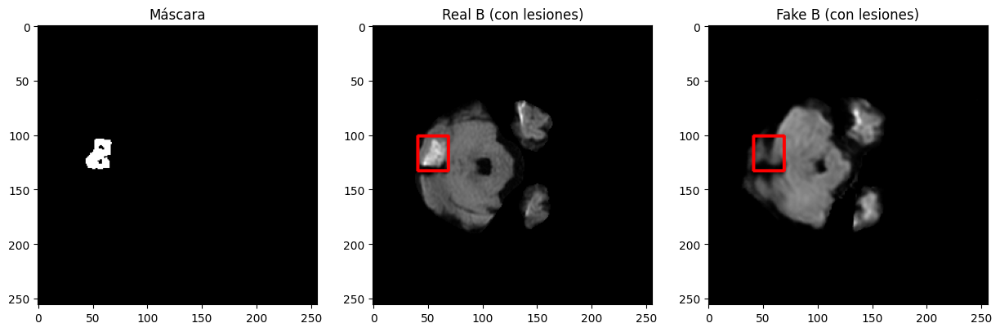

Paciente: 017, Slice 8 - SSIM: 0.504, PSNR: 11.557, MS-SSIM: 0.442


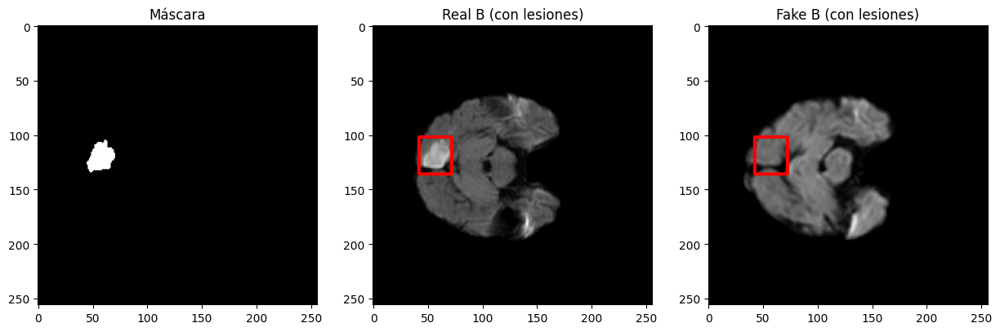

Paciente: 017, Slice 9 - SSIM: 0.498, PSNR: 11.593, MS-SSIM: 0.362


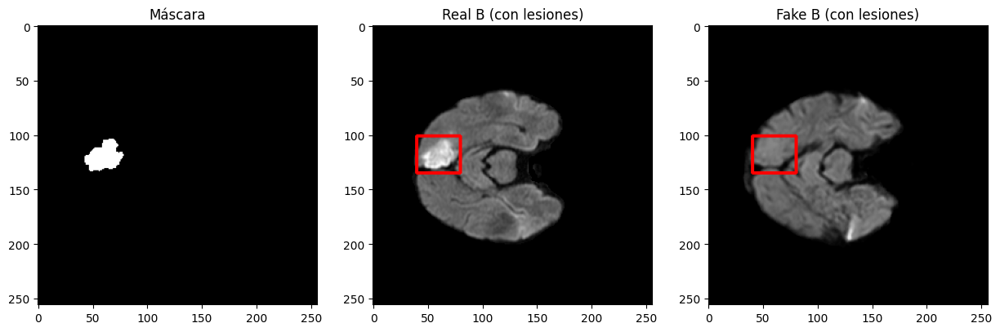

Paciente: 017, Slice 10 - SSIM: 0.498, PSNR: 13.084, MS-SSIM: 0.388


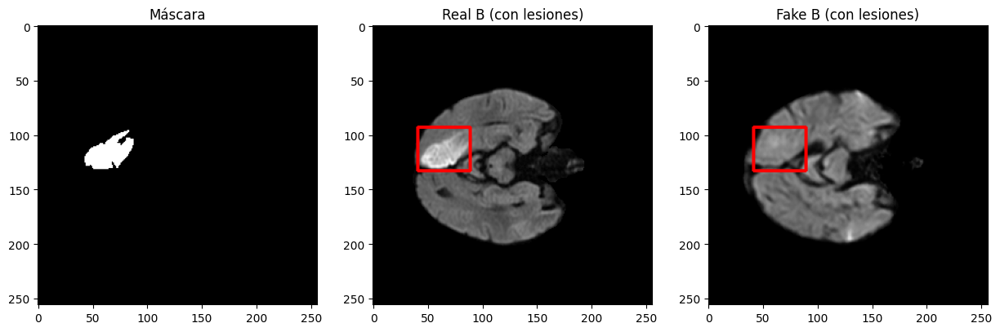

Paciente: 017, Slice 11 - SSIM: 0.397, PSNR: 13.542, MS-SSIM: 0.330


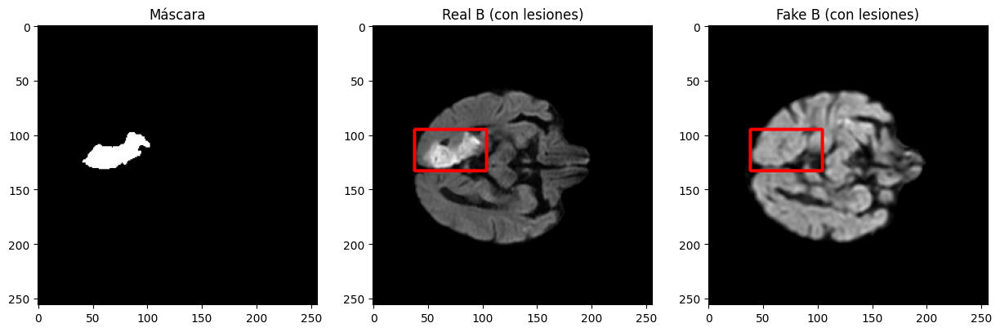

Paciente: 017, Slice 12 - SSIM: 0.519, PSNR: 12.785, MS-SSIM: 0.370


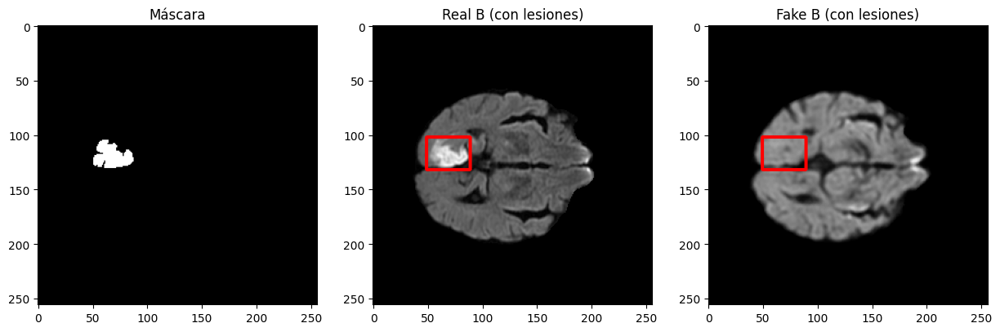

Paciente: 017, Slice 13 - SSIM: 0.589, PSNR: 15.156, MS-SSIM: 0.414


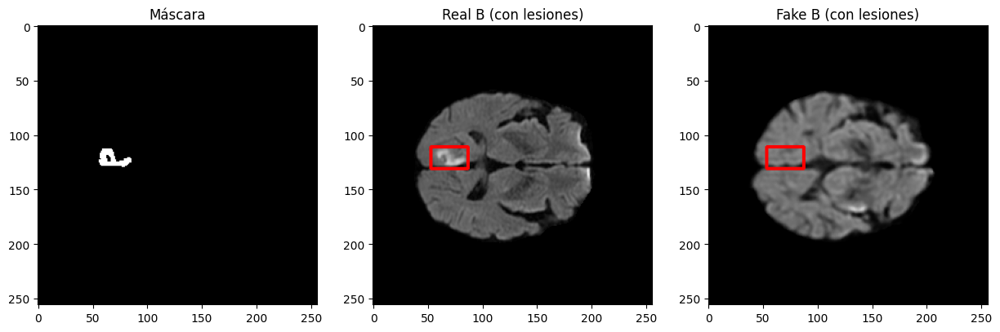

Promedio SSIM del paciente 017: 0.434
Promedio PSNR del paciente 017: 11.658
Promedio MS-SSIM del paciente 017: 0.319
Real_B ID: 018, Fake_B ID: 018, Masks ID: 018
Paciente: 018, Slice 14 - SSIM: 0.630, PSNR: 11.690, MS-SSIM: 0.527


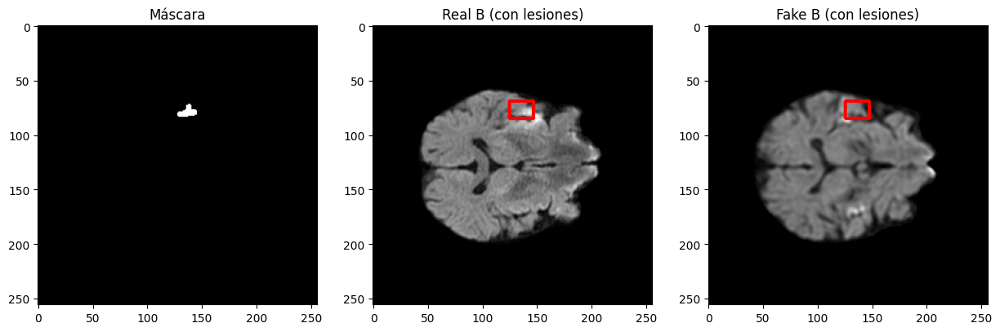

Paciente: 018, Slice 15 - SSIM: 0.382, PSNR: 11.933, MS-SSIM: 0.209


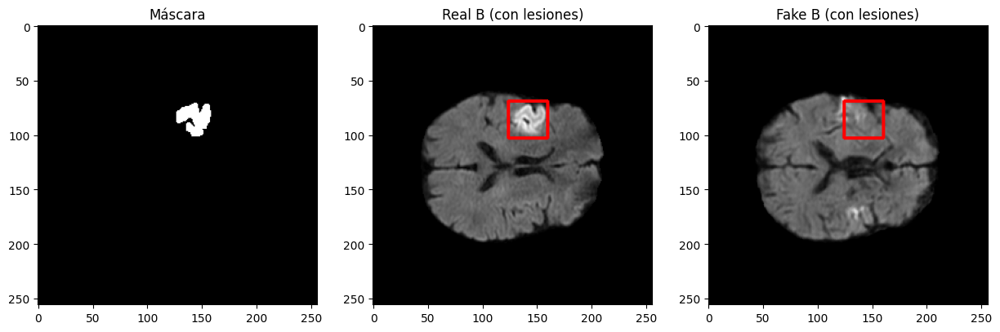

Paciente: 018, Slice 16 - SSIM: 0.452, PSNR: 12.362, MS-SSIM: 0.279


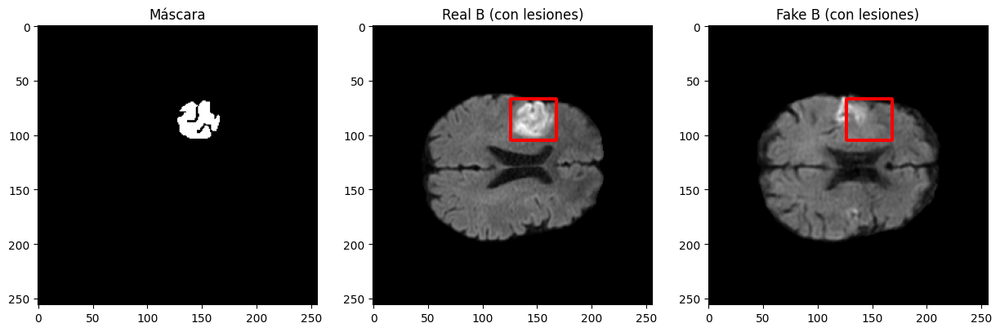

Paciente: 018, Slice 17 - SSIM: 0.579, PSNR: 14.049, MS-SSIM: 0.439


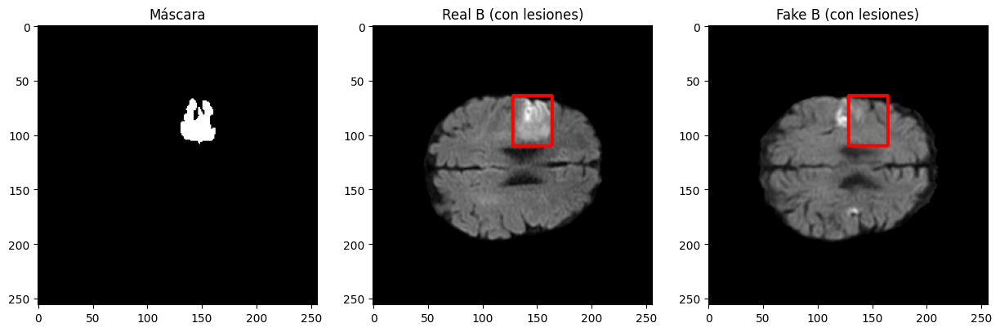

Paciente: 018, Slice 18 - SSIM: 0.611, PSNR: 10.236, MS-SSIM: 0.465


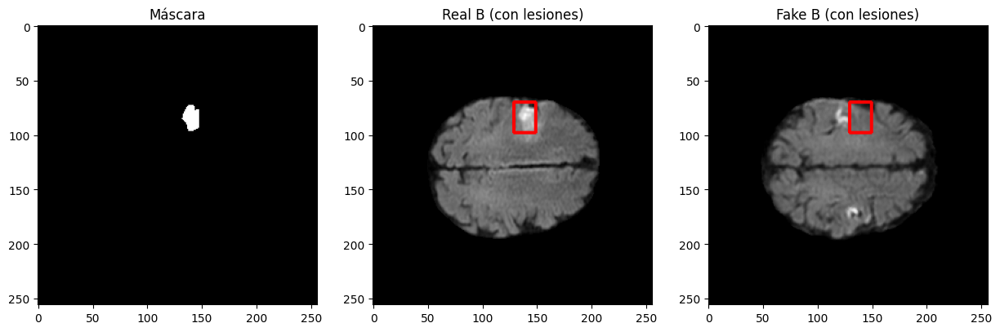

Paciente: 018, Slice 19 - SSIM: 0.458, PSNR: 2.900, MS-SSIM: 0.483


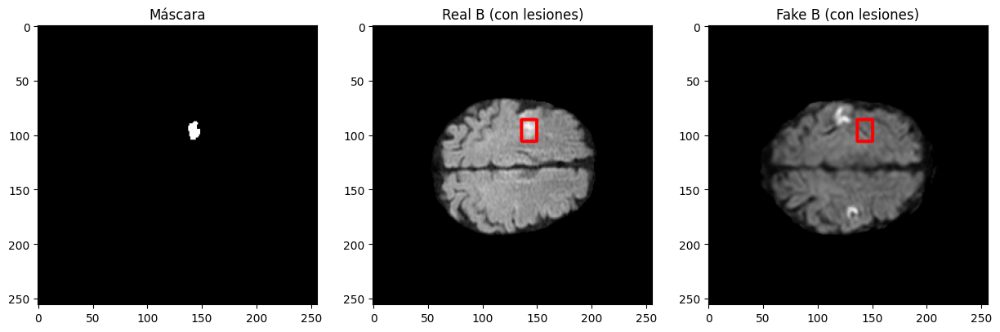

Promedio SSIM del paciente 018: 0.519
Promedio PSNR del paciente 018: 10.528
Promedio MS-SSIM del paciente 018: 0.400
Real_B ID: 019, Fake_B ID: 019, Masks ID: 019
Paciente: 019, Slice 11 - SSIM: 0.444, PSNR: 17.415, MS-SSIM: 0.329


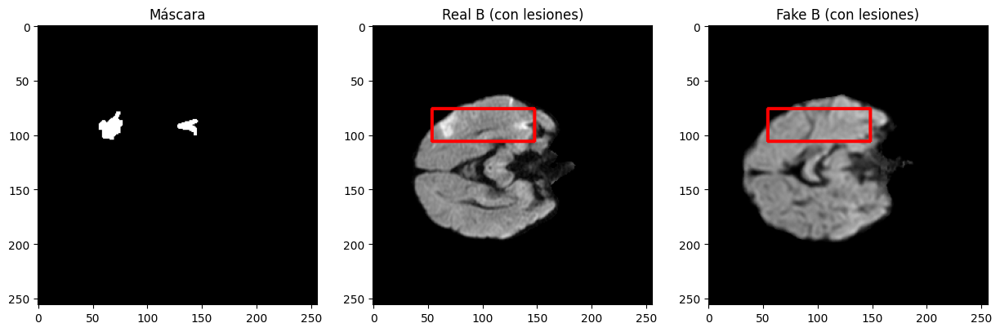

Paciente: 019, Slice 12 - SSIM: 0.417, PSNR: 15.633, MS-SSIM: 0.324


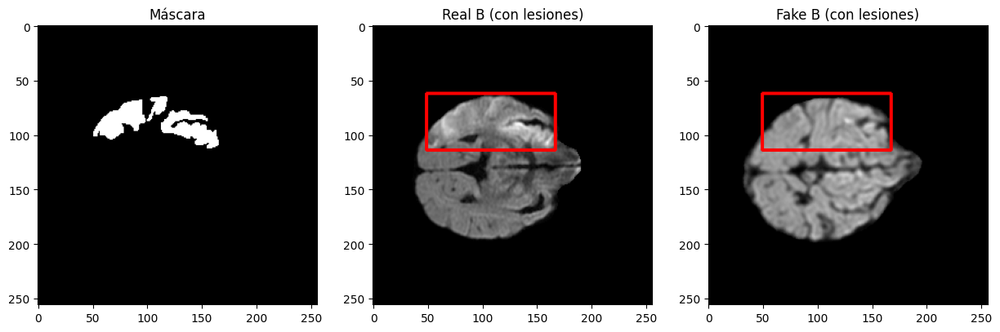

Paciente: 019, Slice 13 - SSIM: 0.424, PSNR: 14.612, MS-SSIM: 0.381


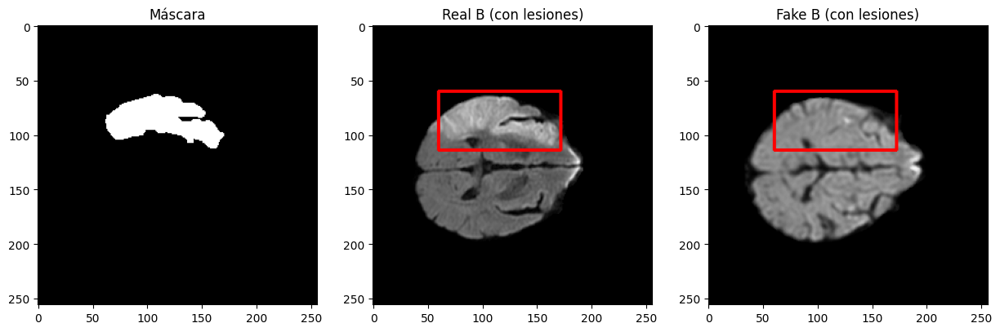

Paciente: 019, Slice 14 - SSIM: 0.462, PSNR: 16.130, MS-SSIM: 0.442


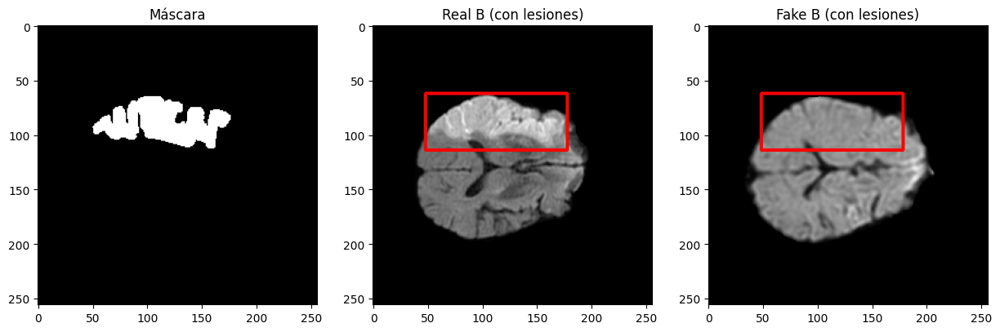

Paciente: 019, Slice 15 - SSIM: 0.449, PSNR: 15.015, MS-SSIM: 0.410


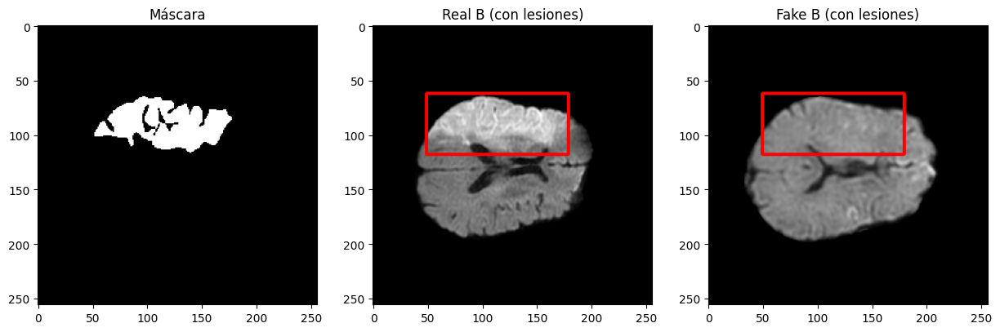

Paciente: 019, Slice 16 - SSIM: 0.466, PSNR: 14.648, MS-SSIM: 0.414


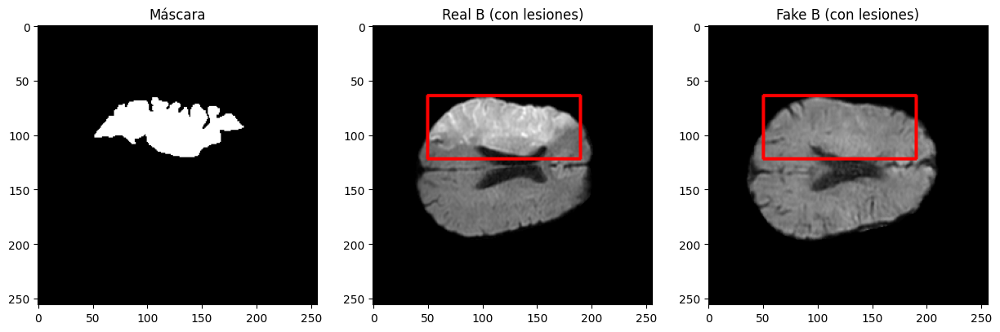

Paciente: 019, Slice 17 - SSIM: 0.492, PSNR: 16.986, MS-SSIM: 0.501


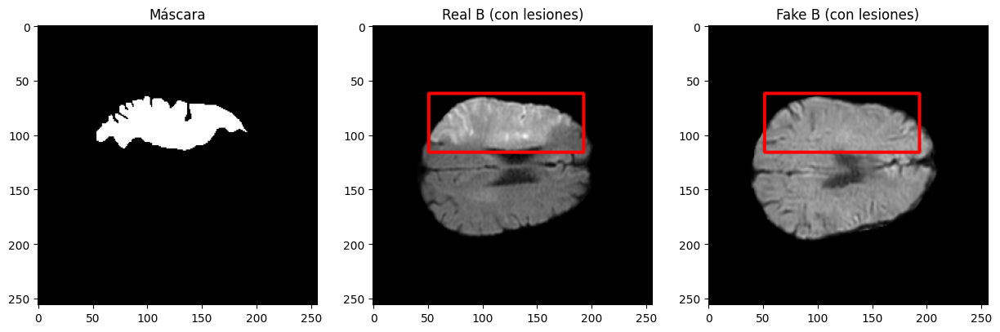

Paciente: 019, Slice 18 - SSIM: 0.397, PSNR: 14.812, MS-SSIM: 0.337


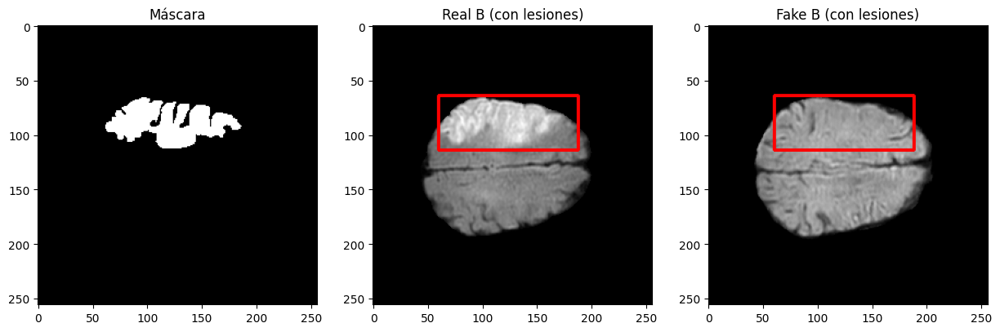

Paciente: 019, Slice 19 - SSIM: 0.437, PSNR: 15.536, MS-SSIM: 0.346


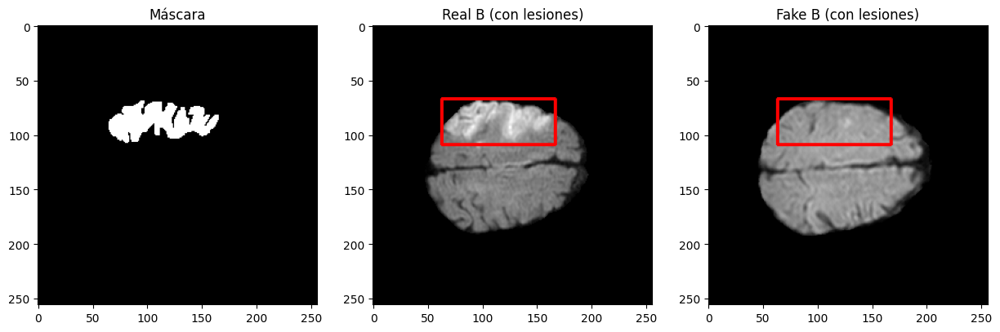

Paciente: 019, Slice 20 - SSIM: 0.467, PSNR: 15.149, MS-SSIM: 0.343


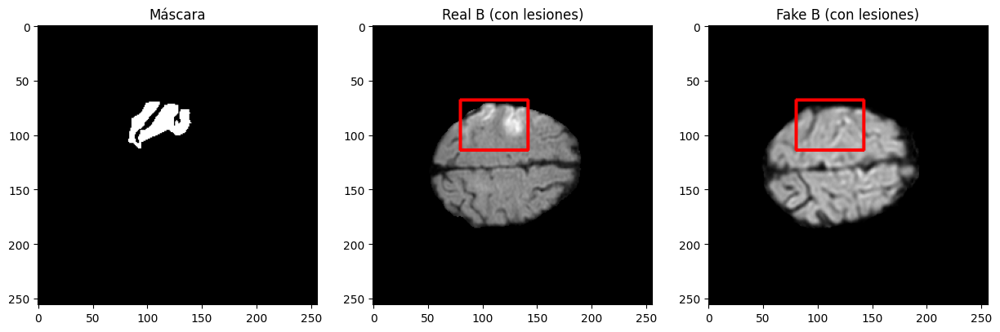

Paciente: 019, Slice 21 - SSIM: 0.602, PSNR: 16.359, MS-SSIM: 0.484


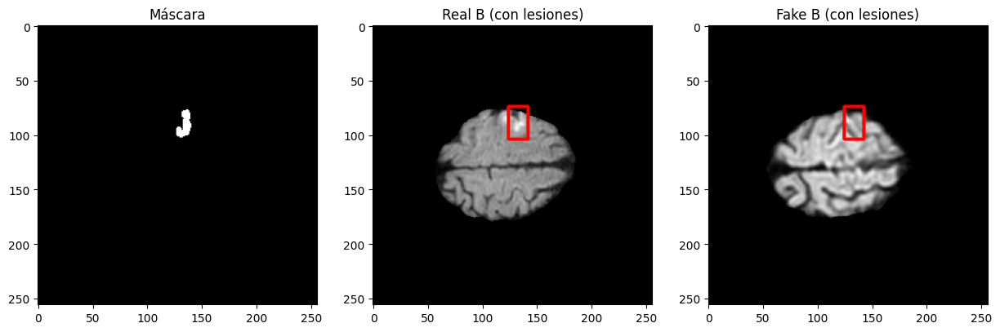

Paciente: 019, Slice 22 - SSIM: 0.673, PSNR: 11.432, MS-SSIM: 0.671


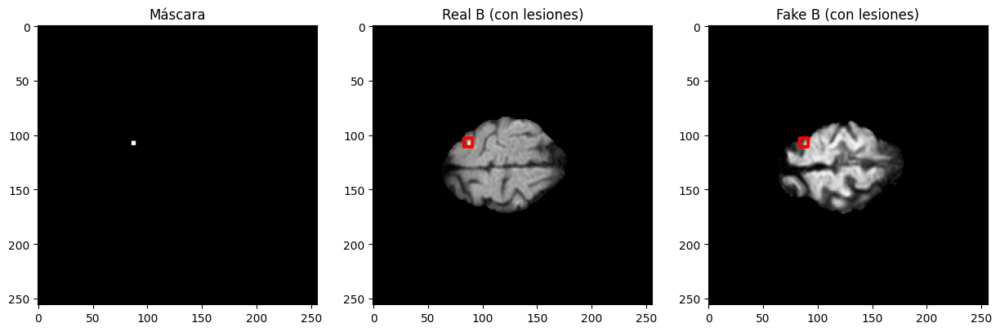

Promedio SSIM del paciente 019: 0.477
Promedio PSNR del paciente 019: 15.311
Promedio MS-SSIM del paciente 019: 0.415
Real_B ID: 020, Fake_B ID: 020, Masks ID: 020
Paciente: 020, Slice 10 - SSIM: 0.365, PSNR: 9.631, MS-SSIM: 0.327


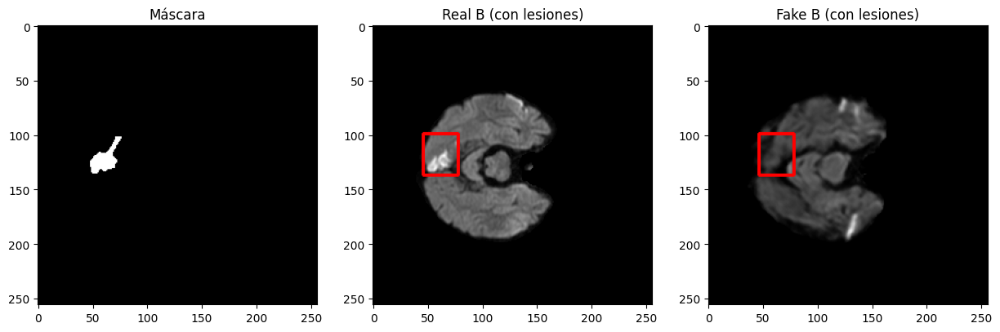

Paciente: 020, Slice 11 - SSIM: 0.331, PSNR: 12.291, MS-SSIM: 0.175


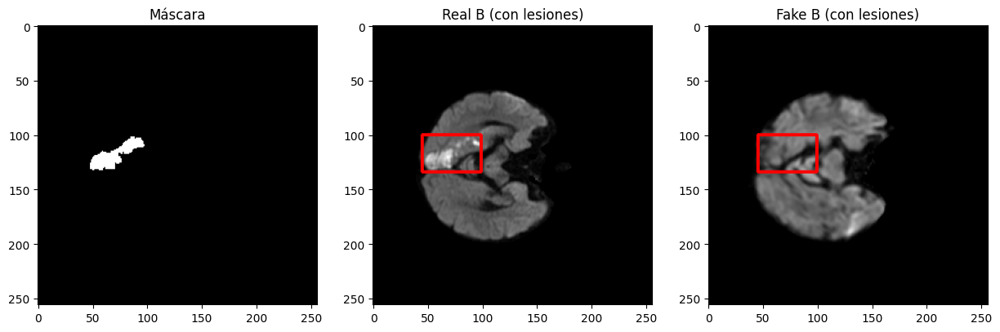

Paciente: 020, Slice 12 - SSIM: 0.389, PSNR: 12.421, MS-SSIM: 0.372


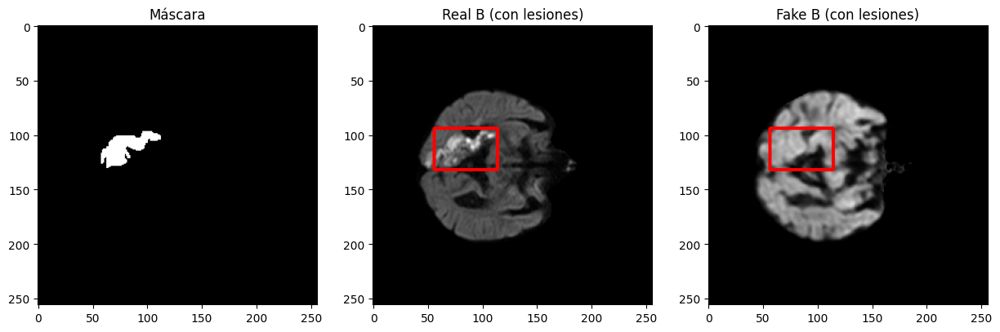

Paciente: 020, Slice 13 - SSIM: 0.361, PSNR: 11.986, MS-SSIM: 0.371


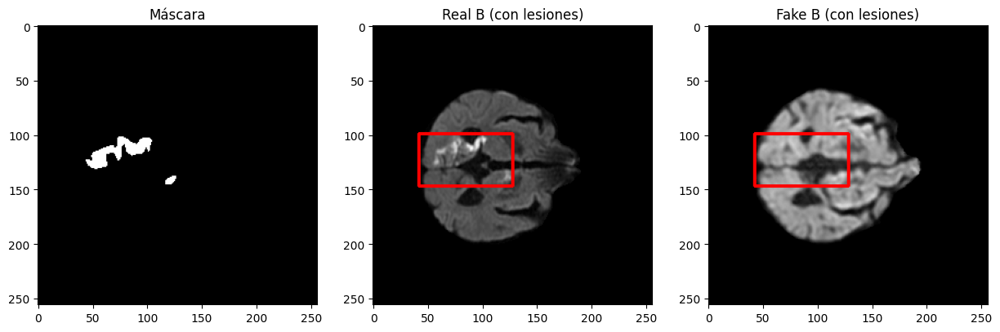

Paciente: 020, Slice 14 - SSIM: 0.416, PSNR: 14.044, MS-SSIM: 0.439


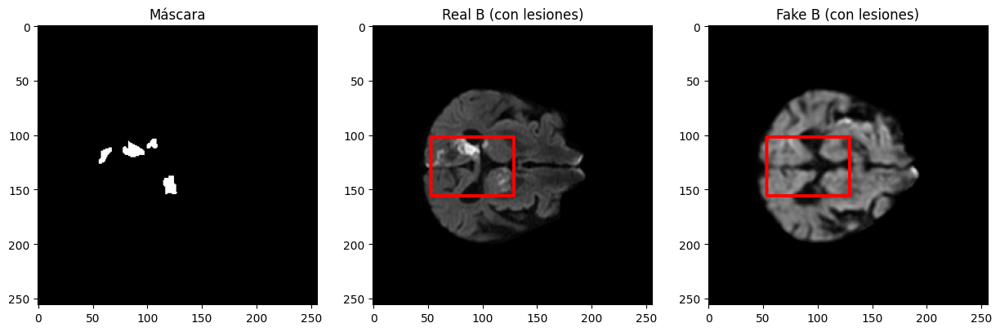

Paciente: 020, Slice 15 - SSIM: 0.483, PSNR: 16.096, MS-SSIM: 0.515


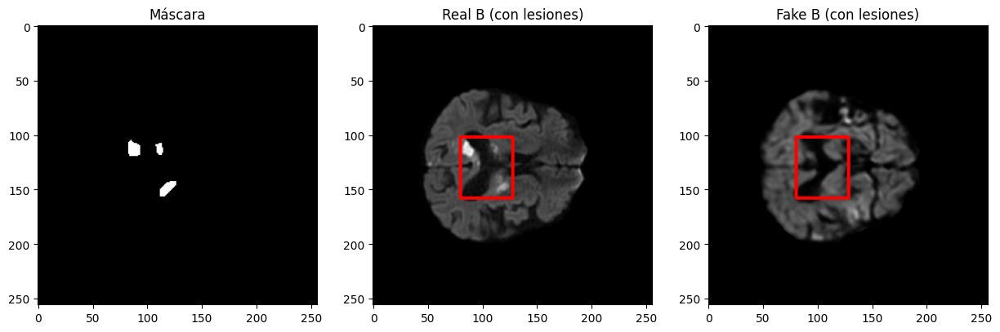

Paciente: 020, Slice 16 - SSIM: 0.522, PSNR: 7.211, MS-SSIM: 0.432


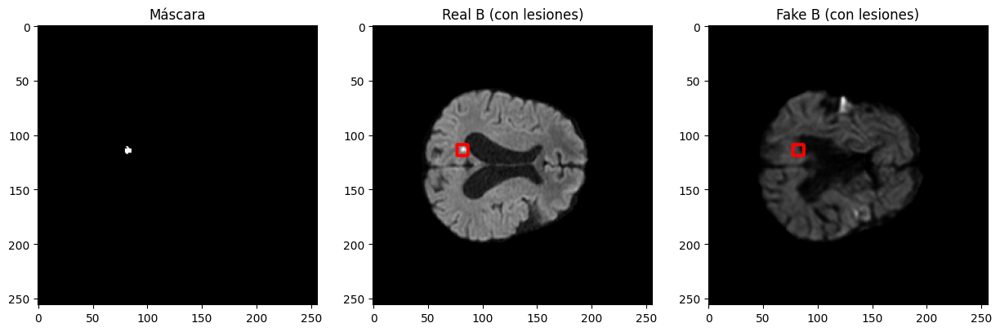

Promedio SSIM del paciente 020: 0.410
Promedio PSNR del paciente 020: 11.954
Promedio MS-SSIM del paciente 020: 0.376
Real_B ID: 021, Fake_B ID: 021, Masks ID: 021
Paciente: 021, Slice 13 - SSIM: 0.552, PSNR: 11.160, MS-SSIM: 0.558


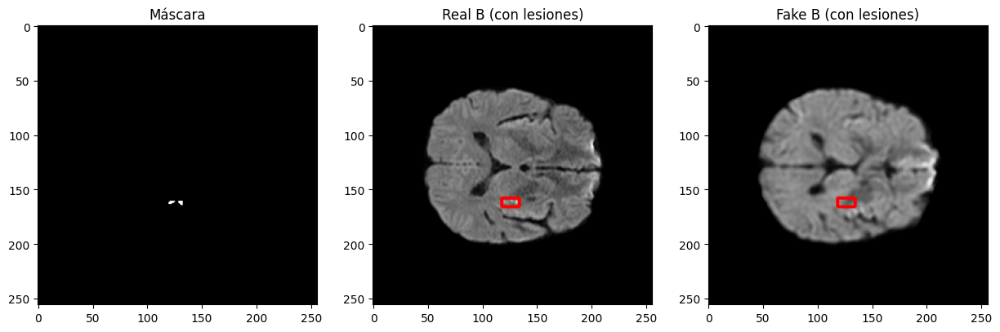

Paciente: 021, Slice 14 - SSIM: 0.535, PSNR: 12.940, MS-SSIM: 0.414


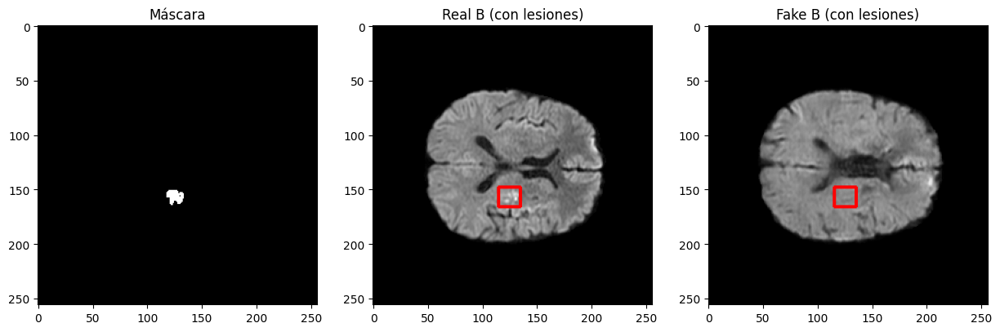

Paciente: 021, Slice 15 - SSIM: 0.575, PSNR: 13.310, MS-SSIM: 0.490


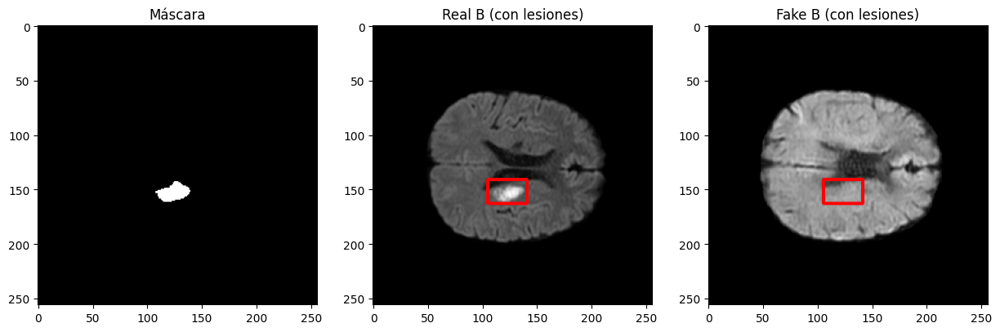

Paciente: 021, Slice 16 - SSIM: 0.566, PSNR: 12.680, MS-SSIM: 0.334


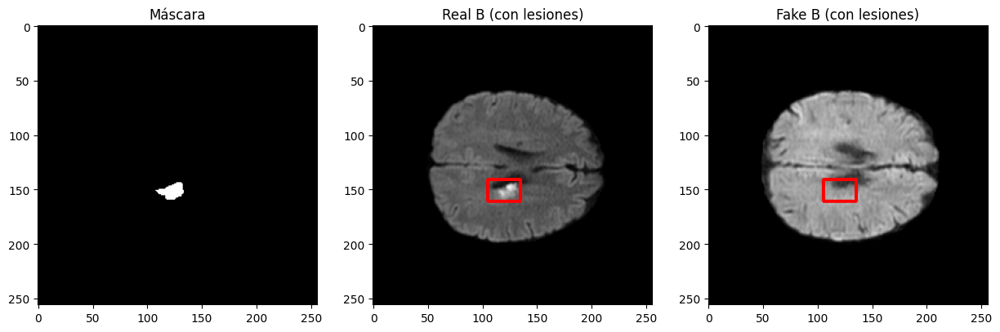

Promedio SSIM del paciente 021: 0.557
Promedio PSNR del paciente 021: 12.523
Promedio MS-SSIM del paciente 021: 0.449
Real_B ID: 022, Fake_B ID: 022, Masks ID: 022
Paciente: 022, Slice 6 - SSIM: 0.513, PSNR: 14.884, MS-SSIM: 0.469


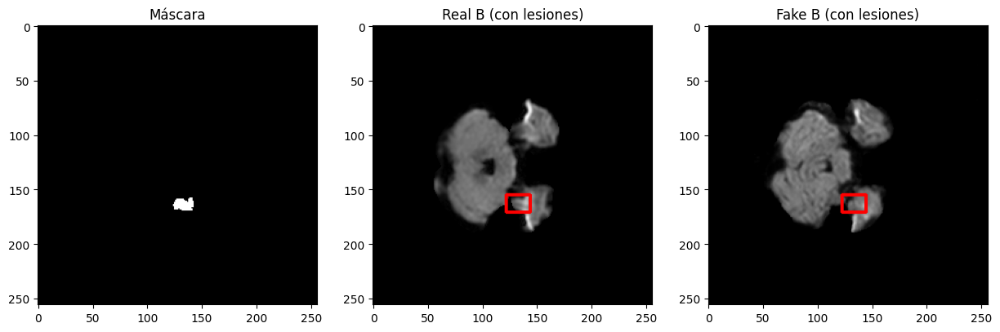

Paciente: 022, Slice 7 - SSIM: 0.424, PSNR: 15.623, MS-SSIM: 0.426


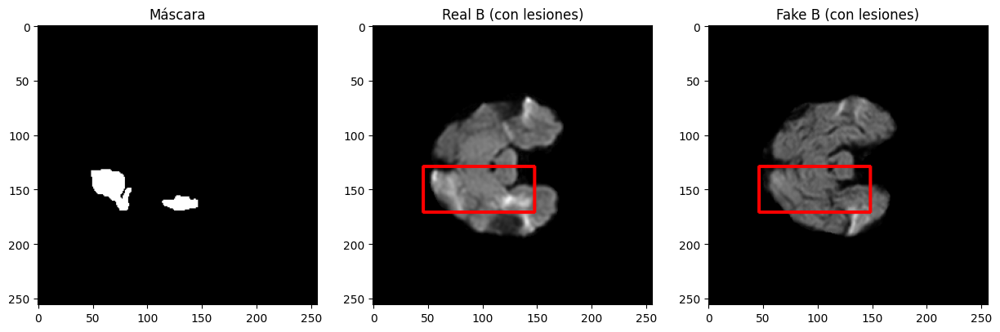

Paciente: 022, Slice 8 - SSIM: 0.408, PSNR: 12.195, MS-SSIM: 0.386


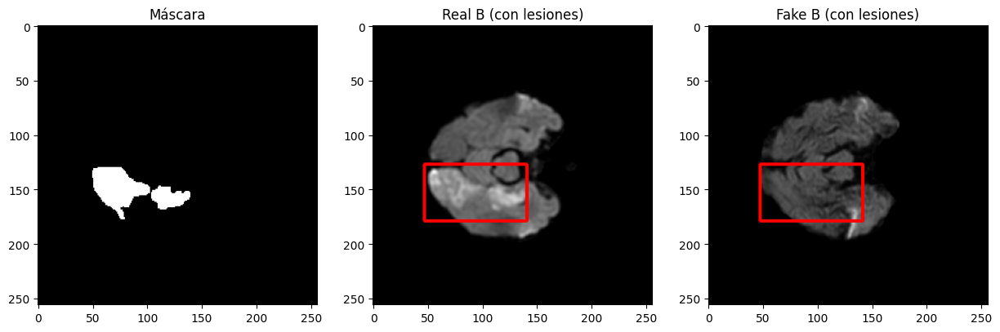

Paciente: 022, Slice 9 - SSIM: 0.410, PSNR: 13.612, MS-SSIM: 0.327


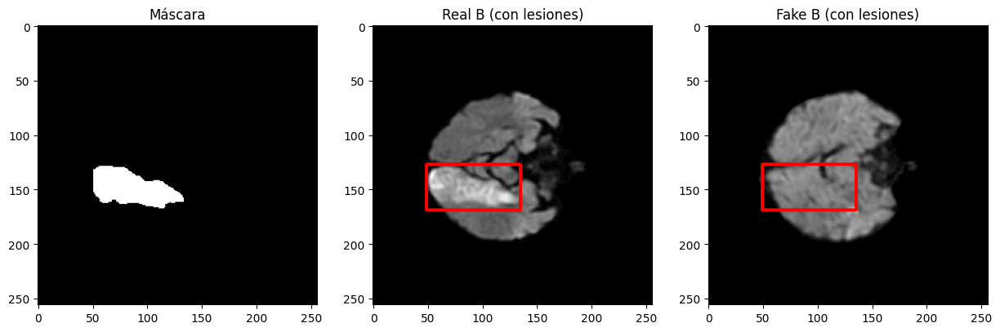

Paciente: 022, Slice 10 - SSIM: 0.430, PSNR: 13.636, MS-SSIM: 0.362


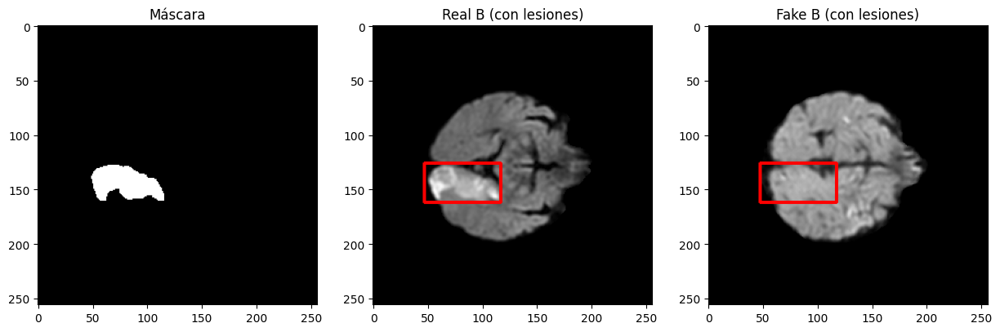

Paciente: 022, Slice 11 - SSIM: 0.408, PSNR: 14.889, MS-SSIM: 0.380


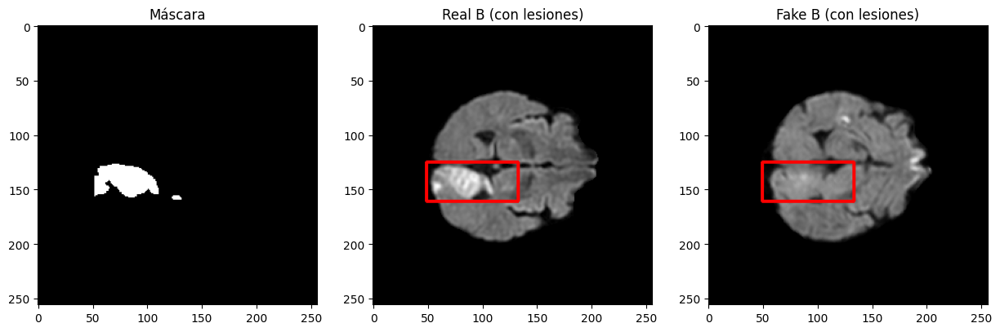

Paciente: 022, Slice 12 - SSIM: 0.547, PSNR: 14.746, MS-SSIM: 0.527


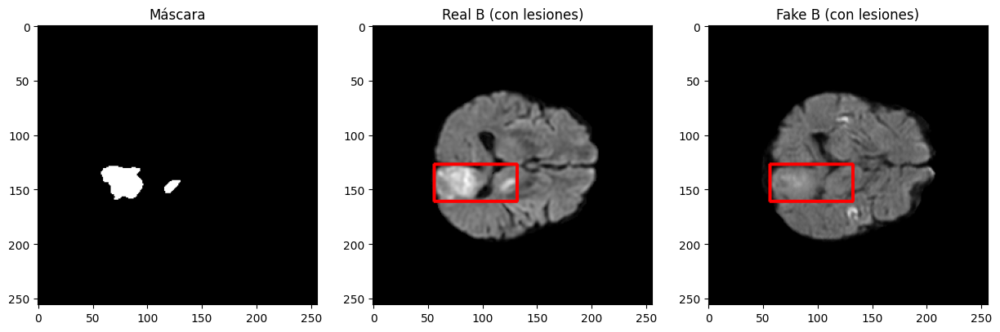

Paciente: 022, Slice 13 - SSIM: 0.583, PSNR: 12.756, MS-SSIM: 0.483


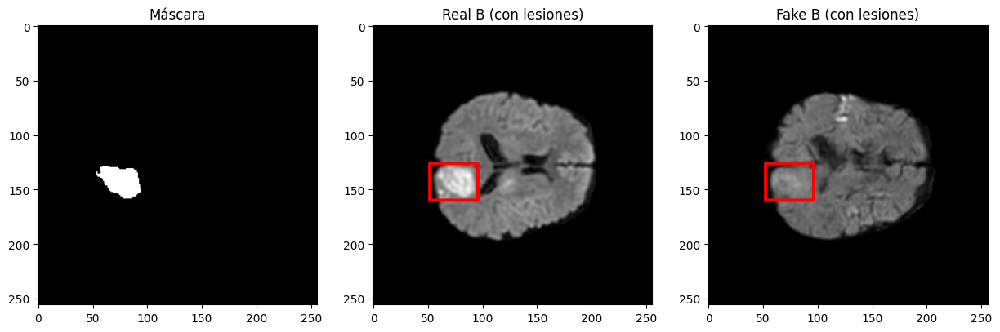

Paciente: 022, Slice 14 - SSIM: 0.606, PSNR: 15.047, MS-SSIM: 0.532


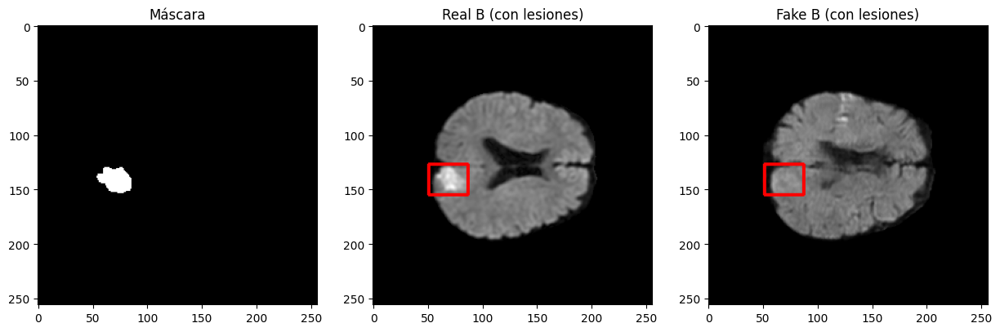

Paciente: 022, Slice 15 - SSIM: 0.660, PSNR: 12.302, MS-SSIM: 0.482


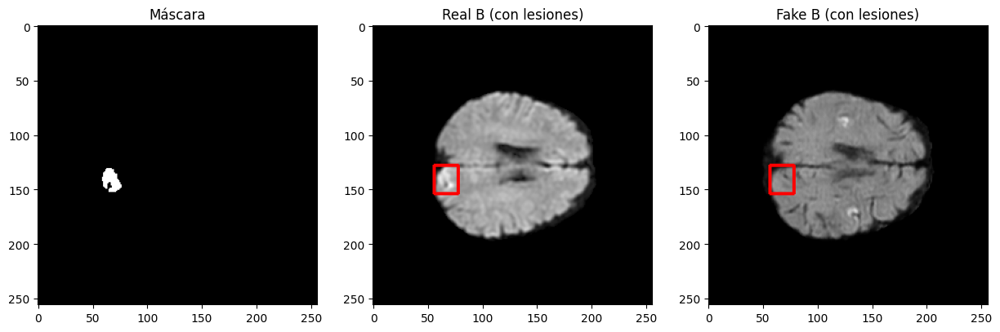

Promedio SSIM del paciente 022: 0.499
Promedio PSNR del paciente 022: 13.969
Promedio MS-SSIM del paciente 022: 0.437
Real_B ID: 023, Fake_B ID: 023, Masks ID: 023
Real_B ID: 024, Fake_B ID: 024, Masks ID: 024
Real_B ID: 025, Fake_B ID: 025, Masks ID: 025
Paciente: 025, Slice 6 - SSIM: 0.637, PSNR: 10.626, MS-SSIM: 0.465


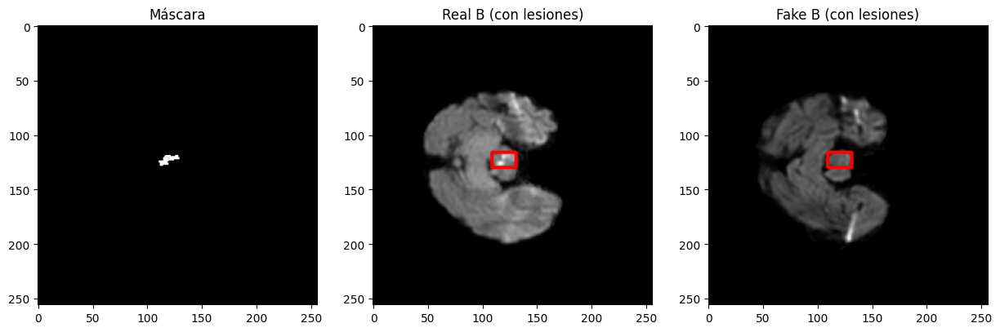

Paciente: 025, Slice 7 - SSIM: 0.626, PSNR: 3.836, MS-SSIM: 0.634


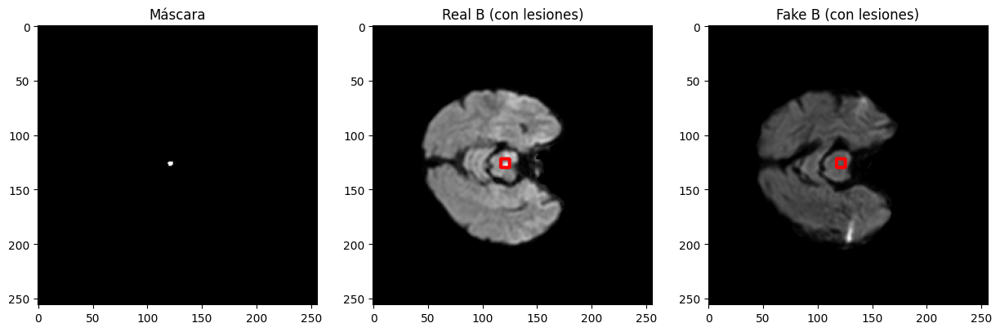

Promedio SSIM del paciente 025: 0.631
Promedio PSNR del paciente 025: 7.231
Promedio MS-SSIM del paciente 025: 0.550
Real_B ID: 026, Fake_B ID: 026, Masks ID: 026
Paciente: 026, Slice 16 - SSIM: 0.581, PSNR: 6.679, MS-SSIM: 0.451


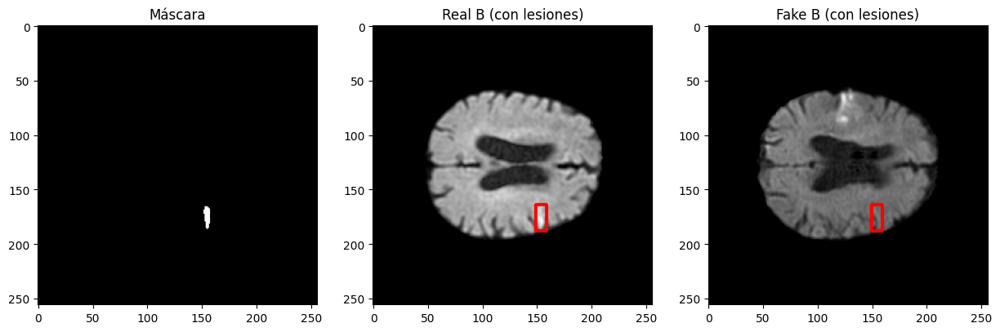

Paciente: 026, Slice 17 - SSIM: 0.456, PSNR: 8.502, MS-SSIM: 0.246


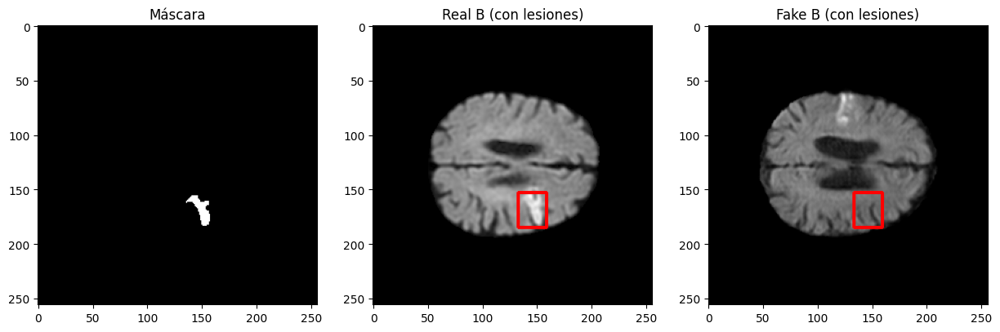

Paciente: 026, Slice 18 - SSIM: 0.544, PSNR: 14.062, MS-SSIM: 0.343


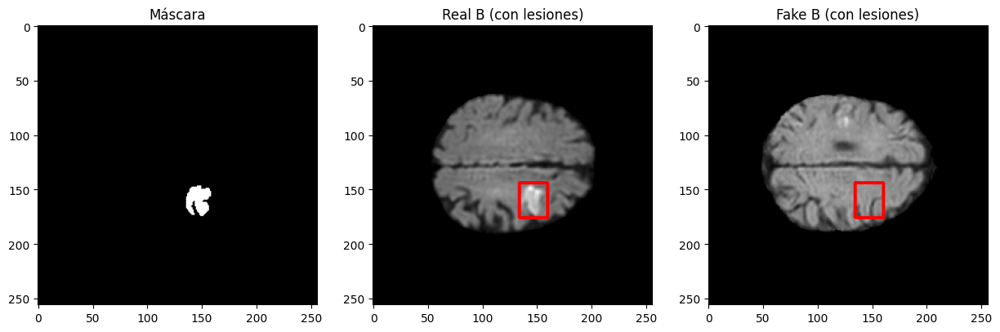

Paciente: 026, Slice 19 - SSIM: 0.427, PSNR: 13.670, MS-SSIM: 0.150


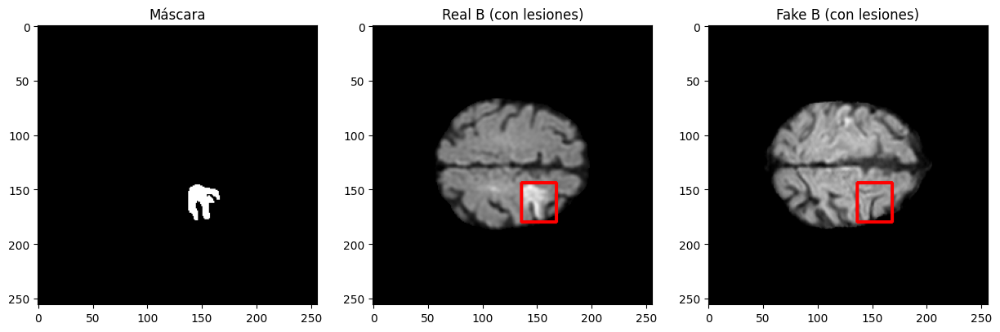

Paciente: 026, Slice 20 - SSIM: 0.518, PSNR: 13.693, MS-SSIM: 0.432


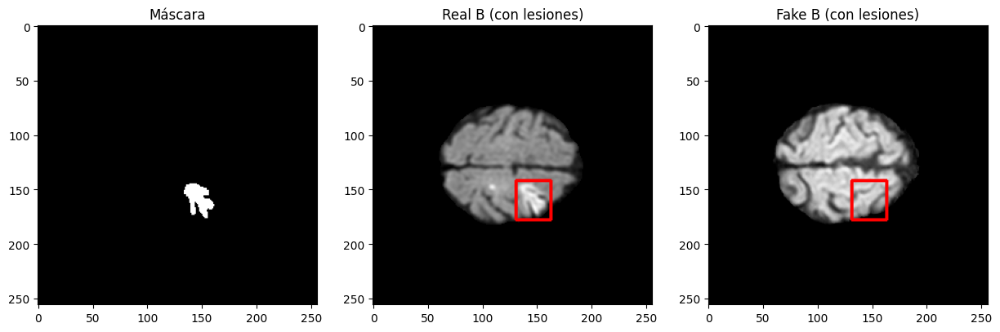

Paciente: 026, Slice 21 - SSIM: 0.580, PSNR: 12.689, MS-SSIM: 0.576


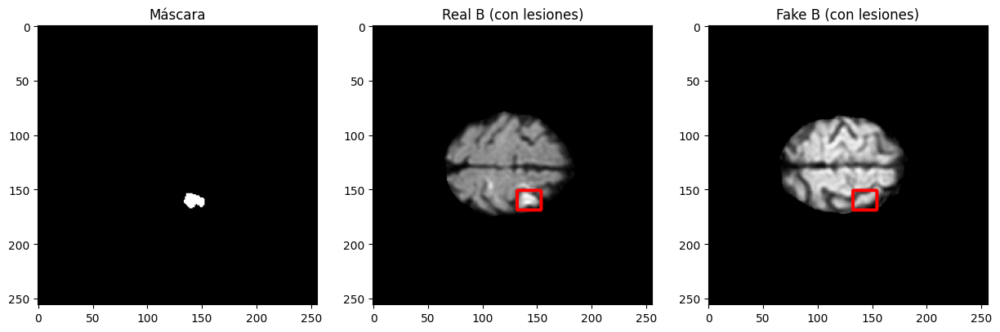

Promedio SSIM del paciente 026: 0.518
Promedio PSNR del paciente 026: 11.549
Promedio MS-SSIM del paciente 026: 0.366
Real_B ID: 027, Fake_B ID: 027, Masks ID: 027
Paciente: 027, Slice 7 - SSIM: 0.333, PSNR: 5.429, MS-SSIM: 0.267


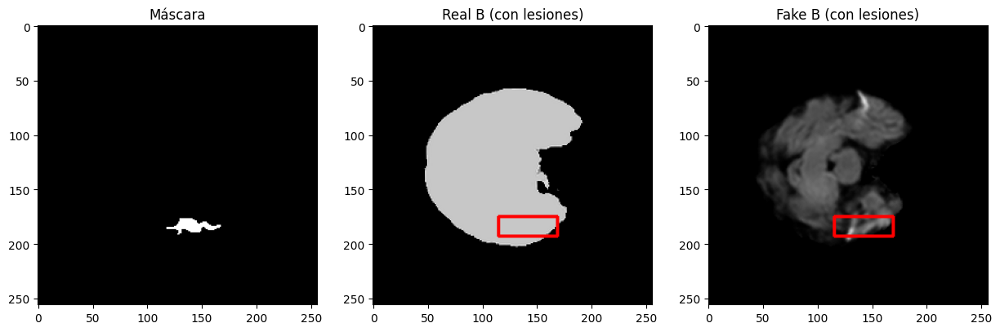

Paciente: 027, Slice 8 - SSIM: 0.436, PSNR: 5.423, MS-SSIM: 0.411


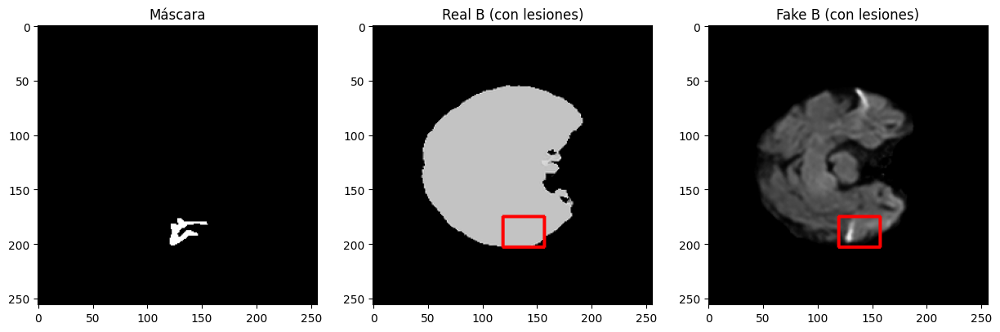

Paciente: 027, Slice 10 - SSIM: 0.483, PSNR: 6.160, MS-SSIM: 0.398


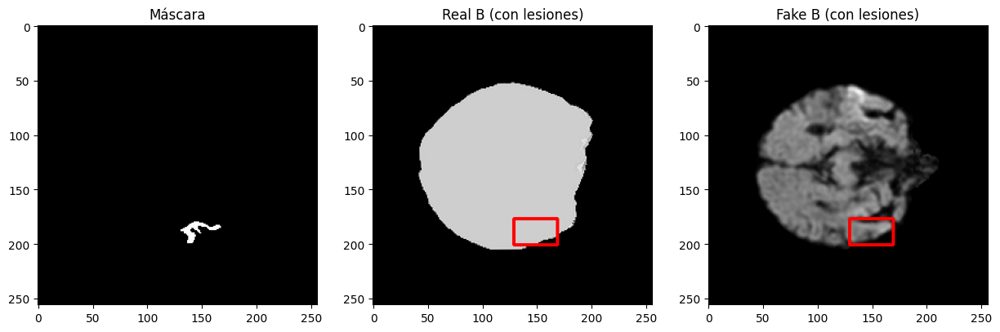

Promedio SSIM del paciente 027: 0.418
Promedio PSNR del paciente 027: 5.671
Promedio MS-SSIM del paciente 027: 0.359
Real_B ID: 028, Fake_B ID: 028, Masks ID: 028
Paciente: 028, Slice 10 - SSIM: 0.484, PSNR: 13.392, MS-SSIM: 0.554


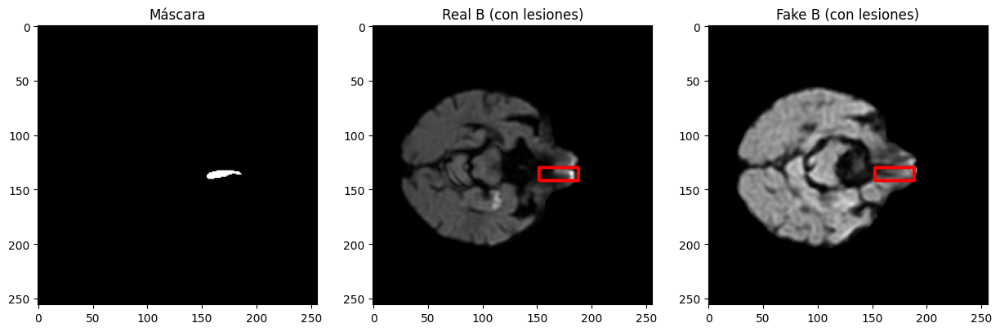

Paciente: 028, Slice 11 - SSIM: 0.568, PSNR: 12.984, MS-SSIM: 0.423


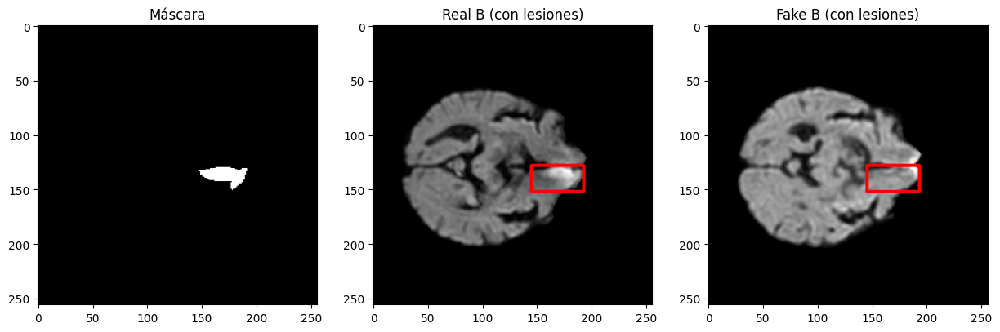

Paciente: 028, Slice 12 - SSIM: 0.530, PSNR: 14.588, MS-SSIM: 0.433


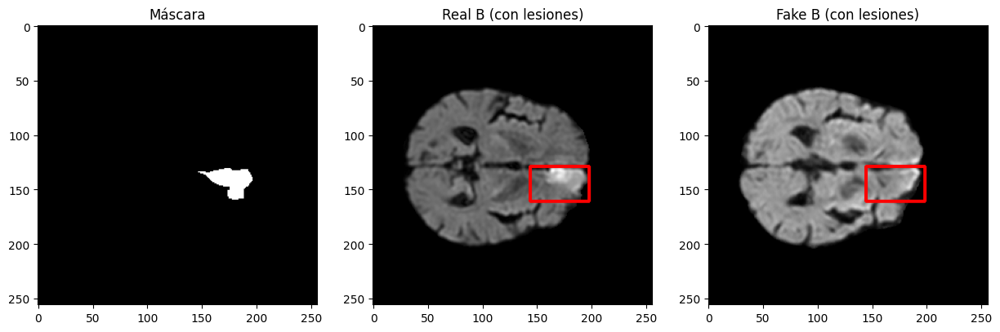

Paciente: 028, Slice 13 - SSIM: 0.521, PSNR: 13.322, MS-SSIM: 0.450


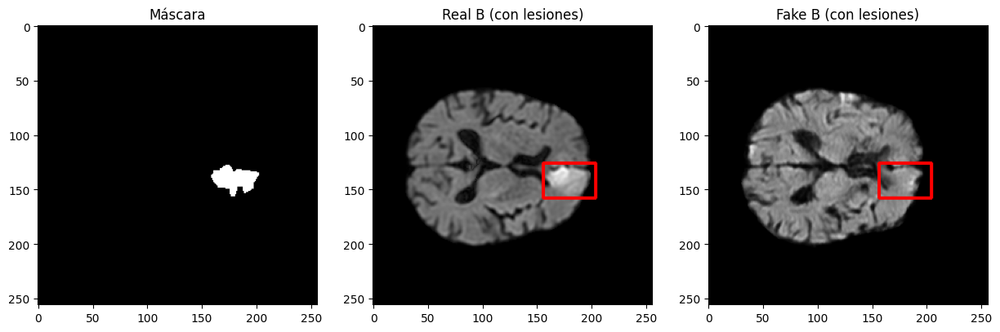

Paciente: 028, Slice 14 - SSIM: 0.434, PSNR: 16.254, MS-SSIM: 0.496


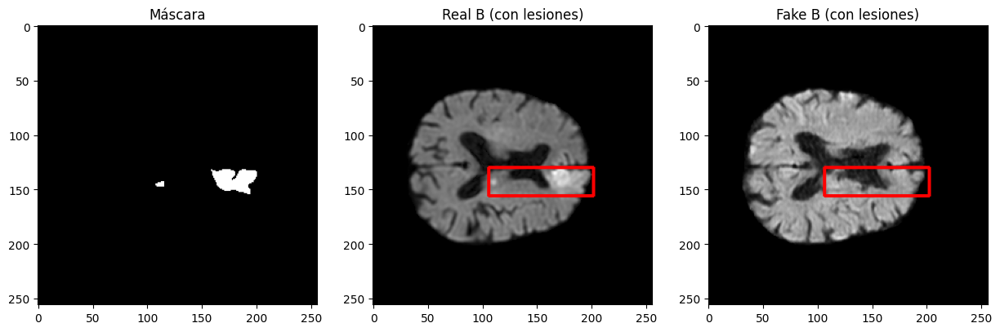

Paciente: 028, Slice 15 - SSIM: 0.620, PSNR: 17.013, MS-SSIM: 0.530


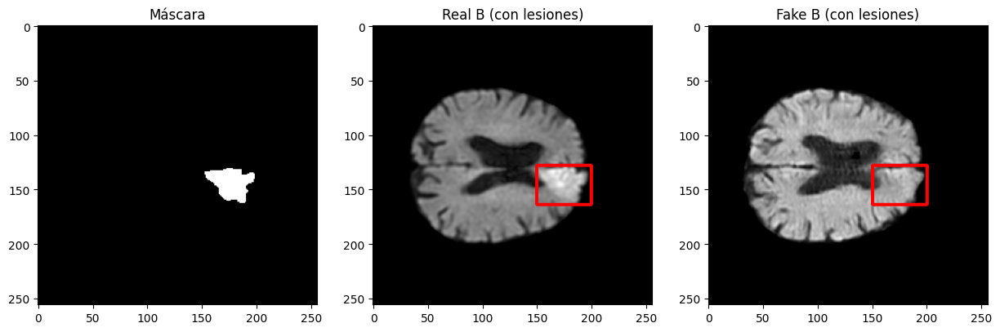

Paciente: 028, Slice 16 - SSIM: 0.506, PSNR: 15.924, MS-SSIM: 0.515


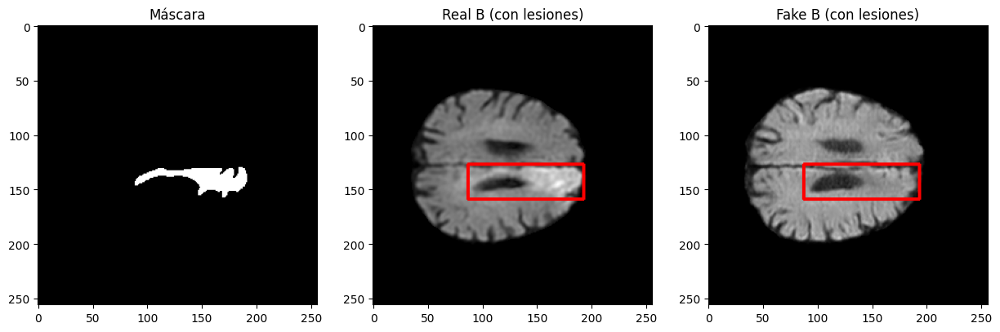

Paciente: 028, Slice 17 - SSIM: 0.424, PSNR: 12.297, MS-SSIM: 0.401


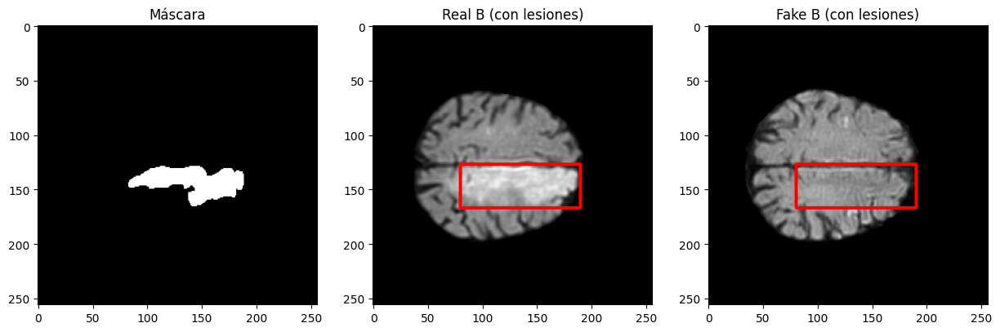

Paciente: 028, Slice 18 - SSIM: 0.425, PSNR: 14.325, MS-SSIM: 0.426


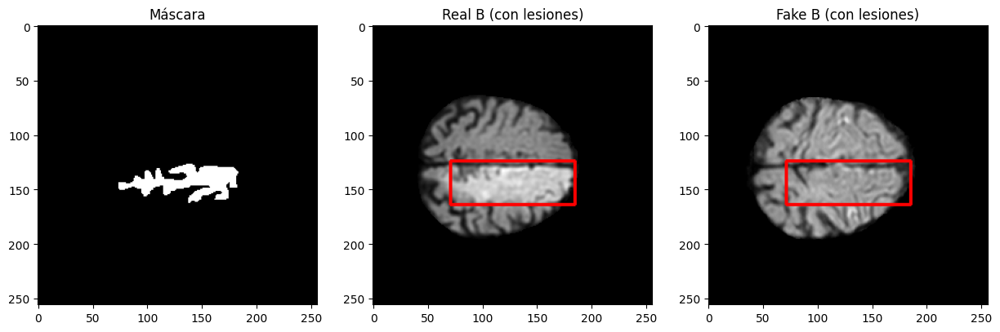

Paciente: 028, Slice 19 - SSIM: 0.304, PSNR: 13.695, MS-SSIM: 0.299


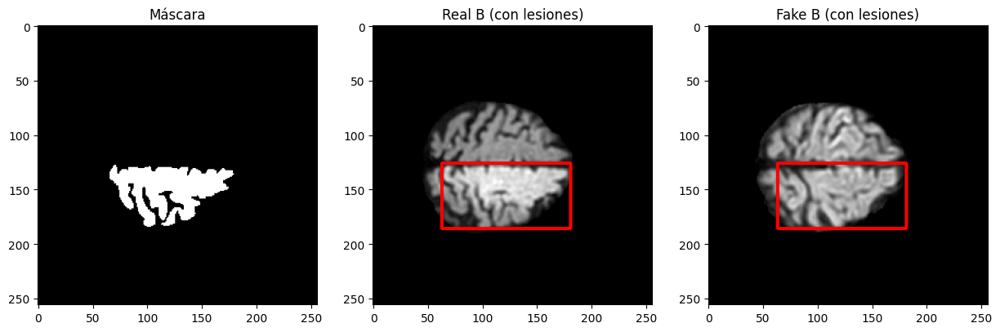

Paciente: 028, Slice 20 - SSIM: 0.287, PSNR: 12.234, MS-SSIM: 0.299


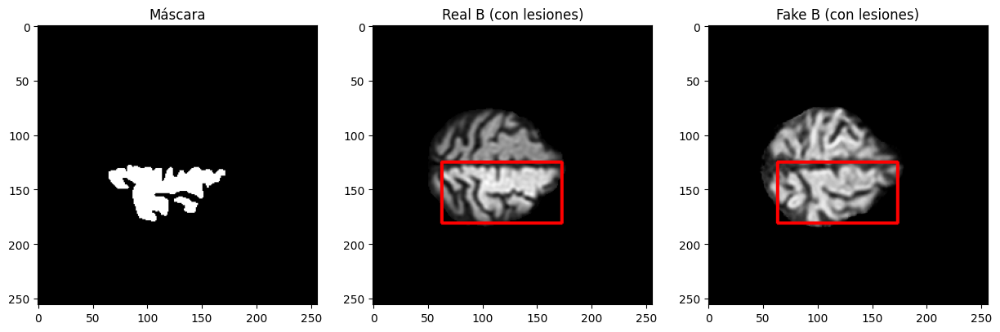

Paciente: 028, Slice 21 - SSIM: 0.273, PSNR: 11.261, MS-SSIM: 0.265


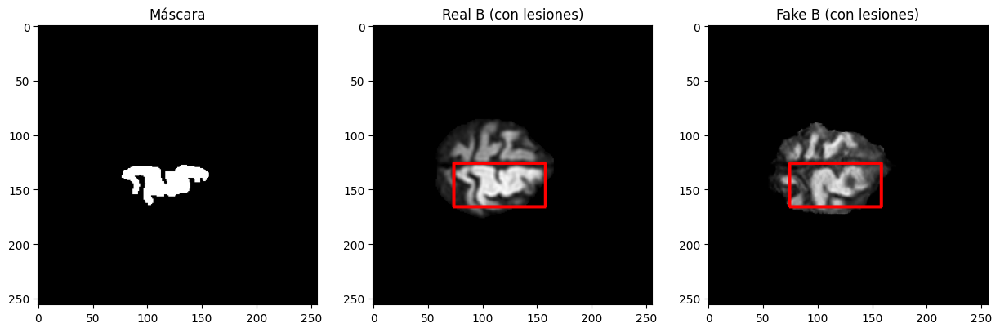

Paciente: 028, Slice 22 - SSIM: 0.400, PSNR: 11.592, MS-SSIM: 0.384


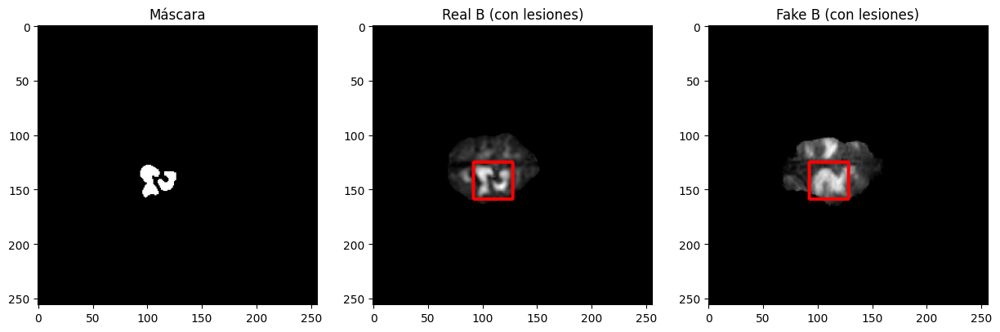

Promedio SSIM del paciente 028: 0.444
Promedio PSNR del paciente 028: 13.760
Promedio MS-SSIM del paciente 028: 0.421
Real_B ID: 029, Fake_B ID: 029, Masks ID: 029
Paciente: 029, Slice 11 - SSIM: 0.419, PSNR: 11.401, MS-SSIM: 0.252


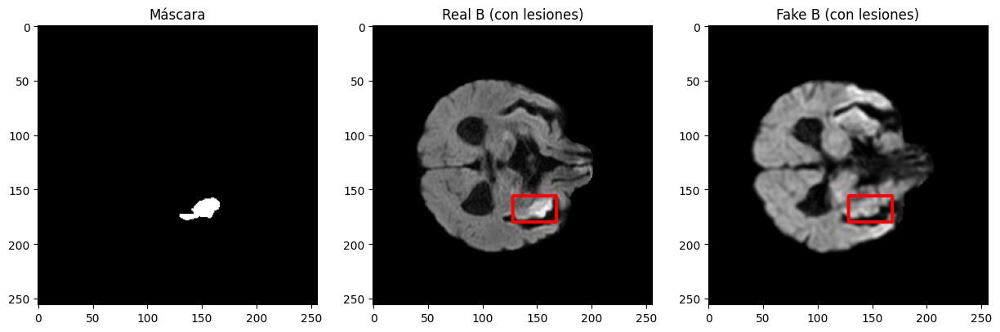

Paciente: 029, Slice 12 - SSIM: 0.373, PSNR: 13.376, MS-SSIM: 0.297


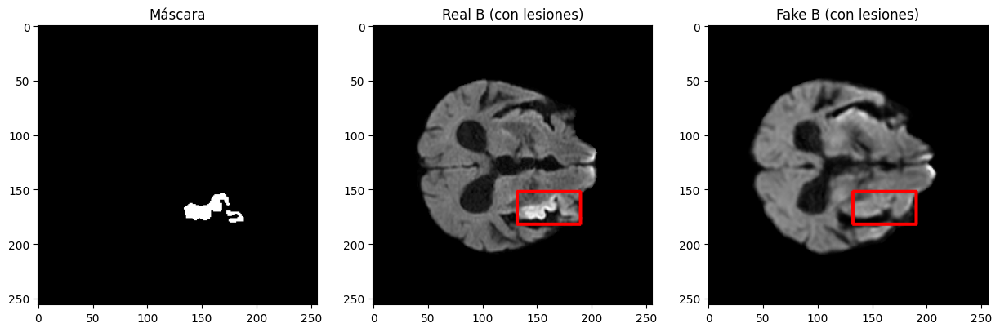

Paciente: 029, Slice 13 - SSIM: 0.385, PSNR: 12.899, MS-SSIM: 0.309


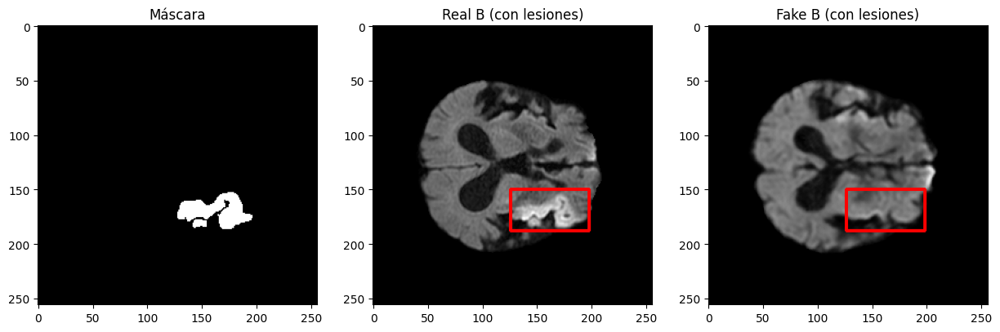

Paciente: 029, Slice 14 - SSIM: 0.475, PSNR: 11.500, MS-SSIM: 0.366


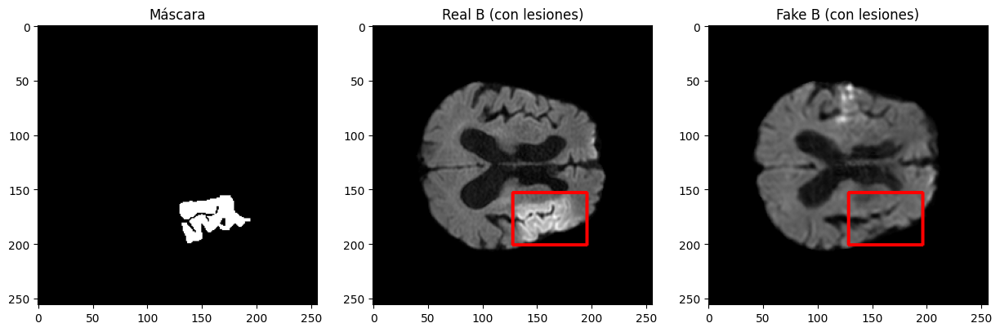

Paciente: 029, Slice 15 - SSIM: 0.395, PSNR: 11.105, MS-SSIM: 0.239


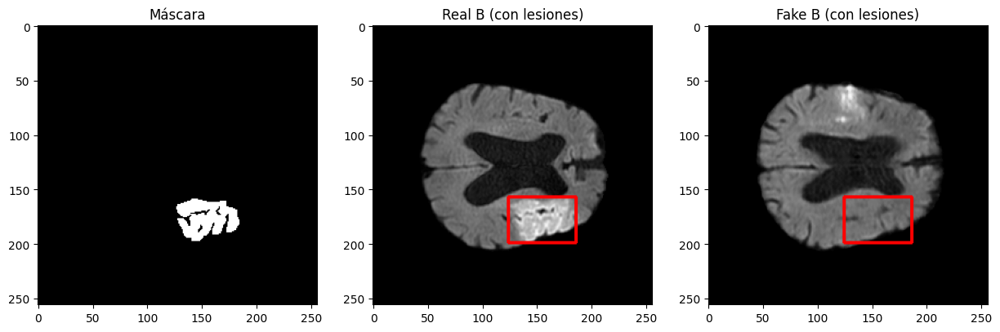

Paciente: 029, Slice 16 - SSIM: 0.486, PSNR: 13.335, MS-SSIM: 0.316


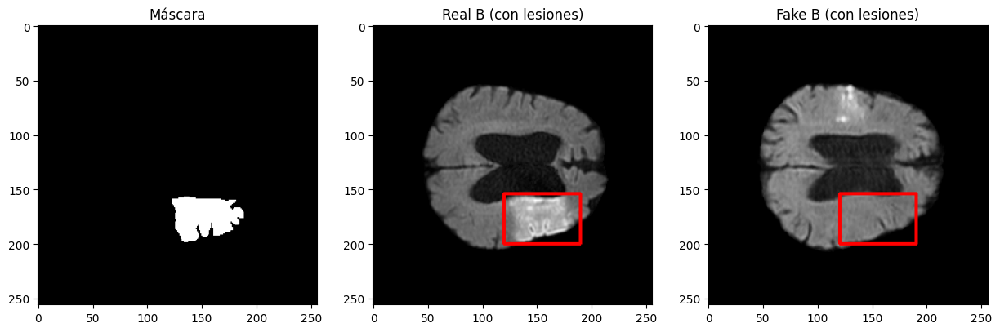

Paciente: 029, Slice 17 - SSIM: 0.482, PSNR: 12.216, MS-SSIM: 0.330


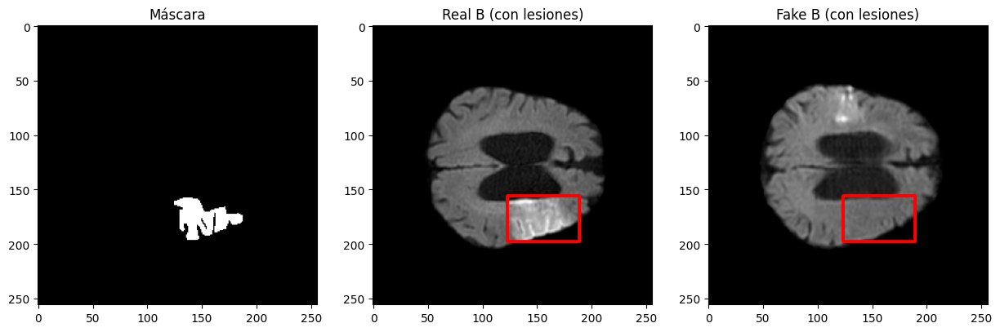

Paciente: 029, Slice 18 - SSIM: 0.473, PSNR: 10.680, MS-SSIM: 0.333


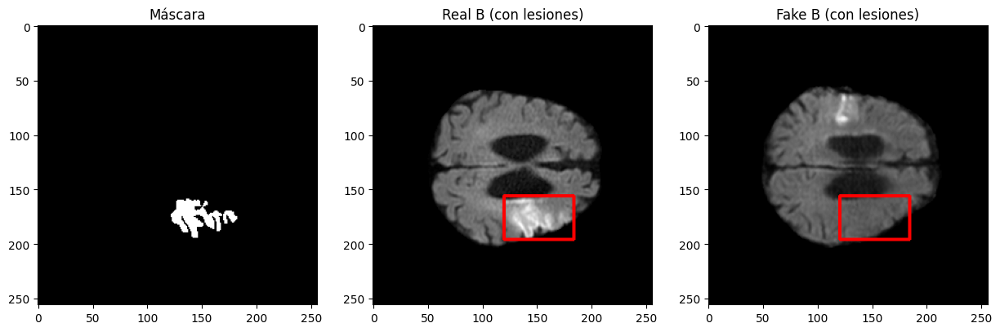

Paciente: 029, Slice 19 - SSIM: 0.609, PSNR: 11.602, MS-SSIM: 0.450


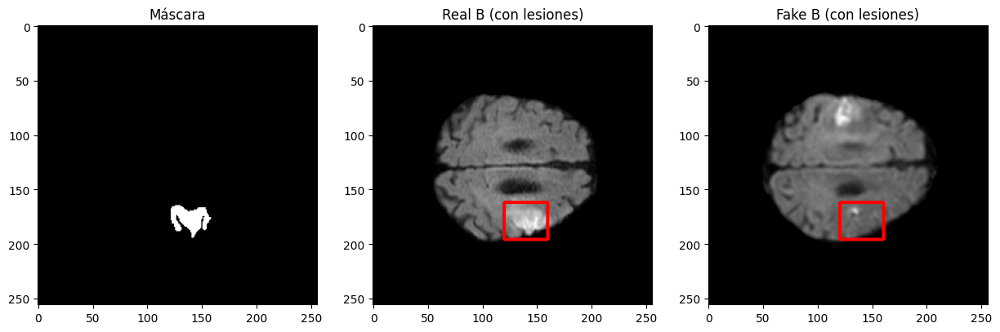

Paciente: 029, Slice 20 - SSIM: 0.552, PSNR: 13.021, MS-SSIM: 0.317


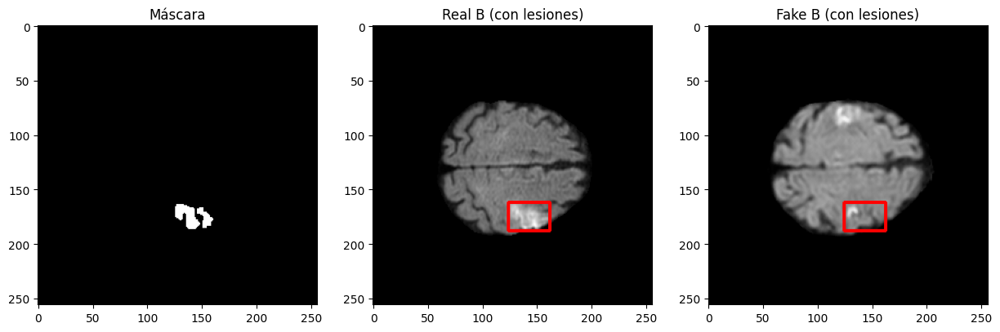

Paciente: 029, Slice 21 - SSIM: 0.577, PSNR: 14.044, MS-SSIM: 0.459


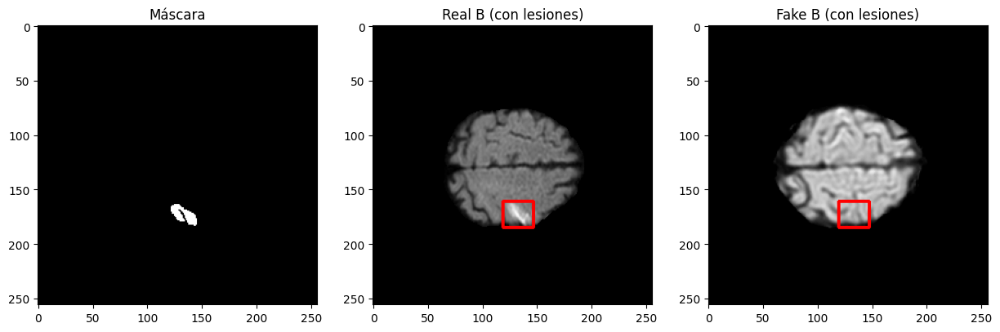

Promedio SSIM del paciente 029: 0.475
Promedio PSNR del paciente 029: 12.289
Promedio MS-SSIM del paciente 029: 0.333
Real_B ID: 030, Fake_B ID: 030, Masks ID: 030
Paciente: 030, Slice 14 - SSIM: 0.641, PSNR: 12.581, MS-SSIM: 0.478


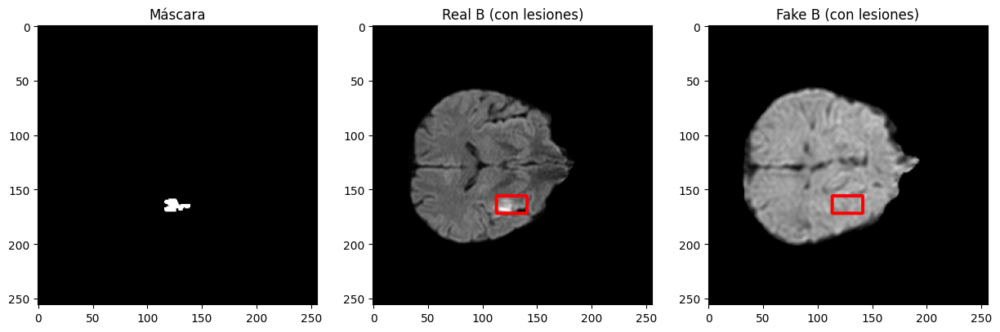

Paciente: 030, Slice 15 - SSIM: 0.579, PSNR: 14.187, MS-SSIM: 0.414


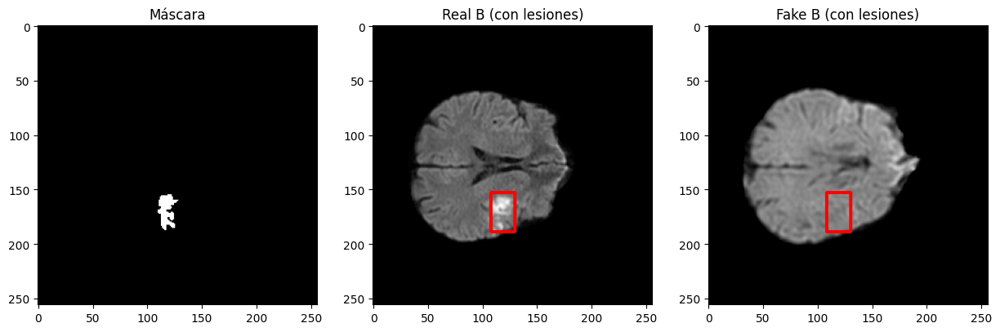

Paciente: 030, Slice 16 - SSIM: 0.527, PSNR: 14.447, MS-SSIM: 0.386


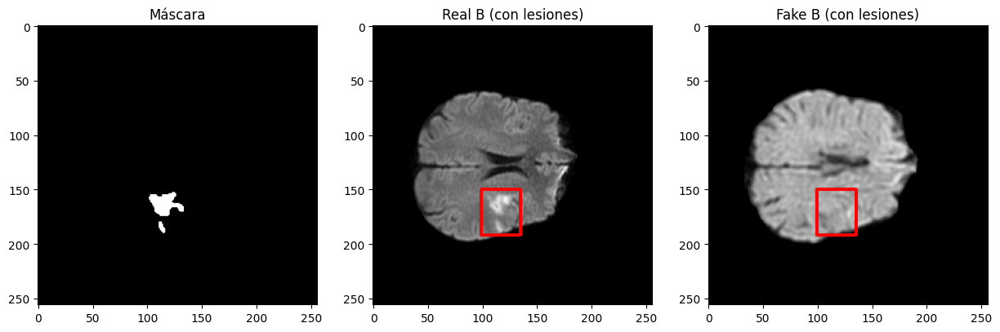

Paciente: 030, Slice 17 - SSIM: 0.483, PSNR: 7.180, MS-SSIM: 0.625


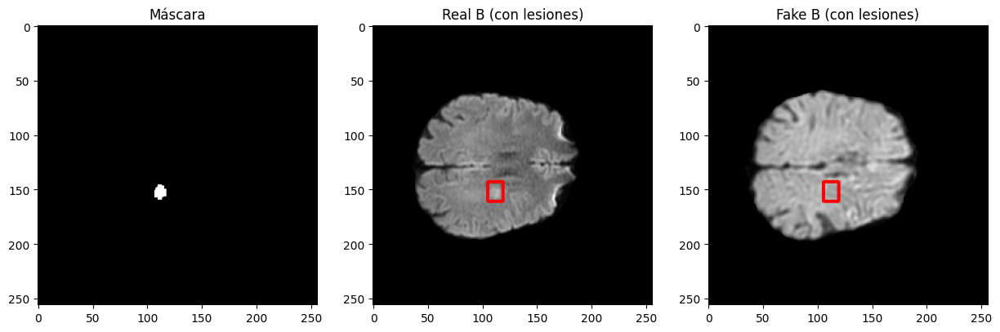

Paciente: 030, Slice 18 - SSIM: 0.684, PSNR: 11.150, MS-SSIM: 0.721


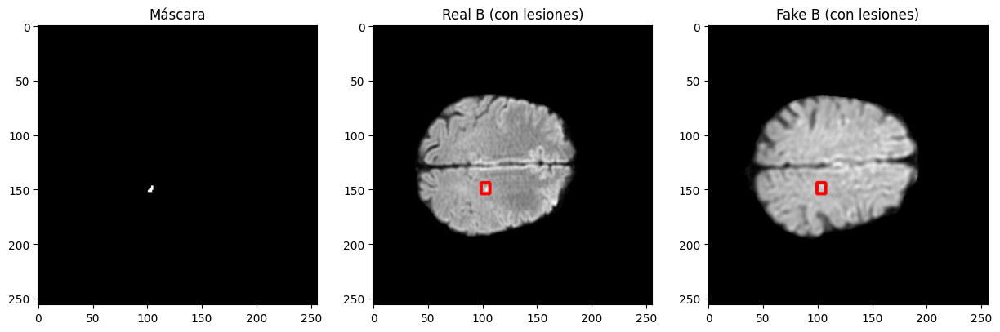

Paciente: 030, Slice 20 - SSIM: 0.630, PSNR: 10.143, MS-SSIM: 0.587


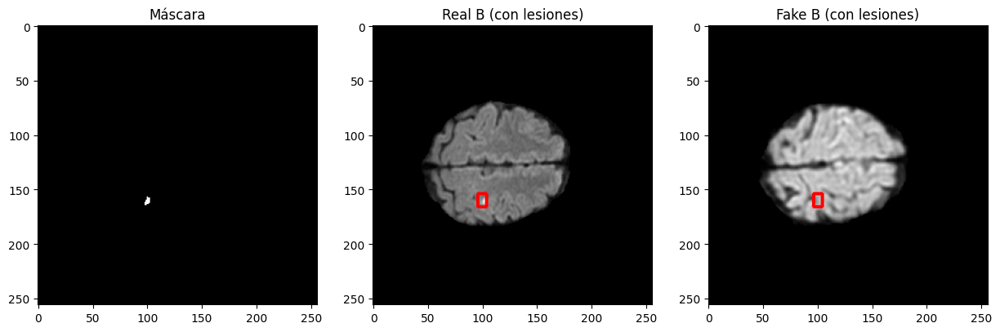

Promedio SSIM del paciente 030: 0.591
Promedio PSNR del paciente 030: 11.615
Promedio MS-SSIM del paciente 030: 0.535
Real_B ID: 031, Fake_B ID: 031, Masks ID: 031
Paciente: 031, Slice 9 - SSIM: 0.470, PSNR: 12.218, MS-SSIM: 0.414


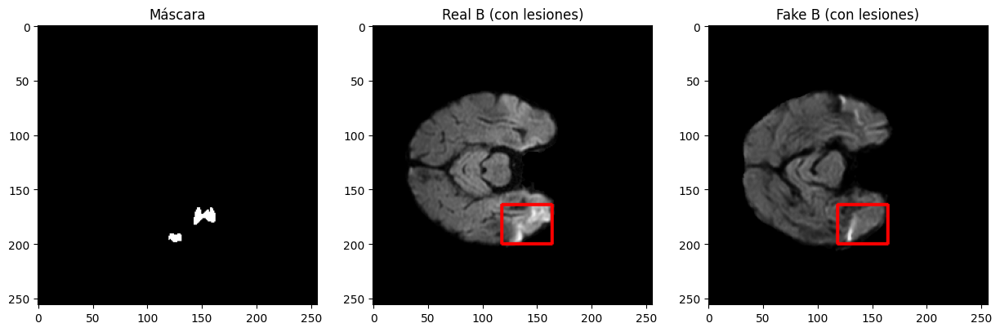

Paciente: 031, Slice 10 - SSIM: 0.432, PSNR: 13.746, MS-SSIM: 0.331


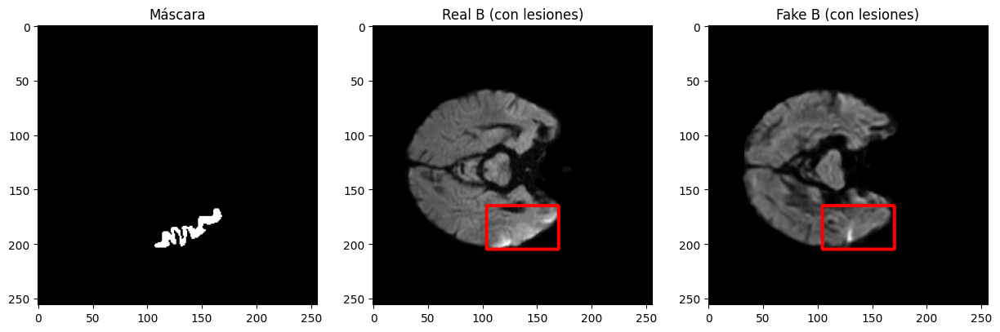

Paciente: 031, Slice 11 - SSIM: 0.337, PSNR: 12.967, MS-SSIM: 0.233


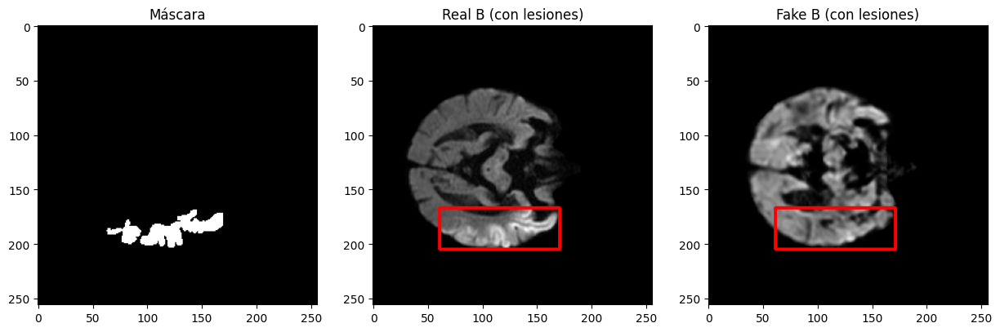

Paciente: 031, Slice 12 - SSIM: 0.352, PSNR: 12.645, MS-SSIM: 0.344


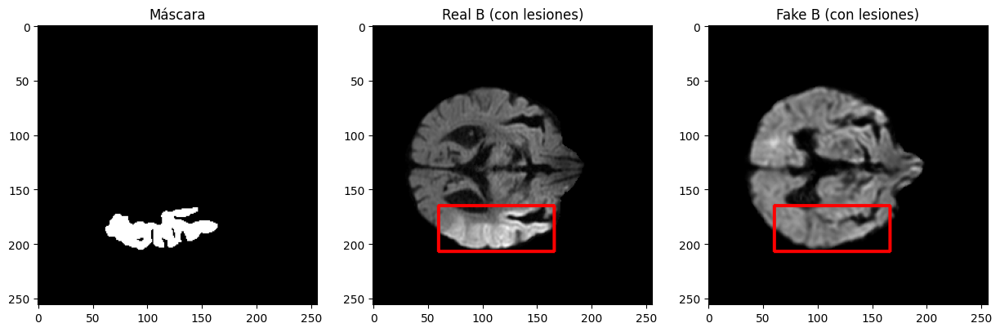

Paciente: 031, Slice 13 - SSIM: 0.378, PSNR: 12.659, MS-SSIM: 0.345


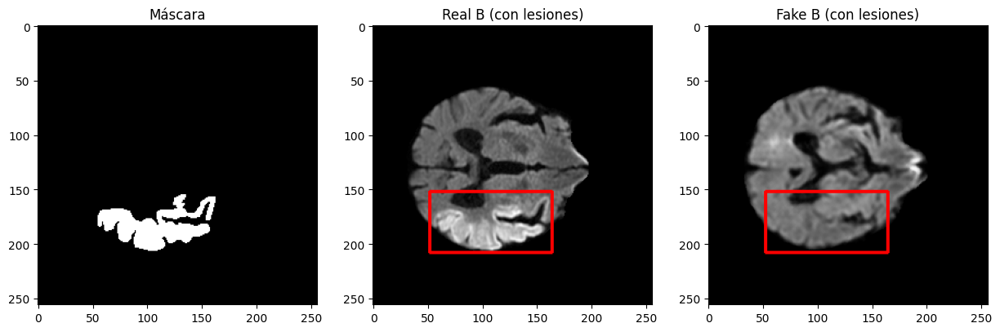

Paciente: 031, Slice 14 - SSIM: 0.347, PSNR: 13.812, MS-SSIM: 0.286


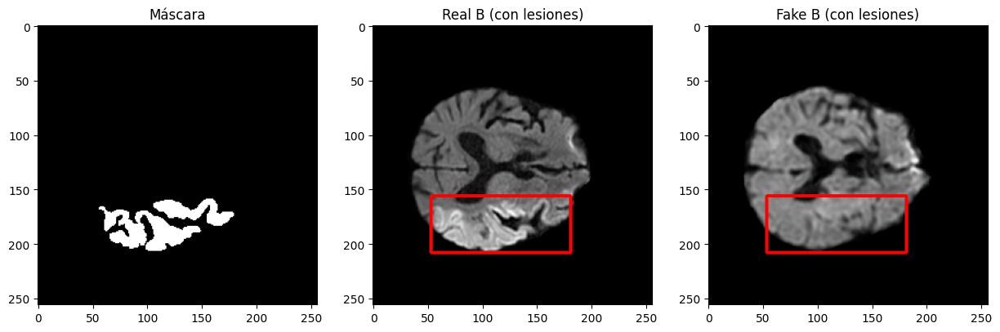

Paciente: 031, Slice 15 - SSIM: 0.386, PSNR: 14.958, MS-SSIM: 0.332


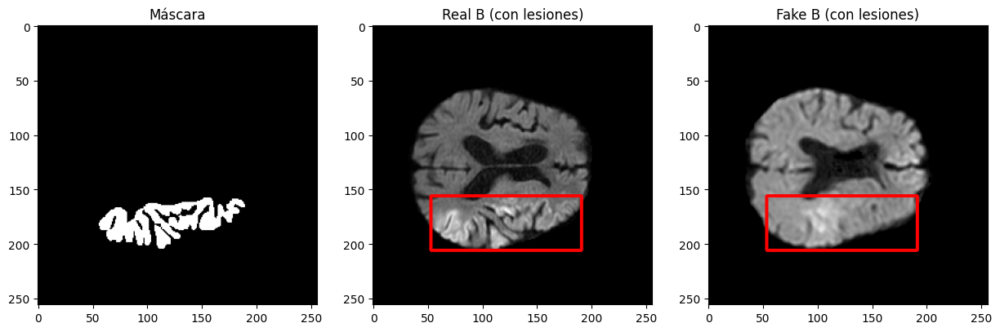

Paciente: 031, Slice 16 - SSIM: 0.380, PSNR: 17.321, MS-SSIM: 0.315


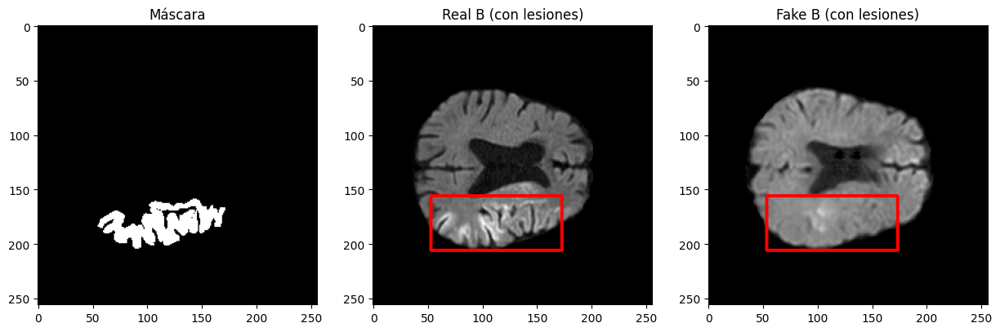

Paciente: 031, Slice 17 - SSIM: 0.455, PSNR: 17.445, MS-SSIM: 0.434


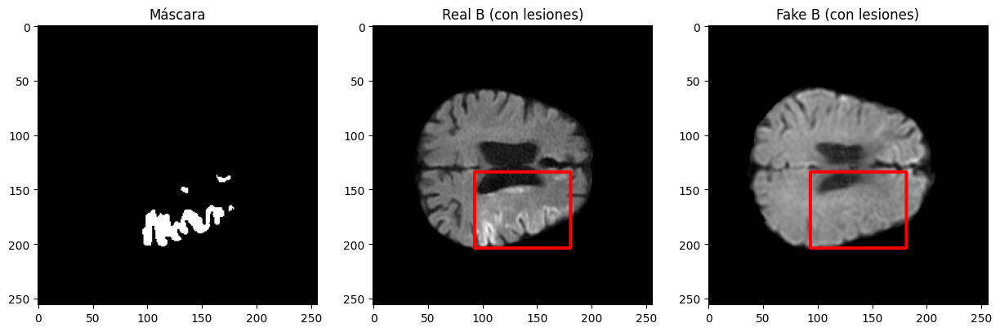

Paciente: 031, Slice 18 - SSIM: 0.393, PSNR: 13.103, MS-SSIM: 0.400


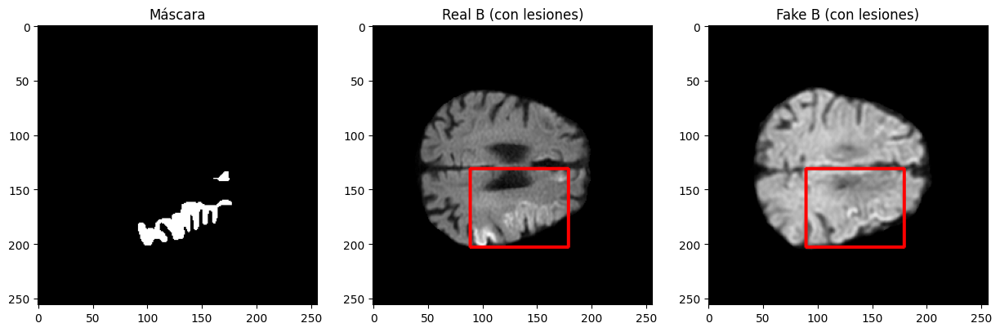

Paciente: 031, Slice 19 - SSIM: 0.397, PSNR: 15.851, MS-SSIM: 0.346


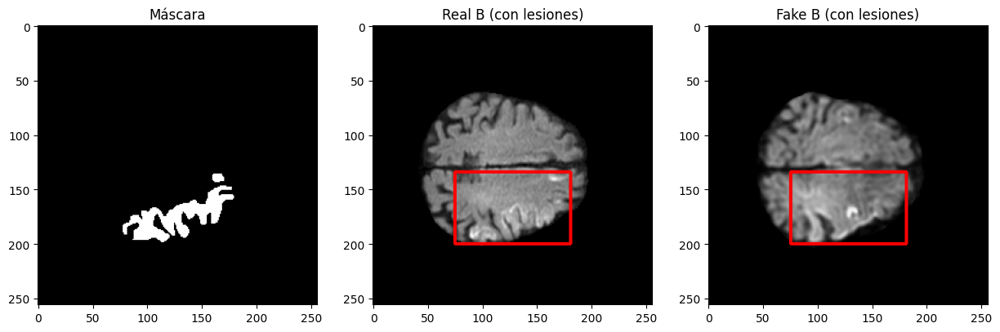

Paciente: 031, Slice 20 - SSIM: 0.357, PSNR: 15.709, MS-SSIM: 0.245


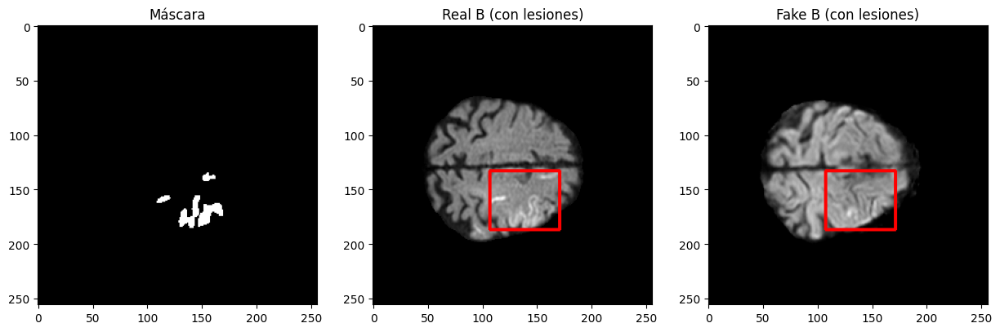

Paciente: 031, Slice 21 - SSIM: 0.298, PSNR: 13.917, MS-SSIM: 0.228


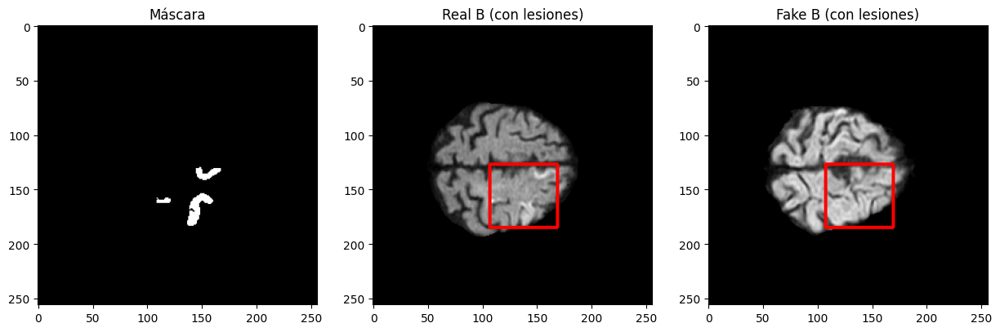

Promedio SSIM del paciente 031: 0.383
Promedio PSNR del paciente 031: 14.335
Promedio MS-SSIM del paciente 031: 0.327
Real_B ID: 032, Fake_B ID: 032, Masks ID: 032
Paciente: 032, Slice 10 - SSIM: 0.722, PSNR: 17.077, MS-SSIM: 0.580


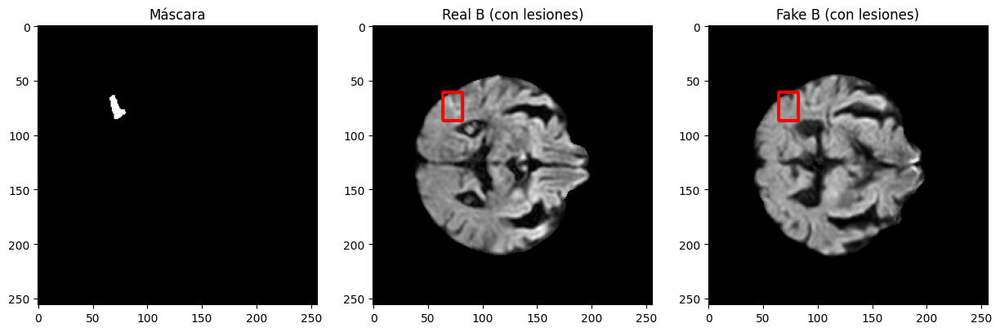

Paciente: 032, Slice 11 - SSIM: 0.520, PSNR: 9.505, MS-SSIM: 0.557


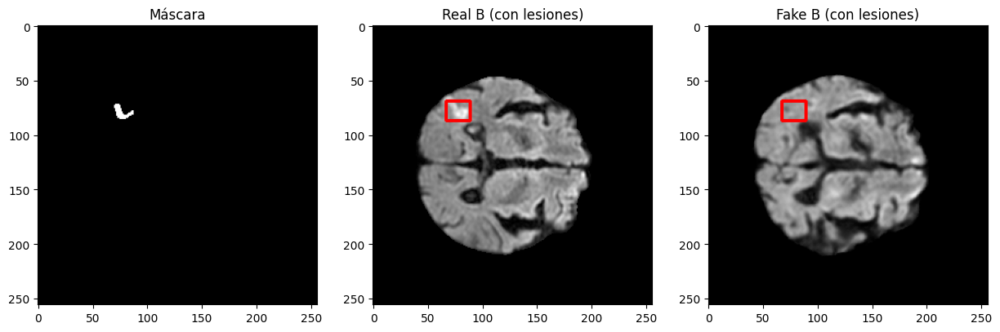

Paciente: 032, Slice 12 - SSIM: 0.319, PSNR: 7.954, MS-SSIM: 0.403


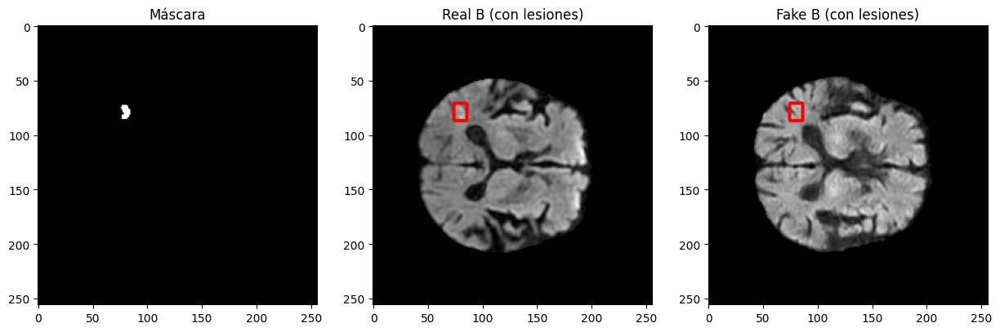

Paciente: 032, Slice 14 - SSIM: 0.583, PSNR: 11.353, MS-SSIM: 0.424


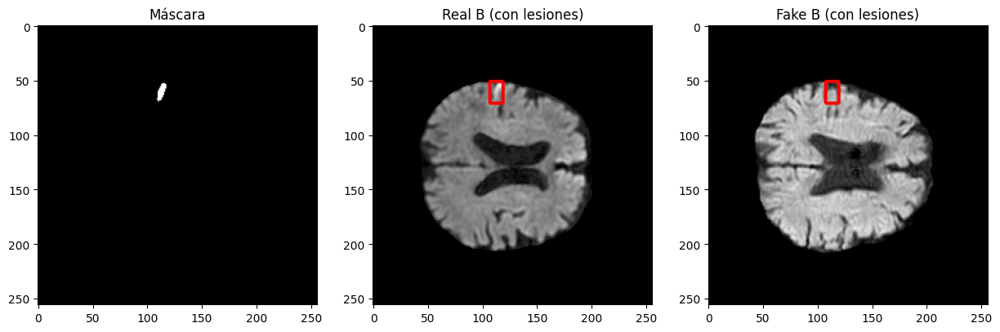

Paciente: 032, Slice 15 - SSIM: 0.474, PSNR: 15.864, MS-SSIM: 0.530


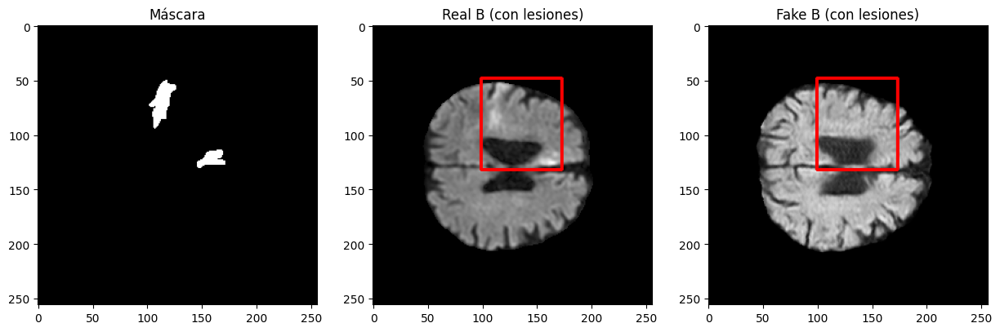

Paciente: 032, Slice 16 - SSIM: 0.447, PSNR: 14.317, MS-SSIM: 0.494


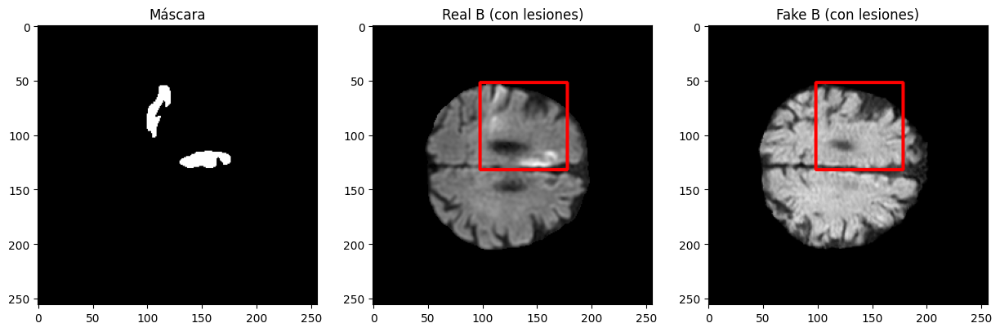

Paciente: 032, Slice 17 - SSIM: 0.389, PSNR: 13.690, MS-SSIM: 0.353


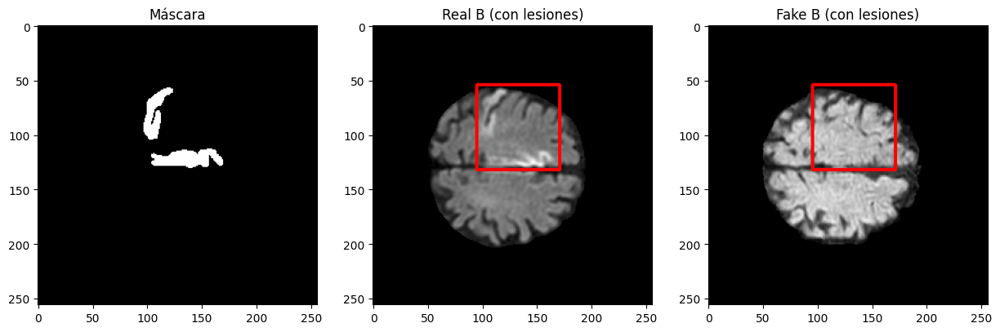

Paciente: 032, Slice 18 - SSIM: 0.330, PSNR: 13.658, MS-SSIM: 0.335


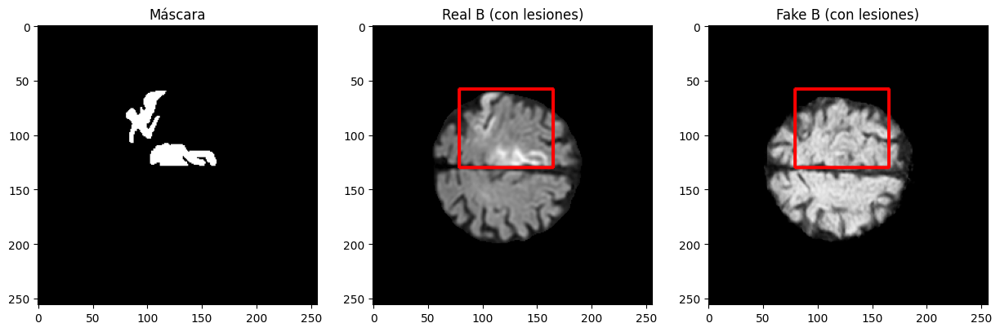

Paciente: 032, Slice 19 - SSIM: 0.292, PSNR: 14.084, MS-SSIM: 0.312


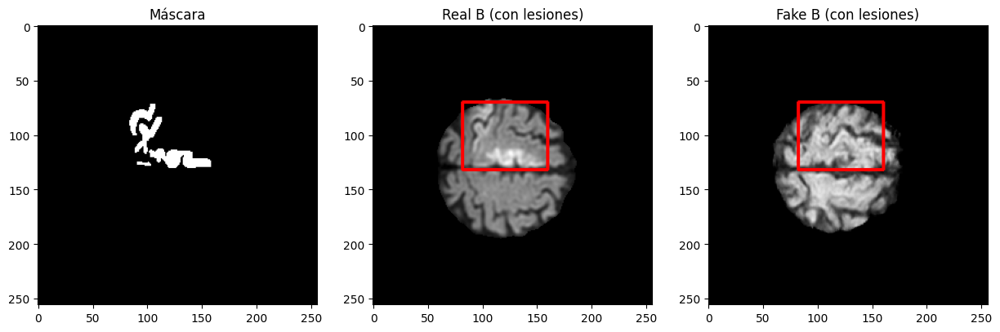

Paciente: 032, Slice 20 - SSIM: 0.248, PSNR: 13.079, MS-SSIM: 0.249


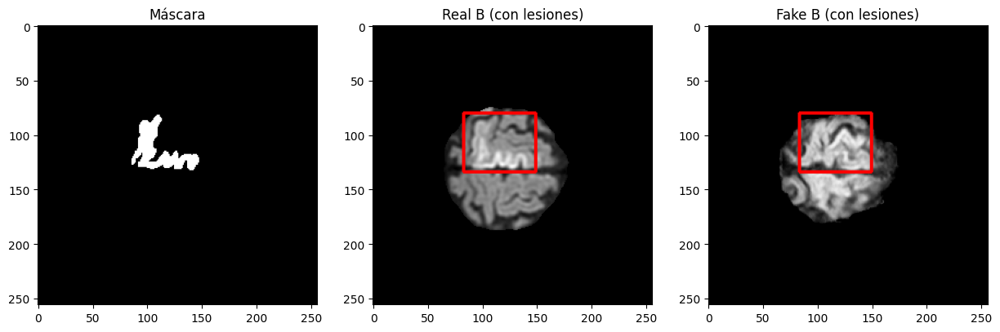

Paciente: 032, Slice 21 - SSIM: 0.206, PSNR: 10.745, MS-SSIM: 0.131


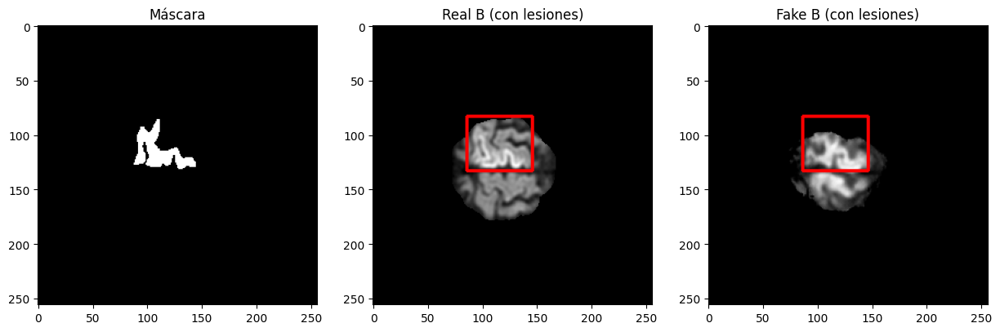

Paciente: 032, Slice 22 - SSIM: 0.178, PSNR: 7.240, MS-SSIM: 0.052


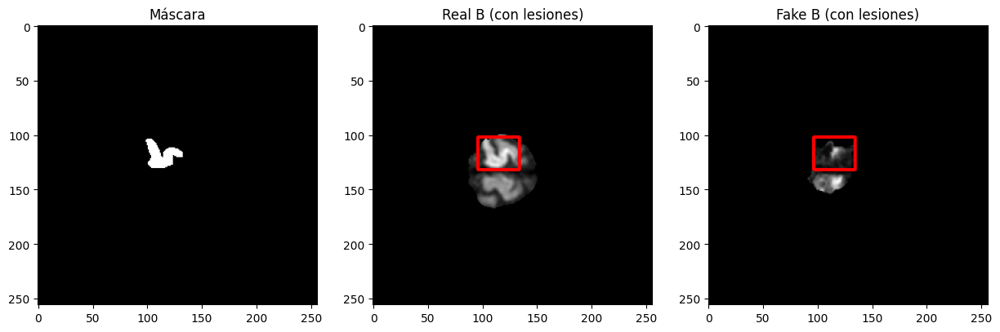

Promedio SSIM del paciente 032: 0.392
Promedio PSNR del paciente 032: 12.380
Promedio MS-SSIM del paciente 032: 0.368
Real_B ID: 033, Fake_B ID: 033, Masks ID: 033
Paciente: 033, Slice 17 - SSIM: 0.692, PSNR: 12.313, MS-SSIM: 0.541


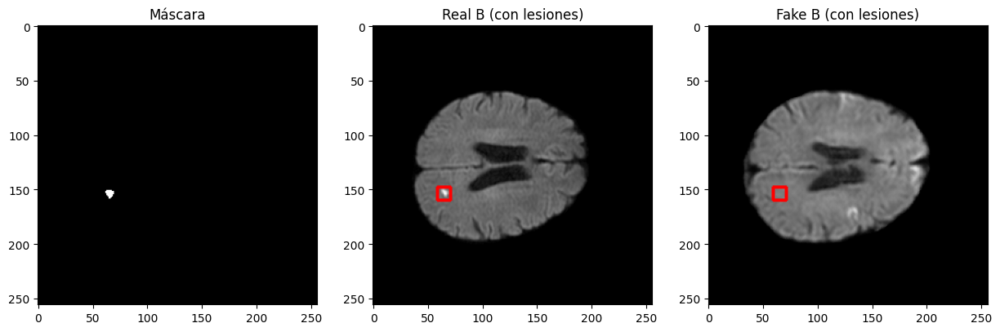

Promedio SSIM del paciente 033: 0.692
Promedio PSNR del paciente 033: 12.313
Promedio MS-SSIM del paciente 033: 0.541
Real_B ID: 034, Fake_B ID: 034, Masks ID: 034
Paciente: 034, Slice 10 - SSIM: 0.433, PSNR: 12.233, MS-SSIM: 0.422


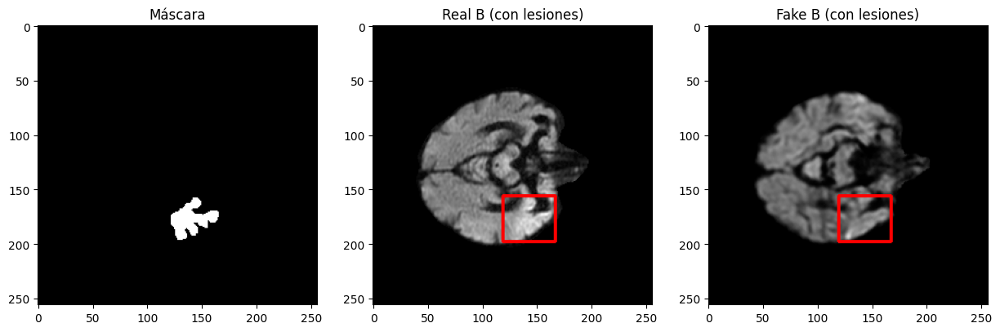

Paciente: 034, Slice 11 - SSIM: 0.318, PSNR: 13.300, MS-SSIM: 0.340


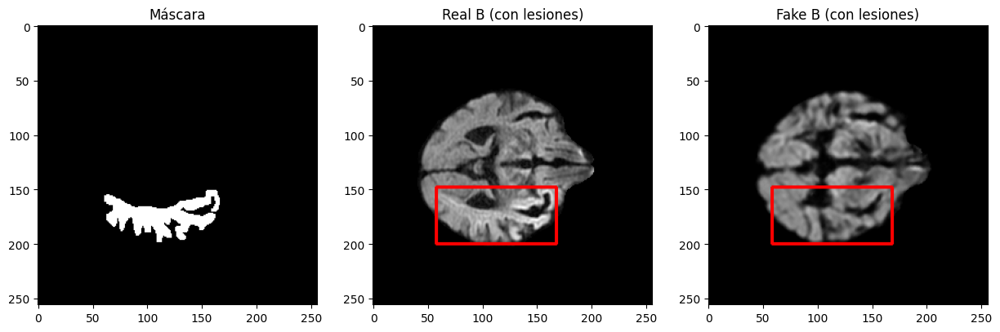

Paciente: 034, Slice 12 - SSIM: 0.437, PSNR: 16.734, MS-SSIM: 0.470


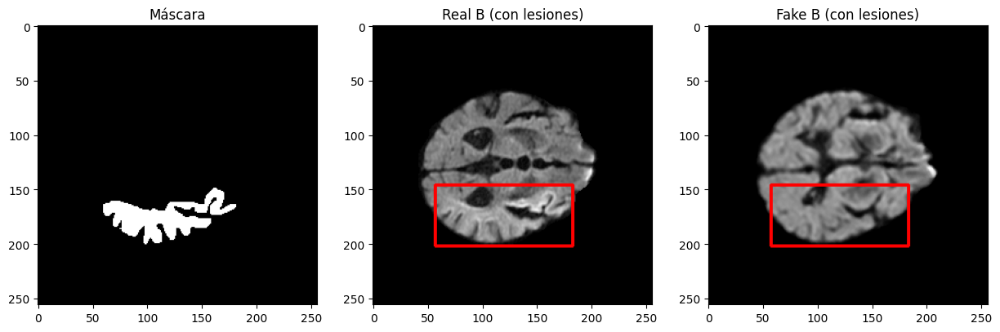

Paciente: 034, Slice 13 - SSIM: 0.367, PSNR: 15.455, MS-SSIM: 0.353


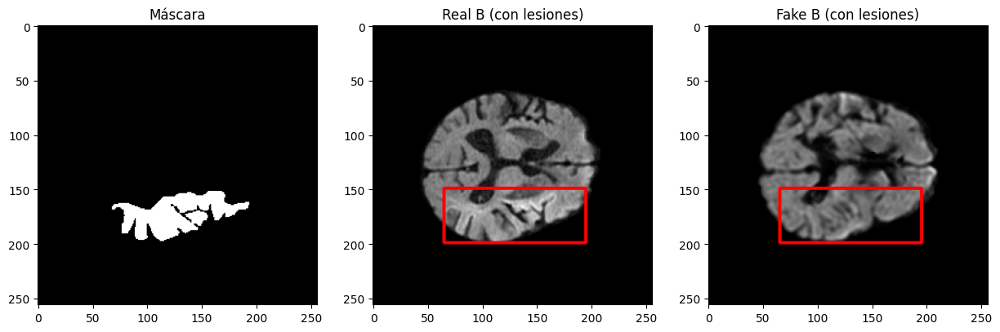

Paciente: 034, Slice 14 - SSIM: 0.326, PSNR: 10.500, MS-SSIM: 0.306


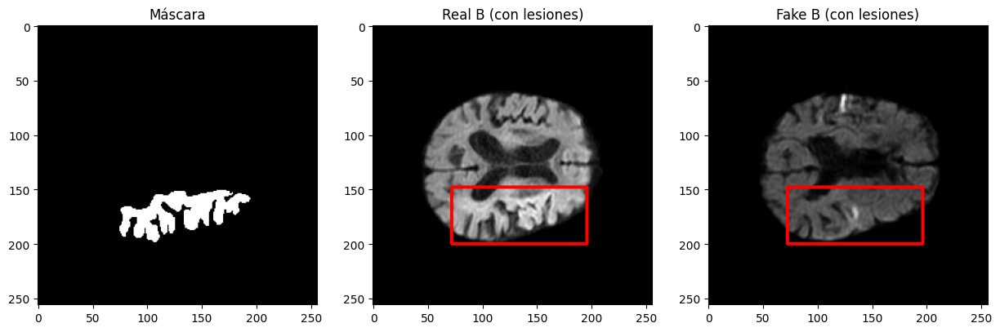

Paciente: 034, Slice 15 - SSIM: 0.401, PSNR: 11.987, MS-SSIM: 0.365


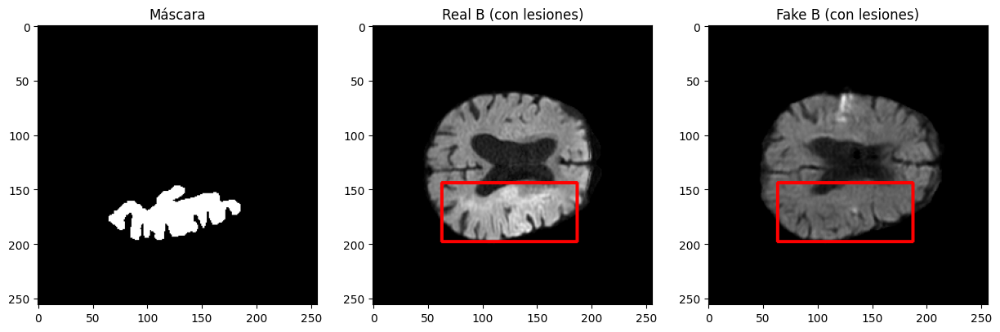

Paciente: 034, Slice 16 - SSIM: 0.386, PSNR: 11.341, MS-SSIM: 0.305


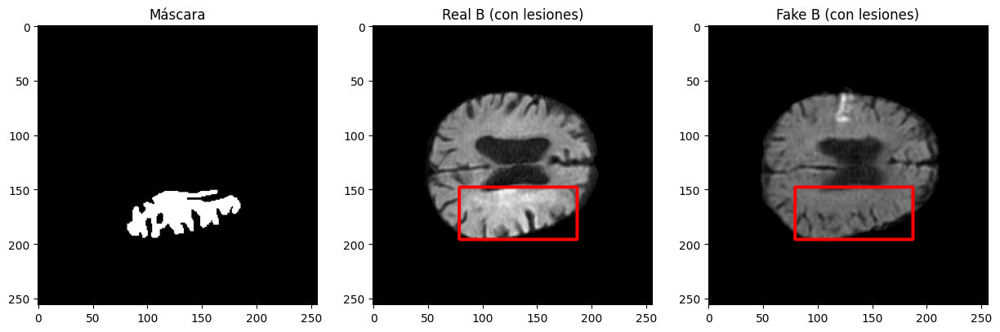

Paciente: 034, Slice 17 - SSIM: 0.449, PSNR: 12.079, MS-SSIM: 0.408


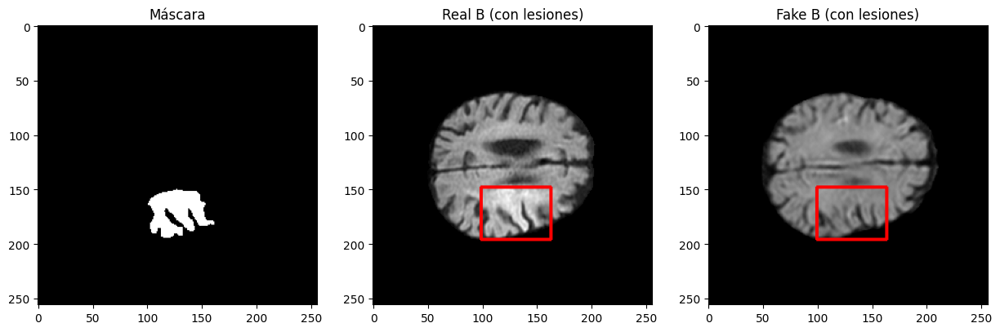

Paciente: 034, Slice 18 - SSIM: 0.381, PSNR: 12.663, MS-SSIM: 0.290


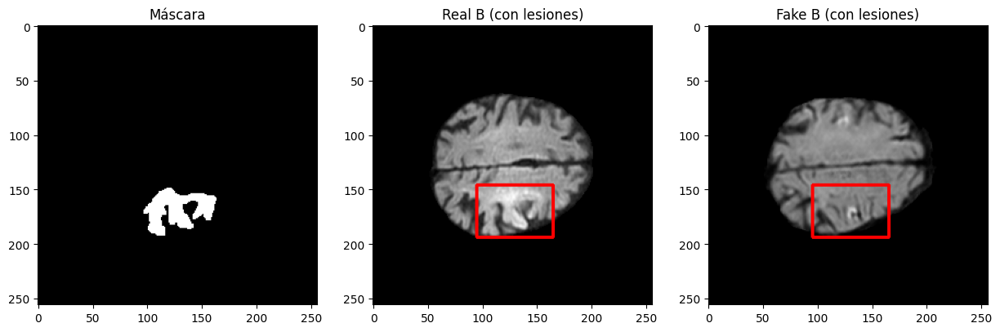

Paciente: 034, Slice 19 - SSIM: 0.387, PSNR: 10.549, MS-SSIM: 0.283


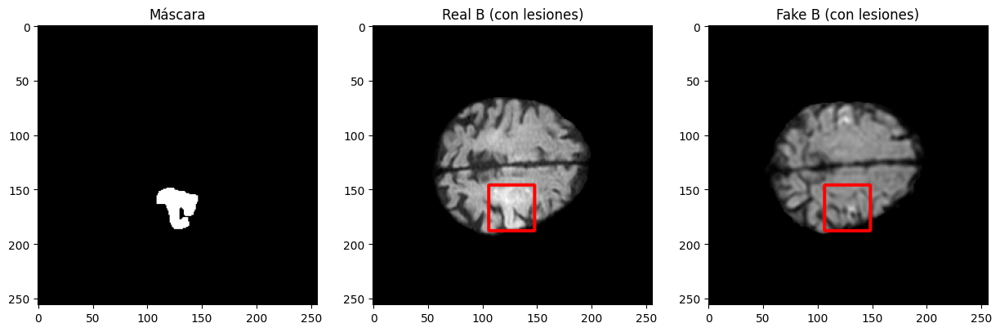

Paciente: 034, Slice 20 - SSIM: 0.303, PSNR: 10.285, MS-SSIM: 0.241


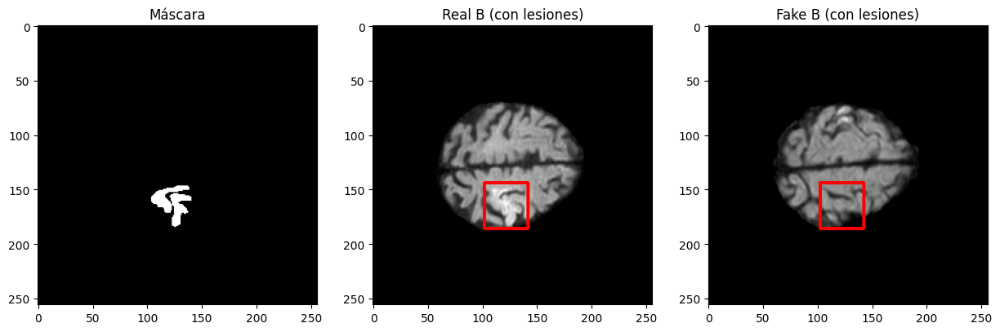

Paciente: 034, Slice 21 - SSIM: 0.209, PSNR: 8.772, MS-SSIM: 0.196


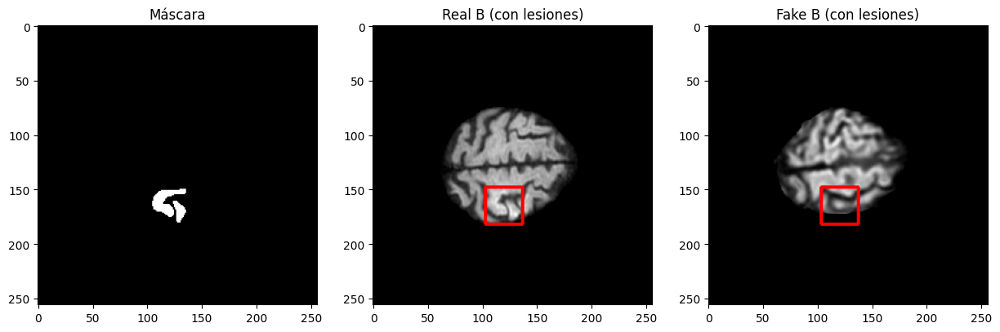

Paciente: 034, Slice 22 - SSIM: 0.097, PSNR: 4.095, MS-SSIM: 0.177


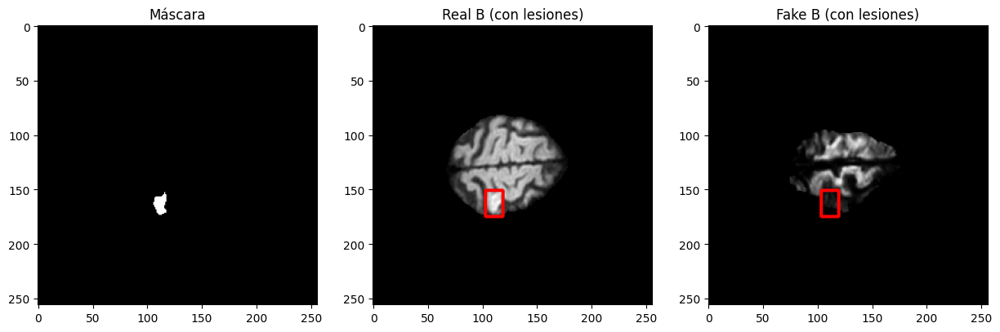

Promedio SSIM del paciente 034: 0.346
Promedio PSNR del paciente 034: 11.538
Promedio MS-SSIM del paciente 034: 0.320
Real_B ID: 035, Fake_B ID: 035, Masks ID: 035
Paciente: 035, Slice 3 - SSIM: 0.823, PSNR: 11.191, MS-SSIM: 0.810


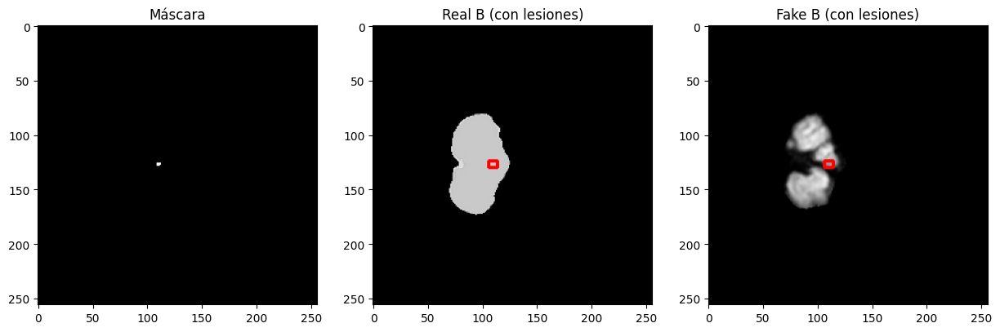

Promedio SSIM del paciente 035: 0.823
Promedio PSNR del paciente 035: 11.191
Promedio MS-SSIM del paciente 035: 0.810
Real_B ID: 036, Fake_B ID: 036, Masks ID: 036
Paciente: 036, Slice 8 - SSIM: 0.542, PSNR: 12.569, MS-SSIM: 0.438


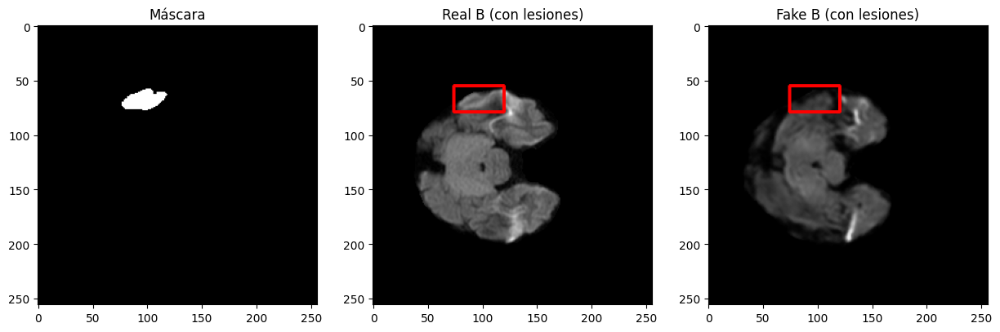

Paciente: 036, Slice 9 - SSIM: 0.538, PSNR: 15.623, MS-SSIM: 0.423


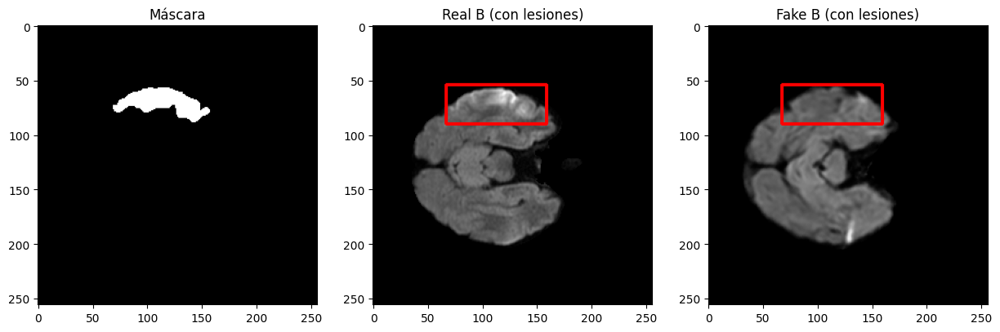

Paciente: 036, Slice 10 - SSIM: 0.500, PSNR: 14.969, MS-SSIM: 0.395


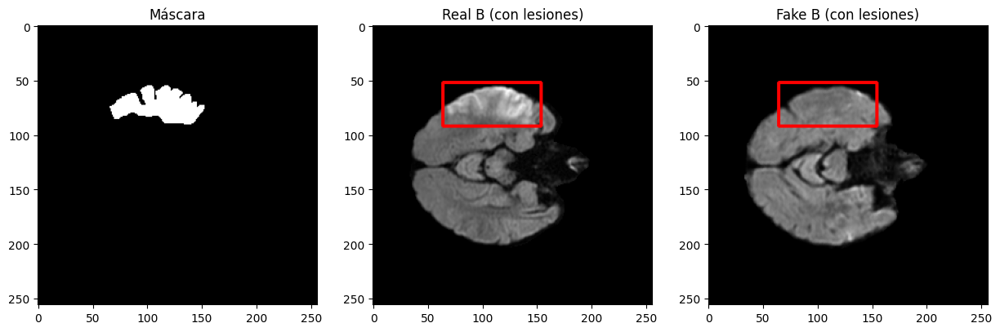

Paciente: 036, Slice 11 - SSIM: 0.481, PSNR: 13.611, MS-SSIM: 0.356


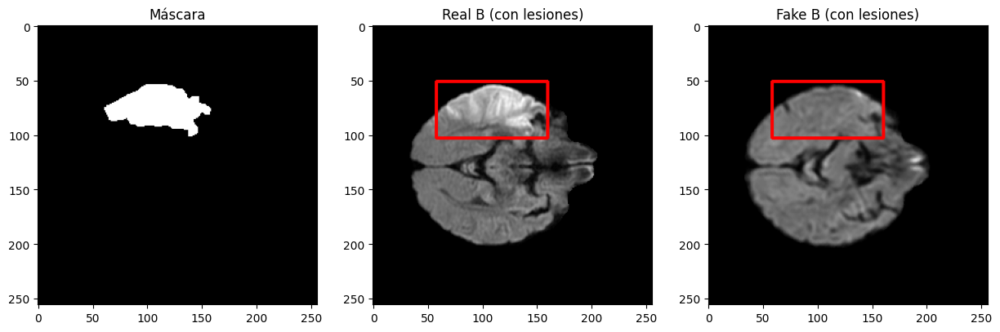

Paciente: 036, Slice 12 - SSIM: 0.416, PSNR: 14.342, MS-SSIM: 0.320


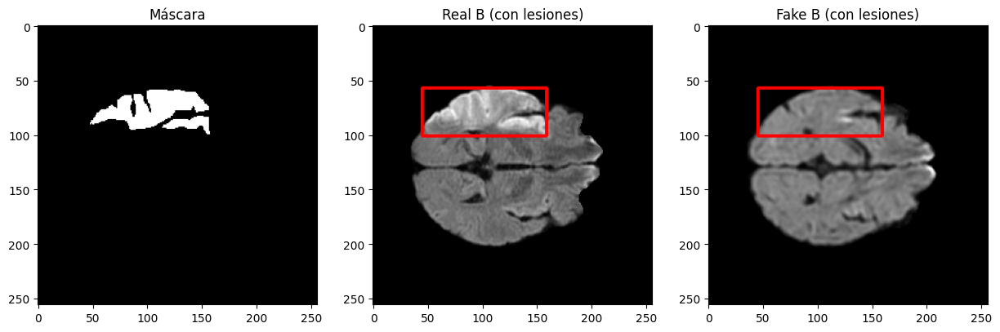

Paciente: 036, Slice 13 - SSIM: 0.415, PSNR: 15.584, MS-SSIM: 0.360


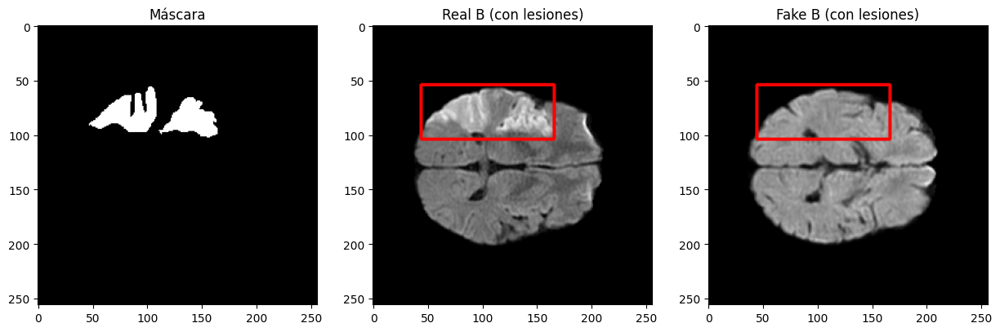

Paciente: 036, Slice 14 - SSIM: 0.392, PSNR: 15.384, MS-SSIM: 0.310


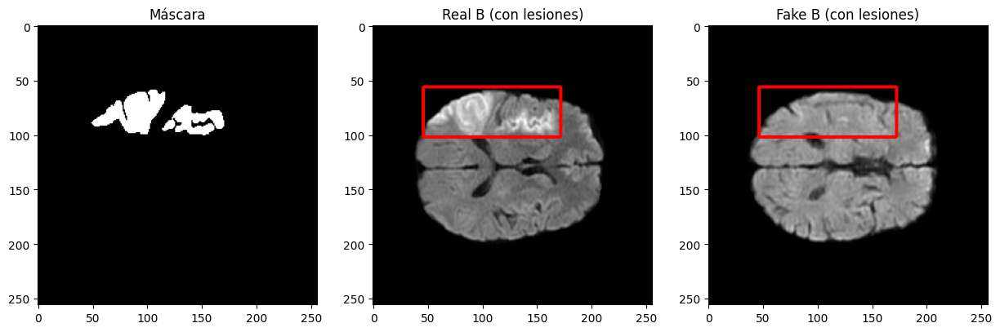

Paciente: 036, Slice 15 - SSIM: 0.418, PSNR: 16.142, MS-SSIM: 0.342


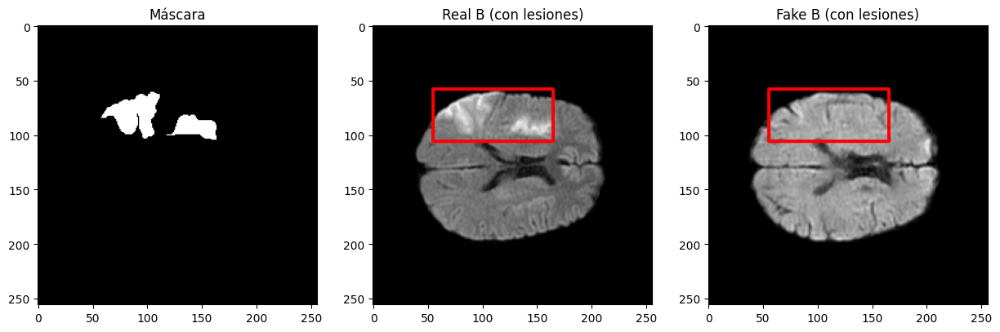

Paciente: 036, Slice 16 - SSIM: 0.421, PSNR: 15.283, MS-SSIM: 0.376


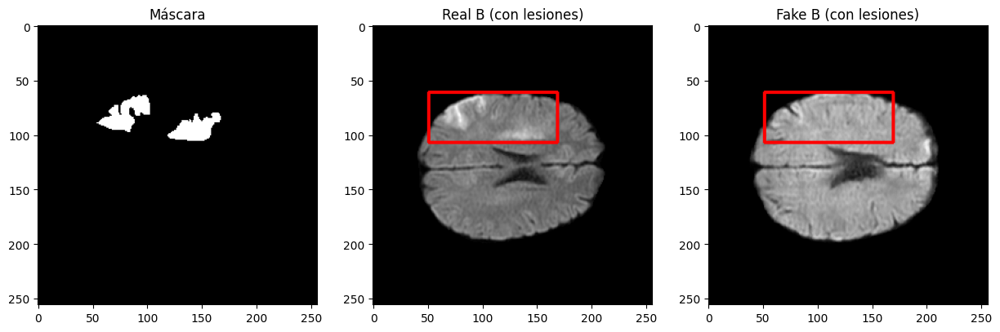

Paciente: 036, Slice 17 - SSIM: 0.473, PSNR: 15.011, MS-SSIM: 0.438


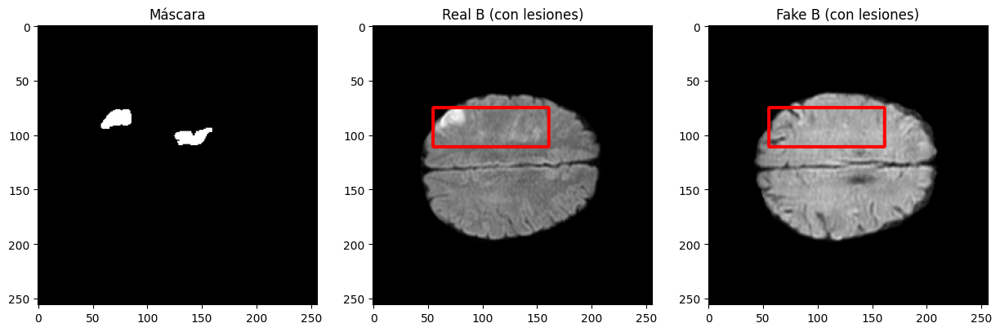

Paciente: 036, Slice 18 - SSIM: 0.505, PSNR: 20.345, MS-SSIM: 0.455


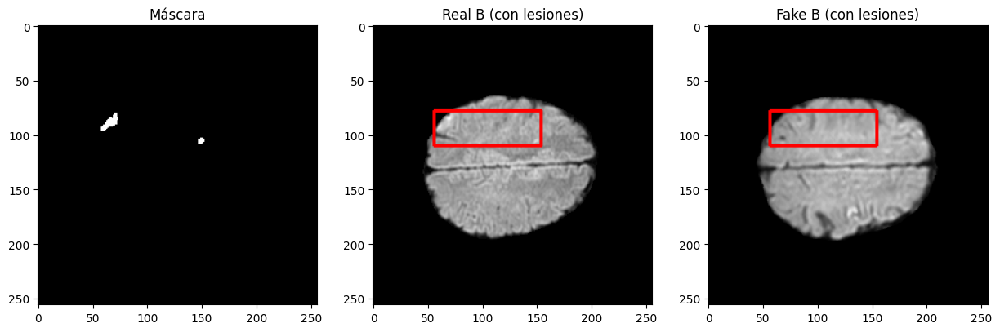

Promedio SSIM del paciente 036: 0.464
Promedio PSNR del paciente 036: 15.351
Promedio MS-SSIM del paciente 036: 0.383
Real_B ID: 037, Fake_B ID: 037, Masks ID: 037
Paciente: 037, Slice 10 - SSIM: 0.445, PSNR: 13.522, MS-SSIM: 0.425


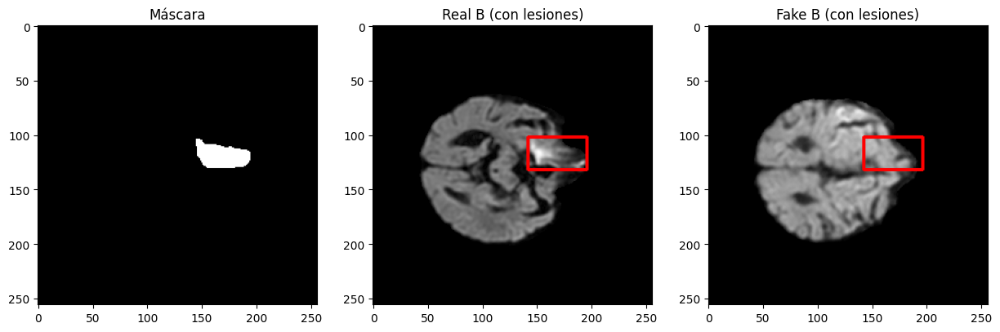

Paciente: 037, Slice 11 - SSIM: 0.348, PSNR: 14.484, MS-SSIM: 0.370


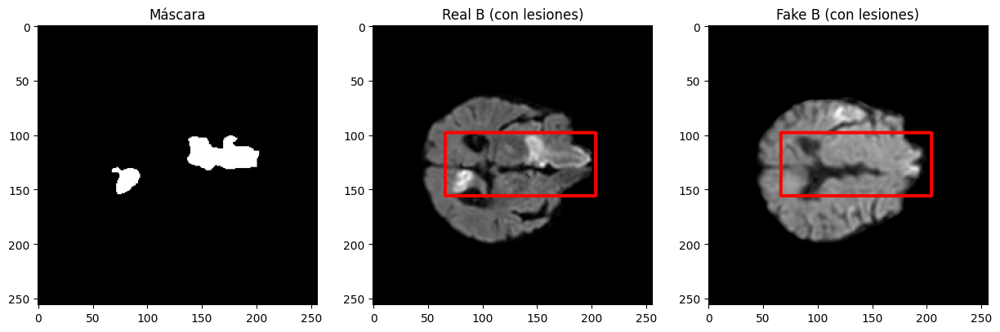

Paciente: 037, Slice 12 - SSIM: 0.342, PSNR: 14.739, MS-SSIM: 0.402


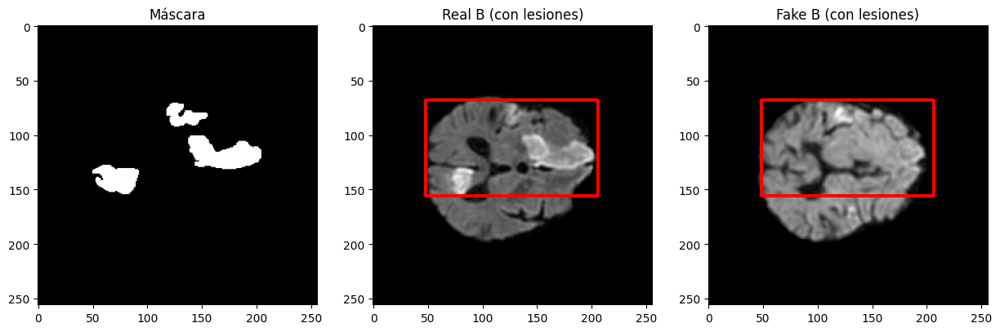

Paciente: 037, Slice 13 - SSIM: 0.383, PSNR: 16.229, MS-SSIM: 0.441


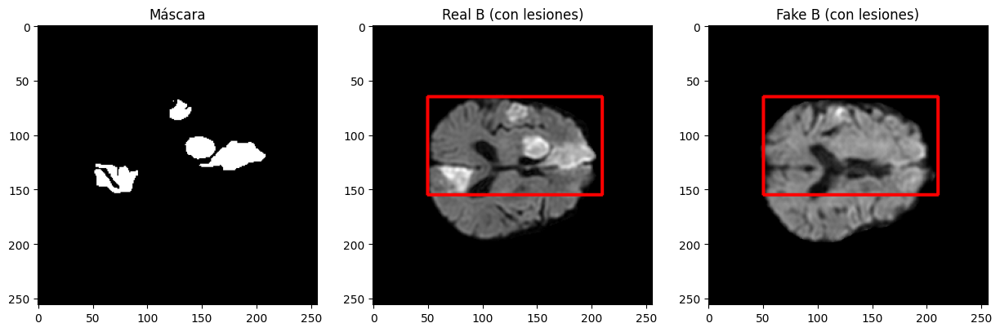

Paciente: 037, Slice 14 - SSIM: 0.407, PSNR: 16.096, MS-SSIM: 0.436


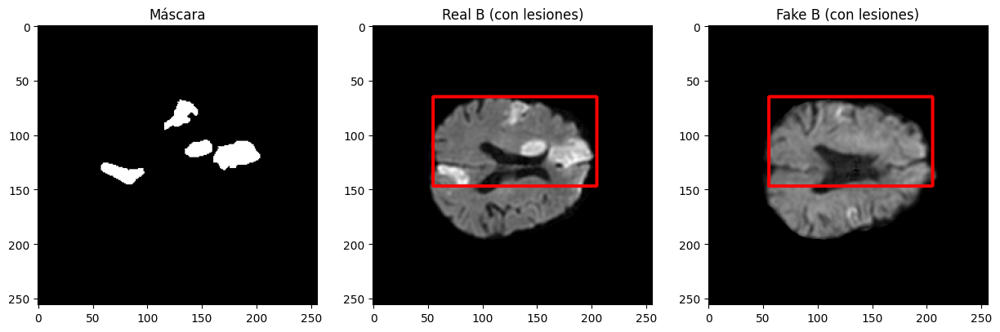

Paciente: 037, Slice 15 - SSIM: 0.359, PSNR: 15.690, MS-SSIM: 0.383


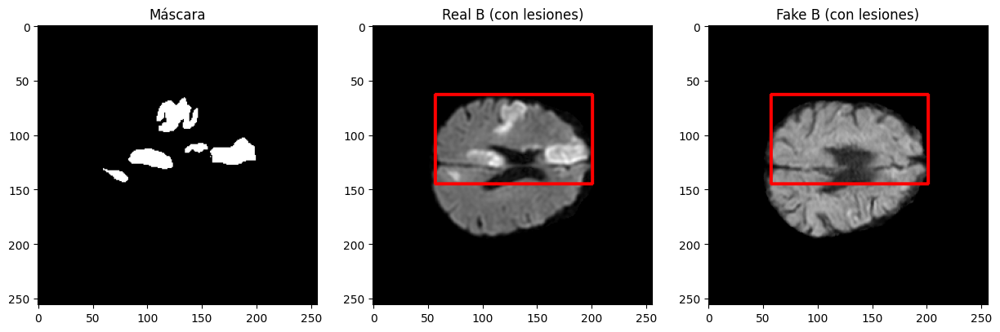

Paciente: 037, Slice 16 - SSIM: 0.290, PSNR: 13.312, MS-SSIM: 0.293


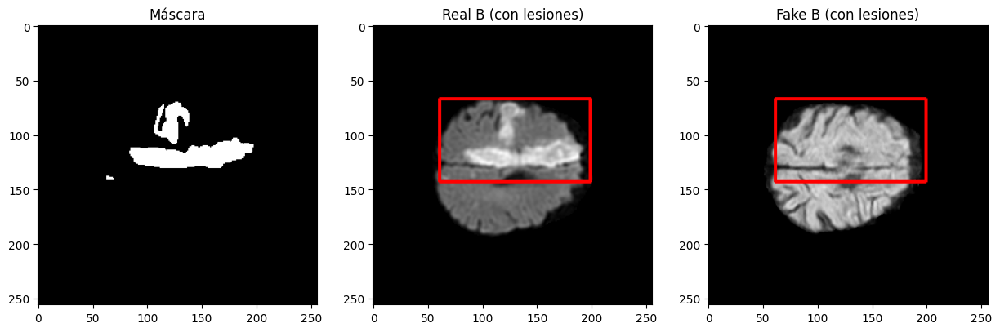

Paciente: 037, Slice 17 - SSIM: 0.296, PSNR: 14.007, MS-SSIM: 0.246


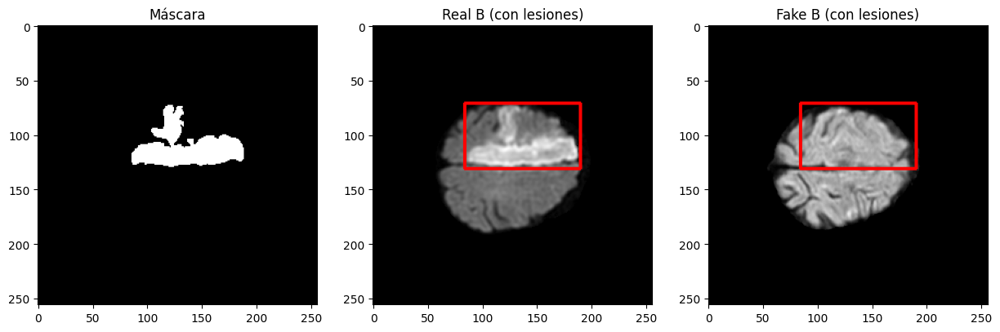

Paciente: 037, Slice 18 - SSIM: 0.261, PSNR: 13.013, MS-SSIM: 0.234


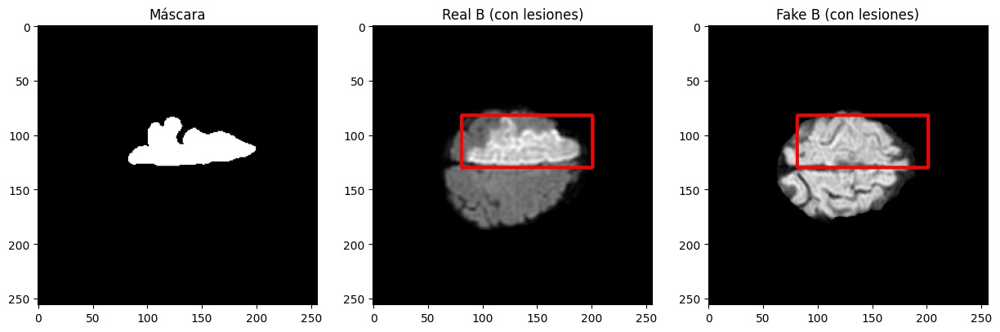

Paciente: 037, Slice 19 - SSIM: 0.319, PSNR: 12.346, MS-SSIM: 0.257


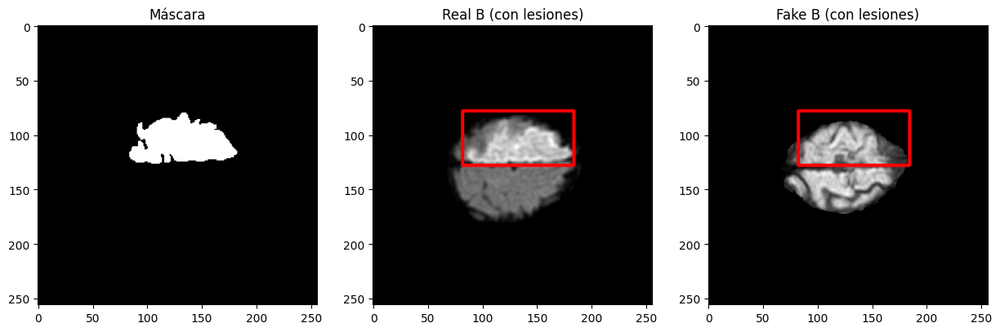

Paciente: 037, Slice 20 - SSIM: 0.323, PSNR: 8.528, MS-SSIM: 0.260


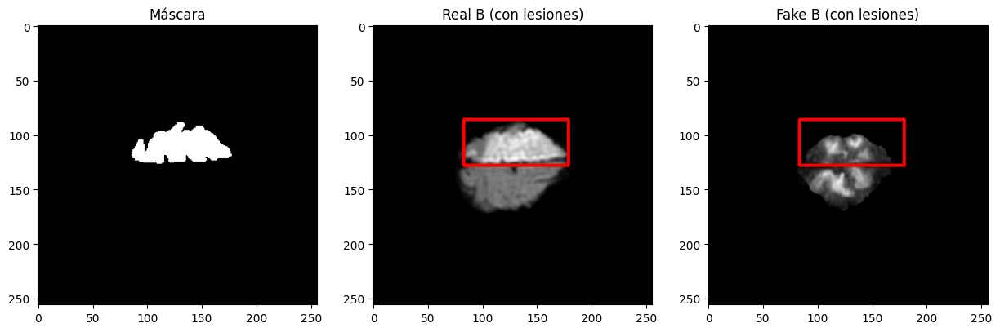

Paciente: 037, Slice 21 - SSIM: 0.321, PSNR: 7.609, MS-SSIM: 0.206


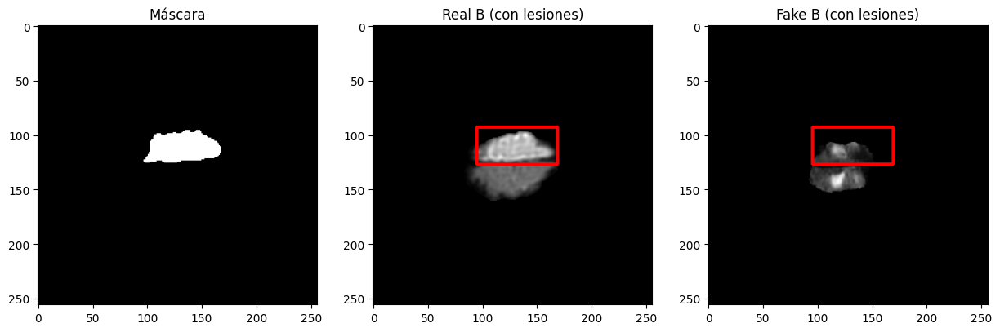

Paciente: 037, Slice 22 - SSIM: 0.168, PSNR: 5.481, MS-SSIM: 0.088


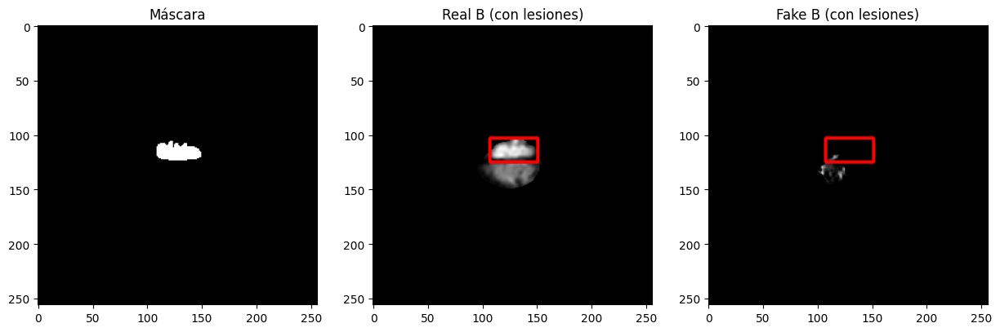

Promedio SSIM del paciente 037: 0.328
Promedio PSNR del paciente 037: 12.697
Promedio MS-SSIM del paciente 037: 0.311

SSIM Promedio por Paciente (Lesiones): 0.535, Desviación Estándar SSIM por Paciente (Lesiones): 0.123
PSNR Promedio por Paciente (Lesiones): 11.650, Desviación Estándar PSNR por Paciente (Lesiones): 2.318
MS-SSIM Promedio por Paciente (Lesiones): 0.479, Desviación Estándar MS-SSIM por Paciente (Lesiones): 0.160


In [23]:
# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))
carpetas_pacientes_masks = sorted(Path(ruta_masks).glob("*"))

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure(data_range=1.0, kernel_size=5, betas=(0.1, 0.3, 0.5))
ssim_values_por_paciente = []
psnr_values_por_paciente = []
ms_ssim_values_por_paciente = []

for carpeta_paciente_real_B, carpeta_paciente_fake_B, carpeta_paciente_masks in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B, carpetas_pacientes_masks):
    id_paciente_real_B = carpeta_paciente_real_B.stem
    id_paciente_fake_B = carpeta_paciente_fake_B.stem
    id_paciente_masks = carpeta_paciente_masks.stem
    
    # Imprimir los IDs para depuración
    print(f"Real_B ID: {id_paciente_real_B}, Fake_B ID: {id_paciente_fake_B}, Masks ID: {id_paciente_masks}")

    # Asegurarnos de que los IDs de los pacientes coincidan
    assert id_paciente_real_B == id_paciente_fake_B == id_paciente_masks, "Los IDs de los pacientes no coinciden"

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))
    archivos_masks = sorted(carpeta_paciente_masks.glob("*.png"))

    imagenes_real_B = [Image.open(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [Image.open(str(f)) for f in archivos_fake_B]
    imagenes_masks = [plt.imread(str(f)) for f in archivos_masks]

    # Verificar que todas las imágenes tengan el tamaño esperado
    for i, img in enumerate(imagenes_real_B):
        assert img.size == (256, 256), f"Image {i} in real_B has size {img.size}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.size == (256, 256), f"Image {i} in fake_B has size {img.size}"
    for i, img in enumerate(imagenes_masks):
        assert img.shape == (256, 256), f"Image {i} in masks has shape {img.shape}"

    ssim_values_lesion_paciente = []
    psnr_values_lesion_paciente = []
    ms_ssim_values_lesion_paciente = []

    tiene_lesiones = False

    for idx, (img_real_B, img_fake_B, img_mask) in enumerate(zip(imagenes_real_B, imagenes_fake_B, imagenes_masks)):
        if np.any(img_mask):  # Si hay alguna lesión en la máscara
            tiene_lesiones = True
            lesion_coords = np.where(img_mask)  # Coordenadas de las lesiones
            y_min, y_max = lesion_coords[0].min(), lesion_coords[0].max()
            x_min, x_max = lesion_coords[1].min(), lesion_coords[1].max()

            # Asegurar que el tamaño mínimo del recorte sea suficientemente grande para contexto
            min_context = 5  # Tamaño mínimo del contexto
            y_size = max(y_max - y_min + min_context, min_context)
            x_size = max(x_max - x_min + min_context, min_context)

            # Calcular el centro y las coordenadas del rectángulo
            y_center = (y_min + y_max) // 2
            x_center = (x_min + x_max) // 2
            y_start = max(0, y_center - y_size // 2)
            y_end = min(img_real_B.size[1], y_center + y_size // 2)
            x_start = max(0, x_center - x_size // 2)
            x_end = min(img_real_B.size[0], x_center + x_size // 2)

            # Extraer las regiones de interés
            real_lesion_region = img_real_B.crop((x_start, y_start, x_end, y_end))
            fake_lesion_region = img_fake_B.crop((x_start, y_start, x_end, y_end))

            # Redimensionar las regiones para que sean compatibles con MS-SSIM
            real_lesion_region_resized = real_lesion_region.resize((160, 160), Image.BICUBIC)
            fake_lesion_region_resized = fake_lesion_region.resize((160, 160), Image.BICUBIC)

            # Convertir las imágenes a tensores
            real_lesion_tensor = to_tensor(real_lesion_region_resized).unsqueeze(0)
            fake_lesion_tensor = to_tensor(fake_lesion_region_resized).unsqueeze(0)

            # Calcular MS-SSIM
            ms_ssim_value = ms_ssim(fake_lesion_tensor, real_lesion_tensor)
            ms_ssim_values_lesion_paciente.append(ms_ssim_value.item())

            # Calcular SSIM y PSNR usando las regiones redimensionadas
            real_lesion_array = np.array(real_lesion_region_resized)
            fake_lesion_array = np.array(fake_lesion_region_resized)
            ssim_value = ssim(real_lesion_array, fake_lesion_array, data_range=real_lesion_array.max() - real_lesion_array.min())
            psnr_value = psnr(real_lesion_array, fake_lesion_array, data_range=real_lesion_array.max() - real_lesion_array.min())
            if not np.isnan(ssim_value):
                ssim_values_lesion_paciente.append(ssim_value)
            if not np.isnan(psnr_value):
                psnr_values_lesion_paciente.append(psnr_value)

            # Imprimir información del slice
            print(f"Paciente: {id_paciente_real_B}, Slice {idx} - SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}, MS-SSIM: {ms_ssim_value.item():.3f}")

            # Visualización de las regiones de interés
            img_real_B_colored = cv2.cvtColor(np.array(img_real_B), cv2.COLOR_GRAY2RGB)
            img_fake_B_colored = cv2.cvtColor(np.array(img_fake_B), cv2.COLOR_GRAY2RGB)
            
            cv2.rectangle(img_real_B_colored, (x_start, y_start), (x_end, y_end), (255, 0, 0), 2)
            cv2.rectangle(img_fake_B_colored, (x_start, y_start), (x_end, y_end), (255, 0, 0), 2)

            fig, ax = plt.subplots(1, 3, figsize=(15, 5))
            ax[0].imshow(img_mask, cmap='gray')
            ax[0].set_title("Máscara")
            ax[1].imshow(img_real_B_colored)
            ax[1].set_title("Real B (con lesiones)")
            ax[2].imshow(img_fake_B_colored)
            ax[2].set_title("Fake B (con lesiones)")
            plt.show()

    if tiene_lesiones and ssim_values_lesion_paciente and psnr_values_lesion_paciente:  # Solo si el paciente tiene lesiones
        promedio_ssim_paciente = np.mean(ssim_values_lesion_paciente)
        promedio_psnr_paciente = np.mean(psnr_values_lesion_paciente)
        promedio_ms_ssim_paciente = np.mean(ms_ssim_values_lesion_paciente)
        ssim_values_por_paciente.append(promedio_ssim_paciente)
        psnr_values_por_paciente.append(promedio_psnr_paciente)
        ms_ssim_values_por_paciente.append(promedio_ms_ssim_paciente)
        print(f"Promedio SSIM del paciente {id_paciente_real_B}: {promedio_ssim_paciente:.3f}")
        print(f"Promedio PSNR del paciente {id_paciente_real_B}: {promedio_psnr_paciente:.3f}")
        print(f"Promedio MS-SSIM del paciente {id_paciente_real_B}: {promedio_ms_ssim_paciente:.3f}")

# Calcular el promedio general de SSIM, PSNR y MS-SSIM considerando solo los pacientes con lesiones
if ssim_values_por_paciente:
    promedio_ssim_general = np.mean(ssim_values_por_paciente)
    desviacion_estandar_ssim_general = np.std(ssim_values_por_paciente)
else:
    promedio_ssim_general = float('nan')
    desviacion_estandar_ssim_general = float('nan')

if psnr_values_por_paciente:
    promedio_psnr_general = np.mean(psnr_values_por_paciente)
    desviacion_estandar_psnr_general = np.std(psnr_values_por_paciente)
else:
    promedio_psnr_general = float('nan')
    desviacion_estandar_psnr_general = float('nan')

if ms_ssim_values_por_paciente:
    promedio_ms_ssim_general = np.mean(ms_ssim_values_por_paciente)
    desviacion_estandar_ms_ssim_general = np.std(ms_ssim_values_por_paciente)
else:
    promedio_ms_ssim_general = float('nan')
    desviacion_estandar_ms_ssim_general = float('nan')

print(f"\nSSIM Promedio por Paciente (Lesiones): {promedio_ssim_general:.3f}, Desviación Estándar SSIM por Paciente (Lesiones): {desviacion_estandar_ssim_general:.3f}")
print(f"PSNR Promedio por Paciente (Lesiones): {promedio_psnr_general:.3f}, Desviación Estándar PSNR por Paciente (Lesiones): {desviacion_estandar_psnr_general:.3f}")
print(f"MS-SSIM Promedio por Paciente (Lesiones): {promedio_ms_ssim_general:.3f}, Desviación Estándar MS-SSIM por Paciente (Lesiones): {desviacion_estandar_ms_ssim_general:.3f}")

## **FID**

In [20]:
# Función para recortar las regiones de interés (lesiones)
def recortar_lesion(img, x_start, y_start, x_end, y_end):
    return img.crop((x_start, y_start, x_end, y_end)).resize((299, 299), Image.BICUBIC)

# Inicializar la métrica FID
fid_metric_lesion = FrechetInceptionDistance(feature=64)

# Procesar cada paciente
for carpeta_paciente_real_B, carpeta_paciente_fake_B, carpeta_paciente_masks in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B, carpetas_pacientes_masks):
    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))
    archivos_masks = sorted(carpeta_paciente_masks.glob("*.png"))

    imagenes_real_B = [Image.open(str(f)).convert('RGB') for f in archivos_real_B]
    imagenes_fake_B = [Image.open(str(f)).convert('RGB') for f in archivos_fake_B]
    imagenes_masks = [plt.imread(str(f)) for f in archivos_masks]

    for img_real_B, img_fake_B, img_mask in zip(imagenes_real_B, imagenes_fake_B, imagenes_masks):
        if np.any(img_mask):
            lesion_coords = np.where(img_mask)
            y_min, y_max = lesion_coords[0].min(), lesion_coords[0].max()
            x_min, x_max = lesion_coords[1].min(), lesion_coords[1].max()

            y_size = max(y_max - y_min + 30, 30)
            x_size = max(x_max - x_min + 30, 30)
            y_center = (y_min + y_max) // 2
            x_center = (x_min + x_max) // 2
            y_start = max(0, y_center - y_size // 2)
            y_end = min(img_real_B.size[1], y_center + y_size // 2)
            x_start = max(0, x_center - x_size // 2)
            x_end = min(img_real_B.size[0], x_center + x_size // 2)

            real_lesion_region = recortar_lesion(img_real_B, x_start, y_start, x_end, y_end)
            fake_lesion_region = recortar_lesion(img_fake_B, x_start, y_start, x_end, y_end)

            real_lesion_tensor = (F.to_tensor(real_lesion_region) * 255).byte().unsqueeze(0)
            fake_lesion_tensor = (F.to_tensor(fake_lesion_region) * 255).byte().unsqueeze(0)

            fid_metric_lesion.update(real_lesion_tensor, real=True)
            fid_metric_lesion.update(fake_lesion_tensor, real=False)

# Calcular y obtener la métrica FID para las lesiones
fid_score_lesion = fid_metric_lesion.compute()
print(f"FID Score (Lesiones): {fid_score_lesion}")

FID Score (Lesiones): 3.837641315840301e-11


## **LPIPS**

In [21]:
# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

# Función para recortar y procesar las regiones de interés (lesiones)
def recortar_y_procesar_lesion(img, x_start, y_start, x_end, y_end):
    lesion_region = img.crop((x_start, y_start, x_end, y_end)).resize((256, 256), Image.BICUBIC)
    return ToTensor()(lesion_region).unsqueeze(0)

distances_lesion = []

# Procesar cada paciente
for carpeta_paciente_real_B, carpeta_paciente_fake_B, carpeta_paciente_masks in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B, carpetas_pacientes_masks):
    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))
    archivos_masks = sorted(carpeta_paciente_masks.glob("*.png"))

    imagenes_real_B = [Image.open(str(f)).convert('RGB') for f in archivos_real_B]
    imagenes_fake_B = [Image.open(str(f)).convert('RGB') for f in archivos_fake_B]
    imagenes_masks = [plt.imread(str(f)) for f in archivos_masks]

    for img_real_B, img_fake_B, img_mask in zip(imagenes_real_B, imagenes_fake_B, imagenes_masks):
        if np.any(img_mask):
            lesion_coords = np.where(img_mask)
            y_min, y_max = lesion_coords[0].min(), lesion_coords[0].max()
            x_min, x_max = lesion_coords[1].min(), lesion_coords[1].max()

            y_size = max(y_max - y_min + 30, 30)
            x_size = max(x_max - x_min + 30, 30)
            y_center = (y_min + y_max) // 2
            x_center = (x_min + x_max) // 2
            y_start = max(0, y_center - y_size // 2)
            y_end = min(img_real_B.size[1], y_center + y_size // 2)
            x_start = max(0, x_center - x_size // 2)
            x_end = min(img_real_B.size[0], x_center + x_size // 2)

            real_lesion_region = recortar_y_procesar_lesion(img_real_B, x_start, y_start, x_end, y_end)
            fake_lesion_region = recortar_y_procesar_lesion(img_fake_B, x_start, y_start, x_end, y_end)

            # Calcular LPIPS
            dist = loss_fn(real_lesion_region, fake_lesion_region)
            distances_lesion.append(dist.item())

# Calcular la distancia LPIPS promedio
if distances_lesion:
    average_distance_lesion = sum(distances_lesion) / len(distances_lesion)
    std_deviation_lesion = statistics.stdev(distances_lesion)
    print(f"Average LPIPS Distance (Lesiones): {average_distance_lesion:.3f}")
    print(f"Standard Deviation of LPIPS Distance (Lesiones): {std_deviation_lesion:.3f}")
else:
    print("No se encontraron lesiones.")

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Average LPIPS Distance (Lesiones): 0.000
Standard Deviation of LPIPS Distance (Lesiones): 0.000


# **MÉTRICAS POR ESTADIOS**

## **TAMAÑO DE LESIÓN**

## **Lesiones diminutas (tiny)**

In [35]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["000", "007", "010", "011", "012", "014", "025"]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.873, Desviación Estándar SSIM: 0.012
PSNR Promedio: 21.101, Desviación Estándar PSNR: 0.826
MS-SSIM Promedio: 0.875, Desviación Estándar MS-SSIM: 0.013
FID Score: 0.03849859535694122
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.199
Desviación Estándar LPIPS: 0.059


### **Lesiones pequeñas (small)**

In [36]:
# Lista de IDs de pacientes de interés
pacientes_interes = [
"002",
"003",
"008",
"013",
"016",
"021",
"023",
"030",
"033"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.840, Desviación Estándar SSIM: 0.041
PSNR Promedio: 20.265, Desviación Estándar PSNR: 2.416
MS-SSIM Promedio: 0.842, Desviación Estándar MS-SSIM: 0.062
FID Score: 0.13215766847133636
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.198
Desviación Estándar LPIPS: 0.064


## **Lesiones medianas (medium)**

In [37]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["005",
"006",
"009",
"015",
"017",
"018",
"020",
"026"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.858, Desviación Estándar SSIM: 0.019
PSNR Promedio: 21.285, Desviación Estándar PSNR: 0.695
MS-SSIM Promedio: 0.866, Desviación Estándar MS-SSIM: 0.015
FID Score: 0.02730710804462433
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.197
Desviación Estándar LPIPS: 0.059


## **Lesiones grandes (large)**

In [38]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["019",
"022",
"028",
"029",
"031",
"032",
"034",
"036",
"037"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.866, Desviación Estándar SSIM: 0.013
PSNR Promedio: 21.671, Desviación Estándar PSNR: 0.608
MS-SSIM Promedio: 0.860, Desviación Estándar MS-SSIM: 0.020
FID Score: 0.015464047901332378
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.198
Desviación Estándar LPIPS: 0.061


## **Sin lesión (no_lesion)**

In [39]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["001",
"004",
"024"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.870, Desviación Estándar SSIM: 0.014
PSNR Promedio: 21.321, Desviación Estándar PSNR: 0.815
MS-SSIM Promedio: 0.863, Desviación Estándar MS-SSIM: 0.013
FID Score: 0.07331889867782593
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.199
Desviación Estándar LPIPS: 0.062


## **TIEMPO DESDE EL INICIO DE LOS SÍNTOMAS**

## **Wake-up (desconocido)**

In [40]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["005",
"014",
"024",
"030",
"034"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.858, Desviación Estándar SSIM: 0.022
PSNR Promedio: 21.692, Desviación Estándar PSNR: 0.532
MS-SSIM Promedio: 0.861, Desviación Estándar MS-SSIM: 0.015
FID Score: 0.05556058883666992
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.205
Desviación Estándar LPIPS: 0.061


## **Early hyperacute (0-6h)***

In [41]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["000",
"001",
"003",
"008",
"013",
"017",
"018",
"022",
"026",
"028",
"029",
"031",
"032",
"033",
"036"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.863, Desviación Estándar SSIM: 0.014
PSNR Promedio: 21.184, Desviación Estándar PSNR: 0.860
MS-SSIM Promedio: 0.863, Desviación Estándar MS-SSIM: 0.016
FID Score: 0.037821121513843536
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.196
Desviación Estándar LPIPS: 0.061


## **Late hyperacute (6-24h)**


In [42]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["002",
"004",
"006",
"007",
"009",
"010",
"011",
"012",
"015",
"020",
"021",
"037"
]


# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.867, Desviación Estándar SSIM: 0.015
PSNR Promedio: 21.313, Desviación Estándar PSNR: 0.542
MS-SSIM Promedio: 0.869, Desviación Estándar MS-SSIM: 0.018
FID Score: 0.02440996654331684
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.195
Desviación Estándar LPIPS: 0.059


## **Acute (24-96)**


In [43]:
# Lista de IDs de pacientes de interés
pacientes_interes = ["016",
"019",
"023",
"025"
]

# Obtener la lista de carpetas de pacientes
carpetas_pacientes_real_B = sorted(Path(ruta_real_B).glob("*"))
carpetas_pacientes_fake_B = sorted(Path(ruta_fake_B).glob("*"))

ssim_values = []
psnr_values = []
ms_ssim_values = []

ms_ssim = MultiScaleStructuralSimilarityIndexMeasure()

for carpeta_paciente_real_B, carpeta_paciente_fake_B in zip(carpetas_pacientes_real_B, carpetas_pacientes_fake_B):
    id_paciente = carpeta_paciente_real_B.stem
    
    # Verificar si el paciente está en la lista de interés
    if id_paciente not in pacientes_interes:
        continue

    archivos_real_B = sorted(carpeta_paciente_real_B.glob("*.png"))
    archivos_fake_B = sorted(carpeta_paciente_fake_B.glob("*.png"))

    imagenes_real_B = [plt.imread(str(f)) for f in archivos_real_B]
    imagenes_fake_B = [plt.imread(str(f)) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = np.stack(imagenes_real_B, axis=-1)
    volume_fake_B = np.stack(imagenes_fake_B, axis=-1)

    # Calcular SSIM
    ssim_value = ssim(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min(), multichannel=True)
    ssim_values.append(ssim_value)
    
    # Calcular PSNR
    psnr_value = psnr(volume_real_B, volume_fake_B, data_range=volume_real_B.max() - volume_real_B.min())
    psnr_values.append(psnr_value)
    
    #print(f"paciente: {id_paciente}, SSIM: {ssim_value:.3f}, PSNR: {psnr_value:.3f}")

# Cálculo del MS-SSIM
for id_paciente in pacientes_interes:
    archivos_real_B = sorted(Path(f'{ruta_real_B}/{id_paciente}').glob("*.png"))
    archivos_fake_B = sorted(Path(f'{ruta_fake_B}/{id_paciente}').glob("*.png"))

    imagenes_real_B = [to_tensor(Image.open(str(f))) for f in archivos_real_B]
    imagenes_fake_B = [to_tensor(Image.open(str(f))) for f in archivos_fake_B]

    for i, img in enumerate(imagenes_real_B):
        assert img.shape == (1, 256, 256), f"Image {i} in real_B has shape {img.shape}"
    for i, img in enumerate(imagenes_fake_B):
        assert img.shape == (1, 256, 256), f"Image {i} in fake_B has shape {img.shape}"

    volume_real_B = torch.stack(imagenes_real_B, dim=0)
    volume_fake_B = torch.stack(imagenes_fake_B, dim=0)

    ms_ssim_value = ms_ssim(volume_fake_B, volume_real_B)
    ms_ssim_values.append(ms_ssim_value.item())
    #print(f"paciente: {id_paciente}, MS-SSIM: {ms_ssim_value:.4f}")

# Calcular promedios y desviaciones estándar
promedio_ssim = np.mean(ssim_values)
desviacion_estandar_ssim = np.std(ssim_values)
promedio_psnr = np.mean(psnr_values)
desviacion_estandar_psnr = np.std(psnr_values)
promedio_ms_ssim = np.mean(ms_ssim_values)
desviacion_estandar_ms_ssim = np.std(ms_ssim_values)

print(f"SSIM Promedio: {promedio_ssim:.3f}, Desviación Estándar SSIM: {desviacion_estandar_ssim:.3f}")
print(f"PSNR Promedio: {promedio_psnr:.3f}, Desviación Estándar PSNR: {desviacion_estandar_psnr:.3f}")
print(f"MS-SSIM Promedio: {promedio_ms_ssim:.3f}, Desviación Estándar MS-SSIM: {desviacion_estandar_ms_ssim:.3f}")


#FID
path_real_images = Path(ruta_real_B)
path_fake_images = Path(ruta_fake_B)

# Transformaciones comunes para redimensionar y convertir imágenes a tensores
transform = Compose([
    Resize((299, 299)),  # Dimensiones esperadas por InceptionV3
    Lambda(lambda img: np.array(img)),  # Convertir imagen a array numpy
    Lambda(lambda x: torch.tensor(x).permute(2, 0, 1).to(torch.uint8)),  # Reordenar dimensiones y convertir a uint8
])

# Función para cargar y transformar imágenes
def load_images(path, transform, pacientes_interes):
    images = []
    for folder in path.iterdir():
        if folder.is_dir() and folder.stem in pacientes_interes:  # Asegurarse de que es un directorio y está en la lista de interés
            for img_path in folder.glob('*.png'):
                image = Image.open(img_path).convert('RGB')
                images.append(transform(image))
    return torch.stack(images)

# Cargar y transformar imágenes
real_images = load_images(path_real_images, transform, pacientes_interes)
fake_images = load_images(path_fake_images, transform, pacientes_interes)

# Crear DataLoaders
real_loader = DataLoader(TensorDataset(real_images), batch_size=32)
fake_loader = DataLoader(TensorDataset(fake_images), batch_size=32)

# Inicializar la métrica FID
fid_metric = FrechetInceptionDistance(feature=64)

# Actualizar la métrica con imágenes reales y generadas
for real_batch in real_loader:
    fid_metric.update(real_batch[0], real=True)
for fake_batch in fake_loader:
    fid_metric.update(fake_batch[0], real=False)

# Calcular y obtener la métrica FID
fid_score = fid_metric.compute()
print(f"FID Score: {fid_score}")


#LPIPS
# Cargar y preparar las imágenes
def load_and_preprocess_image(path):
    transform = Compose([Resize((256, 256)), ToTensor()])
    image = Image.open(path).convert('RGB')
    return transform(image).unsqueeze(0)  # Añadir dimensión de batch

# Inicializar LPIPS con modelo VGG
loss_fn = lpips.LPIPS(net='vgg')

real_images_dir = ruta_real_B
fake_images_dir = ruta_fake_B

distances = []

for patient_dir in pacientes_interes:
    real_patient_images_dir = os.path.join(real_images_dir, patient_dir)
    fake_patient_images_dir = os.path.join(fake_images_dir, patient_dir)
    
    if not os.path.isdir(real_patient_images_dir) or not os.path.isdir(fake_patient_images_dir):
        continue
    
    # Obtener la lista de nombres de archivo de las imágenes
    real_images_list = [f for f in os.listdir(real_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    fake_images_list = [f for f in os.listdir(fake_patient_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Iterar sobre las imágenes y calcular LPIPS
    for real_image_name, fake_image_name in zip(real_images_list, fake_images_list):
        # Cargar imágenes
        real_image = load_and_preprocess_image(os.path.join(real_patient_images_dir, real_image_name))
        fake_image = load_and_preprocess_image(os.path.join(fake_patient_images_dir, fake_image_name))

        # Calcular LPIPS
        dist = loss_fn(real_image, fake_image)
        distances.append(dist.item())

# Calcular la distancia LPIPS promedio si hay elementos en la lista
if distances:
    average_distance = sum(distances) / len(distances)
    std_deviation = statistics.stdev(distances)
    print('Promedio LPIPS:', "{:.3f}".format(average_distance))
    print('Desviación Estándar LPIPS:', "{:.3f}".format(std_deviation))
else:
    print('No se encontraron directorios de imagenes.')

SSIM Promedio: 0.824, Desviación Estándar SSIM: 0.055
PSNR Promedio: 19.352, Desviación Estándar PSNR: 3.372
MS-SSIM Promedio: 0.819, Desviación Estándar MS-SSIM: 0.086
FID Score: 0.21713395416736603
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Promedio LPIPS: 0.204
Desviación Estándar LPIPS: 0.064
